In [3]:
# Importaciones generales
import pandas as pd
import math
import numpy as np
import matplotlib.pyplot as plt

In [4]:
# Importaciones especificas
import networkx as nx
from networkx.algorithms.community import greedy_modularity_communities
from networkx.algorithms.community import label_propagation_communities
from mpl_toolkits import mplot3d
from mpl_toolkits.mplot3d import Axes3D
from scipy.stats import skew
from sklearn.cluster import KMeans

In [5]:
# Importacion de librerias para dendrigrama
import scipy.cluster.hierarchy as sch
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from scipy.cluster.hierarchy import cophenet
from scipy.spatial.distance import pdist 

In [6]:
#Leemos los datos
df01 = pd.read_csv("04-DBMRII-3-03-K.csv")
# Leemos las ternas
df02 = pd.read_csv("04-DBMRII-3-03-T.csv")

In [7]:
df01.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1002 entries, 0 to 1001
Columns: 6468 entries, k-5 to k+6.538
dtypes: int64(6468)
memory usage: 49.4 MB


In [8]:
# Revisamos Df01
df01

,k-5,k-4,k-3,k-2,k-1,k=0,k+1,k+2,k+3,k+4,...,k-3.538,k-2.538,k-1.538,k=0.538,k+1.538,k+2.538,k+3.538,k+4.538,k+5.538,k+6.538
0,1,1,1,1,1,1,1,1,1,1,...,539,539,539,539,539,539,539,539,539,539
1,11,2,5,13,11,5,12,8,9,8,...,7,8,8,6,5,13,11,4,10,11
2,4,9,7,5,14,3,16,9,9,9,...,7,8,8,6,5,13,11,4,10,11
3,0,10,8,8,13,1,19,12,6,8,...,7,8,8,6,5,13,11,4,10,11
4,1,9,8,6,15,0,19,13,6,8,...,7,8,8,6,5,13,11,4,10,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
997,0,8,7,7,13,0,28,11,11,5,...,9,8,7,6,5,13,11,4,10,11
998,0,8,7,7,13,0,28,11,11,5,...,9,8,7,6,5,13,11,4,10,11
999,0,8,7,7,13,0,28,11,11,5,...,9,8,7,6,5,13,11,4,10,11
1000,0,8,7,7,13,0,28,11,11,5,...,9,8,7,6,5,13,11,4,10,11


In [9]:
# Revisamos las ternas
df02

,1,1.1,1.2,1.3,1.4,1.5,1.6,1.7,1.8,1.9,...,539.14,539.15,539.16,539.17,539.18,539.19,539.20,539.21,539.22,539.23
0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [10]:
#Pasamos las ternas a listas
ternaslista = df02.values.tolist()

In [11]:
#Guardamos las ternas en un arreglo de 4 columnas
# Corrida, Visibilidad, Testarudez y Exigencia de Cooperacion

ternas = np.zeros((539,4))
for i in range(539):
    ternas[i,0] = i + 1 #para la numeracion de 1 a 539
    ternas[i,1] = ternaslista[0][12*i]
    ternas[i,2] = ternaslista[1][12*i]
    ternas[i,3] = ternaslista[2][12*i]
    print(ternas[i])

[1. 0. 0. 0.]
[2. 0. 0. 1.]
[3. 0. 0. 2.]
[4. 0. 0. 3.]
[5. 0. 0. 4.]
[6. 0. 0. 5.]
[7. 0. 0. 6.]
[8. 0. 1. 0.]
[9. 0. 1. 1.]
[10.  0.  1.  2.]
[11.  0.  1.  3.]
[12.  0.  1.  4.]
[13.  0.  1.  5.]
[14.  0.  1.  6.]
[15.  0.  2.  0.]
[16.  0.  2.  1.]
[17.  0.  2.  2.]
[18.  0.  2.  3.]
[19.  0.  2.  4.]
[20.  0.  2.  5.]
[21.  0.  2.  6.]
[22.  0.  3.  0.]
[23.  0.  3.  1.]
[24.  0.  3.  2.]
[25.  0.  3.  3.]
[26.  0.  3.  4.]
[27.  0.  3.  5.]
[28.  0.  3.  6.]
[29.  0.  4.  0.]
[30.  0.  4.  1.]
[31.  0.  4.  2.]
[32.  0.  4.  3.]
[33.  0.  4.  4.]
[34.  0.  4.  5.]
[35.  0.  4.  6.]
[36.  0.  5.  0.]
[37.  0.  5.  1.]
[38.  0.  5.  2.]
[39.  0.  5.  3.]
[40.  0.  5.  4.]
[41.  0.  5.  5.]
[42.  0.  5.  6.]
[43.  0.  6.  0.]
[44.  0.  6.  1.]
[45.  0.  6.  2.]
[46.  0.  6.  3.]
[47.  0.  6.  4.]
[48.  0.  6.  5.]
[49.  0.  6.  6.]
[50.   0.1  0.   0. ]
[51.   0.1  0.   1. ]
[52.   0.1  0.   2. ]
[53.   0.1  0.   3. ]
[54.   0.1  0.   4. ]
[55.   0.1  0.   5. ]
[56.   0.1  0.   6. ]


[345.    0.7   0.    1. ]
[346.    0.7   0.    2. ]
[347.    0.7   0.    3. ]
[348.    0.7   0.    4. ]
[349.    0.7   0.    5. ]
[350.    0.7   0.    6. ]
[351.    0.7   1.    0. ]
[352.    0.7   1.    1. ]
[353.    0.7   1.    2. ]
[354.    0.7   1.    3. ]
[355.    0.7   1.    4. ]
[356.    0.7   1.    5. ]
[357.    0.7   1.    6. ]
[358.    0.7   2.    0. ]
[359.    0.7   2.    1. ]
[360.    0.7   2.    2. ]
[361.    0.7   2.    3. ]
[362.    0.7   2.    4. ]
[363.    0.7   2.    5. ]
[364.    0.7   2.    6. ]
[365.    0.7   3.    0. ]
[366.    0.7   3.    1. ]
[367.    0.7   3.    2. ]
[368.    0.7   3.    3. ]
[369.    0.7   3.    4. ]
[370.    0.7   3.    5. ]
[371.    0.7   3.    6. ]
[372.    0.7   4.    0. ]
[373.    0.7   4.    1. ]
[374.    0.7   4.    2. ]
[375.    0.7   4.    3. ]
[376.    0.7   4.    4. ]
[377.    0.7   4.    5. ]
[378.    0.7   4.    6. ]
[379.    0.7   5.    0. ]
[380.    0.7   5.    1. ]
[381.    0.7   5.    2. ]
[382.    0.7   5.    3. ]
[383.    0.7

In [12]:
# Pasamos de data frame a lista de listas DF01
finales = df01.values.tolist()

In [13]:
# Guardamos los histogramas en un arreglo de 539 * 13
# En la columna 0 se guarda el numero de corrida
histos = []
for i in range(539):
    previs1 = [finales[0][12*i]]
    previs2 = finales[1001][12*i:12*i+12]
    previs1.extend(previs2)
    histos.append(previs1)

<BarContainer object of 12 artists>

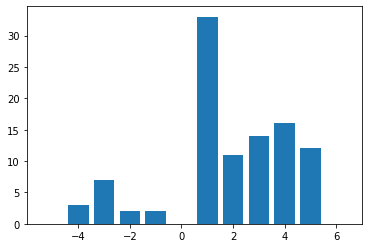

In [14]:
plt.bar(range(-5,7), histos[1][1:13])

In [15]:
histos

[[1, 0, 8, 7, 7, 13, 0, 28, 11, 11, 5, 10, 0],
 [2, 0, 3, 7, 2, 2, 0, 33, 11, 14, 16, 12, 0],
 [3, 0, 4, 0, 1, 1, 0, 31, 19, 10, 16, 17, 1],
 [4, 0, 0, 0, 0, 0, 0, 23, 14, 22, 17, 20, 4],
 [5, 0, 0, 0, 0, 0, 0, 9, 10, 17, 23, 32, 9],
 [6, 0, 2, 1, 0, 0, 0, 2, 6, 6, 21, 35, 27],
 [7, 43, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 57],
 [8, 8, 12, 6, 5, 5, 2, 11, 14, 11, 7, 9, 10],
 [9, 8, 5, 5, 4, 2, 0, 22, 12, 11, 10, 12, 9],
 [10, 1, 7, 2, 1, 0, 0, 16, 21, 13, 12, 12, 15],
 [11, 1, 4, 2, 0, 1, 0, 15, 19, 16, 11, 13, 18],
 [12, 0, 1, 1, 0, 0, 0, 11, 14, 21, 12, 12, 28],
 [13, 7, 1, 0, 0, 0, 0, 4, 6, 7, 10, 29, 36],
 [14, 48, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 52],
 [15, 0, 0, 1, 2, 1, 0, 84, 10, 2, 0, 0, 0],
 [16, 0, 0, 0, 0, 0, 0, 36, 25, 20, 9, 6, 4],
 [17, 0, 0, 0, 0, 0, 0, 27, 20, 18, 11, 11, 13],
 [18, 0, 0, 0, 0, 0, 0, 17, 19, 15, 17, 18, 14],
 [19, 0, 1, 0, 0, 0, 0, 7, 13, 17, 19, 15, 28],
 [20, 6, 4, 0, 0, 0, 0, 4, 4, 9, 13, 21, 39],
 [21, 47, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 53],
 [22, 0, 4, 2, 6,

In [16]:
# Convertimos a arreglo numpy
nphistos = np.array(histos)
nphistos

array([[  1,   0,   8, ...,   5,  10,   0],
       [  2,   0,   3, ...,  16,  12,   0],
       [  3,   0,   4, ...,  16,  17,   1],
       ...,
       [537,  17,  10, ...,   5,   7,   5],
       [538,  11,  14, ...,   6,   7,   8],
       [539,   7,   9, ...,   4,  10,  11]])

# Caracteristics

In [17]:
# Calculamos los vectores de caracteristicas y los guardamos
# en el arreglo mvc. En la columna 0 va el numero de corrida
mvc = np.zeros((539,4))
# Calculamos la media, varianza y skewness
for i in range(539):
    h = nphistos[i][1:]
    ldatos = []
    mvc[i,0] = nphistos[i,0]
    for j in range(12):
        if h[j] != 0:
            for l in range(int(h[j])):
                ldatos.append(j-5)
    mvc[i,1] = np.average(ldatos)
    mvc[i,2] = np.std(ldatos)
    if mvc[i,2] != 0:
        mvc[i,3] = skew(ldatos)
    else:
        mvc[i,3] = np.nan
    print(mvc[i,:])

[ 1.          0.73        2.60712485 -0.17745533]
[ 2.          1.82        2.3425627  -0.75852418]
[ 3.          2.35        2.07545176 -0.87424414]
[4.         3.09       1.54334053 0.06152146]
[ 5.          3.86        1.42842571 -0.51475629]
[ 6.          4.42        1.87179059 -2.55087069]
[ 7.          1.27        5.44583327 -0.28278501]
[ 8.          0.84        3.55449012 -0.23717802]
[ 9.          1.48        3.28170687 -0.59301733]
[10.          2.54        2.76195583 -0.96991681]
[11.          2.9         2.55147016 -1.03708167]
[12.          3.71        2.01144227 -0.85347721]
[13.          3.99        2.95125397 -2.1143137 ]
[14.          0.72        5.49559824 -0.08006408]
[15.          1.02        0.74806417 -2.46904622]
[16.          2.36        1.40370937  0.92748863]
[17.          2.98        1.73193533  0.44657044]
[18.          3.42        1.68629772  0.03815851]
[19.          3.99        1.79719225 -0.98765679]
[20.          3.84        3.12640368 -1.88765078]
[21.

[240.           1.46         3.40711021  -0.63403873]
[241.           1.63         3.39898514  -0.91307583]
[242.           2.14         3.69599784  -0.95704599]
[243.           1.98         3.83400574  -0.63731489]
[244.           1.7          4.5         -0.40480658]
[2.45000000e+02 1.40000000e-01 5.20772503e+00 1.19139152e-01]
[246.           1.4          2.18174242  -0.4021148 ]
[247.           2.06         2.72330681  -0.99297105]
[248.           2.57         2.60865866  -1.22192938]
[249.           2.95         2.58215027  -1.46079454]
[250.           2.69         3.14227625  -1.05321127]
[251.           4.11         1.65466009  -3.12890035]
[252.           3.2          3.22800248  -1.63040639]
[253.           1.66         2.77207504  -0.3784954 ]
[254.           1.79         2.86110119  -0.91558462]
[255.           2.21         3.28723288  -1.09643363]
[256.           2.18         3.66163898  -0.89921628]
[257.           2.49         3.70268821  -0.84945314]
[258.           2.92

[ 5.18000000e+02  3.80000000e-01  3.48648820e+00 -5.00835812e-03]
[5.19000000e+02 1.40000000e-01 3.74438246e+00 1.46457505e-01]
[ 5.20000000e+02  2.60000000e-01  3.43400641e+00 -4.18728382e-02]
[5.21000000e+02 1.60000000e-01 3.64614865e+00 4.48615912e-02]
[ 5.22000000e+02  6.30000000e-01  3.45153589e+00 -1.57491329e-01]
[ 5.23000000e+02  6.30000000e-01  3.82009162e+00 -5.84965509e-02]
[ 5.24000000e+02  8.10000000e-01  3.51481152e+00 -1.03207042e-01]
[ 5.25000000e+02  9.90000000e-01  3.56228859e+00 -2.37347231e-01]
[ 5.26000000e+02  8.40000000e-01  3.59644269e+00 -2.14270364e-01]
[ 5.27000000e+02 -3.00000000e-02  3.65364202e+00  1.56879262e-01]
[ 5.28000000e+02  9.30000000e-01  3.38010355e+00 -1.21455887e-01]
[ 5.29000000e+02  4.00000000e-01  3.25269119e+00 -7.49706376e-02]
[ 5.30000000e+02  4.60000000e-01  3.39829369e+00 -5.13220907e-02]
[ 5.31000000e+02  1.13000000e+00  3.50044283e+00 -2.86093284e-01]
[5.32000000e+02 1.00000000e-02 3.67285992e+00 4.28950872e-02]
[5.33000000e+02 1.6000

In [18]:
# Sacamos de la jugada los histogramas que tienen
# desviacion estandar 0, los guardamos en el arreglo mvc1,
# en la columna 0 se guarda el numero de corrida
sdno0 = 0
for i in range(539):
    if mvc[i,2] != 0:
        sdno0 = sdno0 + 1
mvc1 = np.zeros((sdno0,4))
aa = 0
for i in range(539):
    if mvc[i,2] != 0:
        mvc1[aa,0] = mvc[i,0]
        mvc1[aa,1:] = mvc[i,1:]
        print(mvc1[aa,:])
        aa = aa + 1

[ 1.          0.73        2.60712485 -0.17745533]
[ 2.          1.82        2.3425627  -0.75852418]
[ 3.          2.35        2.07545176 -0.87424414]
[4.         3.09       1.54334053 0.06152146]
[ 5.          3.86        1.42842571 -0.51475629]
[ 6.          4.42        1.87179059 -2.55087069]
[ 7.          1.27        5.44583327 -0.28278501]
[ 8.          0.84        3.55449012 -0.23717802]
[ 9.          1.48        3.28170687 -0.59301733]
[10.          2.54        2.76195583 -0.96991681]
[11.          2.9         2.55147016 -1.03708167]
[12.          3.71        2.01144227 -0.85347721]
[13.          3.99        2.95125397 -2.1143137 ]
[14.          0.72        5.49559824 -0.08006408]
[15.          1.02        0.74806417 -2.46904622]
[16.          2.36        1.40370937  0.92748863]
[17.          2.98        1.73193533  0.44657044]
[18.          3.42        1.68629772  0.03815851]
[19.          3.99        1.79719225 -0.98765679]
[20.          3.84        3.12640368 -1.88765078]
[21.

[228.           2.83         2.82862157  -1.4812832 ]
[229.           3.06         3.00273209  -1.32094954]
[230.           2.92         3.69778312  -1.11027681]
[231.           1.41         5.1285378   -0.34672813]
[232.           1.27         2.85256025  -0.44894571]
[233.           1.74         3.06796349  -0.6746137 ]
[234.           1.85         3.29962119  -0.98838191]
[235.           2.54         3.11583055  -1.332411  ]
[236.           3.22         2.94136023  -1.50823248]
[237.           2.29         4.08728516  -0.74497947]
[2.38000000e+02 1.60000000e-01 5.25113321e+00 1.06495357e-01]
[239.           0.76         3.24690622  -0.31596815]
[240.           1.46         3.40711021  -0.63403873]
[241.           1.63         3.39898514  -0.91307583]
[242.           2.14         3.69599784  -0.95704599]
[243.           1.98         3.83400574  -0.63731489]
[244.           1.7          4.5         -0.40480658]
[2.45000000e+02 1.40000000e-01 5.20772503e+00 1.19139152e-01]
[246.       

Text(0.5, 0, 'sk')

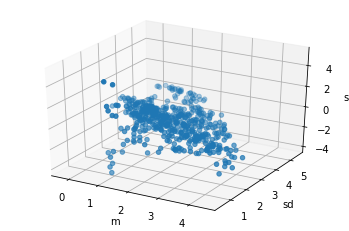

In [19]:
# magic function for interactive plot
#%matplotlib notebook
ax = plt.axes(projection='3d')
ax.scatter3D(mvc1[:,1], mvc1[:,2], mvc1[:,3])
ax.set_xlabel('m')
ax.set_ylabel('sd')
ax.set_zlabel('sk')

Text(0.5, 0, 'sk')

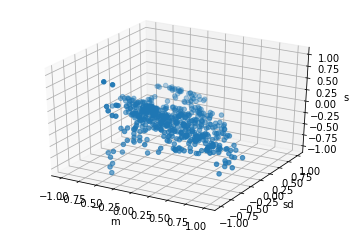

In [20]:
# Escalamos los datos al rango [-1,1] y los guardamos
# en el arreglo mvc2
mvc2 = np.zeros((sdno0,4))
maxim = np.amax(mvc1[:,1:], axis=0)
minim = np.amin(mvc1[:,1:], axis=0)
for i in range(sdno0):
    mvc2[i,0] = mvc1[i,0]
    mvc2[i,1:] = (np.array(3*[2]) * (mvc1[i,1:] - minim)) / (maxim-minim)  - np.array(3*[1])
ax = plt.axes(projection='3d')
ax.scatter3D(mvc2[:,1], mvc2[:,2], mvc2[:,3])
ax.set_xlabel('m')
ax.set_ylabel('sd')
ax.set_zlabel('sk')

# Dendograms

In [21]:
# Guardamos el indice de cada los histogramas
indice =mvc2[:, 0]

In [22]:
mvc4 = np.delete(mvc2, 0, axis=1)
mvc4

array([[-0.58562368, -0.13164246, -0.16320707],
       [-0.12473573, -0.23513458, -0.29224174],
       [ 0.09936575, -0.33962373, -0.31793901],
       ...,
       [-0.98731501,  0.24538458, -0.10104216],
       [-0.92389006,  0.23513178, -0.0765905 ],
       [-0.57716702,  0.23084333, -0.14035051]])

<IPython.core.display.Javascript object>


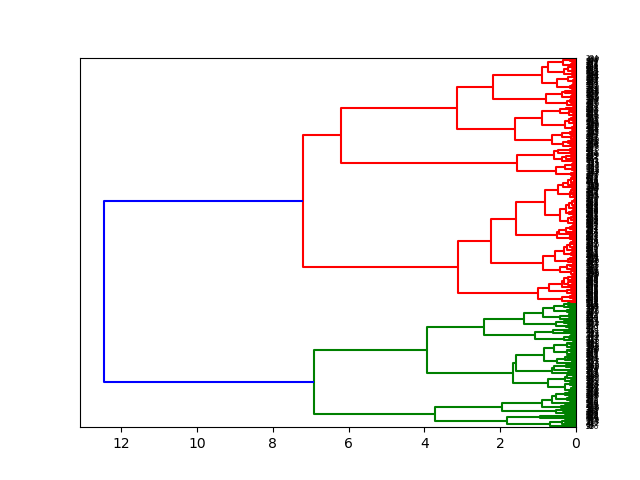

In [23]:
from matplotlib.pyplot import figure
figure(num=None, figsize=(20, 20), dpi=500)#, facecolor='w', edgecolor='k'
%matplotlib notebook
Clustering_jerarquico = linkage(mvc4, 'ward')
dendrogram = sch.dendrogram(Clustering_jerarquico, orientation="left", leaf_rotation=0)

plt.show()

In [116]:
plt.savefig('Dendograma1.png')

In [24]:
# Asigrnando Cluster 

numclusters = fcluster(Clustering_jerarquico, t=2, criterion='distance')
numclusters

array([ 8,  3,  3,  4,  4,  5,  9,  8,  7,  3,  3,  4,  5,  9,  2,  1,  4,
        4,  4,  5,  9,  2,  1,  4,  3,  5, 11,  9,  8,  3,  3,  3,  3,  9,
        9,  7,  7, 12, 10, 11, 10,  9,  8,  7, 12, 10, 10, 10,  9,  8,  7,
        3,  3,  5,  5,  9,  8,  8, 10,  3, 11,  5,  9,  1,  1,  4,  4,  4,
        5,  9,  2,  1,  3,  4,  5, 11,  9,  2,  3,  3,  3, 12, 11,  9,  8,
        7, 12, 10, 12, 10,  9,  8,  7,  7, 10, 10,  9,  9,  8,  3,  3,  3,
        3,  5,  9,  8,  7, 12, 10, 11, 11,  9,  1,  1,  4,  4,  4,  5,  9,
        1,  2,  3,  4,  5, 11,  9,  2,  3,  3, 12, 12, 10,  9,  7,  8,  8,
       10, 12, 11,  9,  7,  7,  8, 10, 12, 10,  9,  7,  7,  3,  3,  5,  5,
        9,  8,  8, 10, 12, 10, 11,  9,  1,  1,  3,  4,  4,  5,  9,  2,  3,
        3,  5,  5, 10,  9,  3,  3,  3,  3,  3, 10,  9,  7,  7,  3, 12, 11,
       10,  9,  8,  7, 12, 10, 10, 10,  9,  2,  3,  3,  3,  3,  5,  9,  8,
        7, 10, 12, 11, 11, 10,  1,  3,  3,  3,  4,  5,  9,  2,  4,  3,  5,
        5,  5,  9,  3,  3

In [25]:
import collections, numpy
collections.Counter(numclusters)

Counter({8: 96,
         3: 74,
         4: 20,
         5: 36,
         9: 41,
         7: 50,
         2: 32,
         1: 20,
         11: 24,
         12: 46,
         10: 60,
         6: 40})

In [28]:
# Vemos las corridas en cada cluster
nclusters = 13
print('Corridas en cada cluster')
corrxclus = [[]for i in range(nclusters)]
for i in range(len(numclusters)):
    corrxclus[numclusters[i]].append(int(mvc2[i][0]))
# Histogramas con desviacion estandar 0
extra = []
for i in range(539):
    if mvc[i,2] == 0:
        extra.append(int(mvc[i,0]))
corrxclus.append(extra)
# imprimimos
for i in range(nclusters + 1):
    print("Corridas en cluster " + str(i))
    print(corrxclus[i])

Corridas en cada cluster
Corridas en cluster 0
[]
Corridas en cluster 1
[16, 23, 64, 65, 72, 113, 114, 120, 162, 163, 211, 317, 368, 408, 409, 410, 411, 412, 460, 461]
Corridas en cluster 2
[15, 22, 71, 78, 121, 127, 169, 197, 218, 246, 260, 261, 267, 309, 310, 358, 359, 361, 366, 367, 369, 370, 407, 413, 417, 418, 419, 420, 457, 458, 459, 462]
Corridas en cluster 3
[2, 3, 10, 11, 25, 30, 31, 32, 33, 52, 53, 60, 73, 79, 80, 81, 100, 101, 102, 103, 122, 128, 129, 150, 151, 164, 170, 171, 176, 177, 178, 179, 180, 185, 198, 199, 200, 201, 212, 213, 214, 220, 225, 226, 227, 228, 229, 247, 248, 249, 262, 263, 268, 269, 274, 275, 276, 277, 282, 296, 297, 312, 313, 314, 318, 319, 325, 326, 346, 347, 349, 350, 376, 396]
Corridas en cluster 4
[4, 5, 12, 17, 18, 19, 24, 66, 67, 68, 74, 115, 116, 117, 123, 165, 166, 215, 219, 300]
Corridas en cluster 5
[6, 13, 20, 26, 54, 55, 62, 69, 75, 104, 118, 124, 152, 153, 167, 172, 173, 202, 216, 221, 222, 223, 236, 251, 264, 265, 270, 271, 272, 278, 279, 

<IPython.core.display.Javascript object>


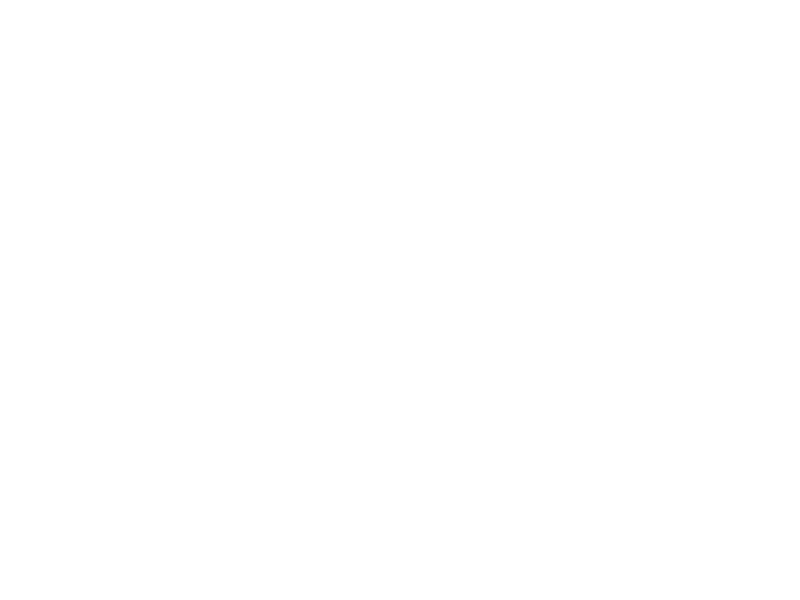

<IPython.core.display.Javascript object>


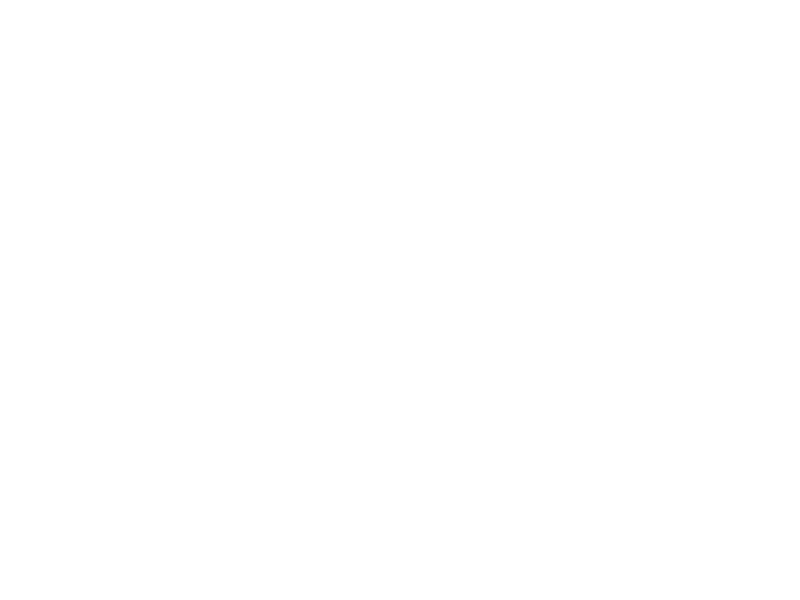

<IPython.core.display.Javascript object>


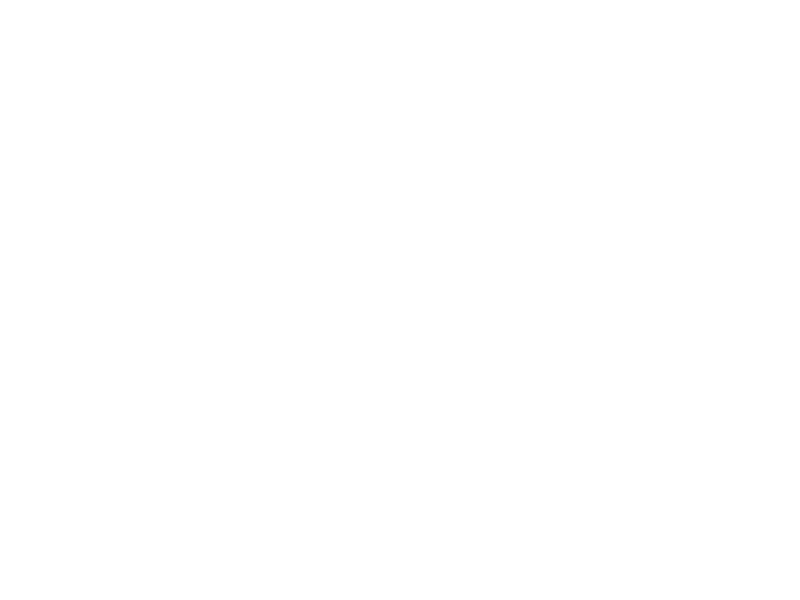

<IPython.core.display.Javascript object>


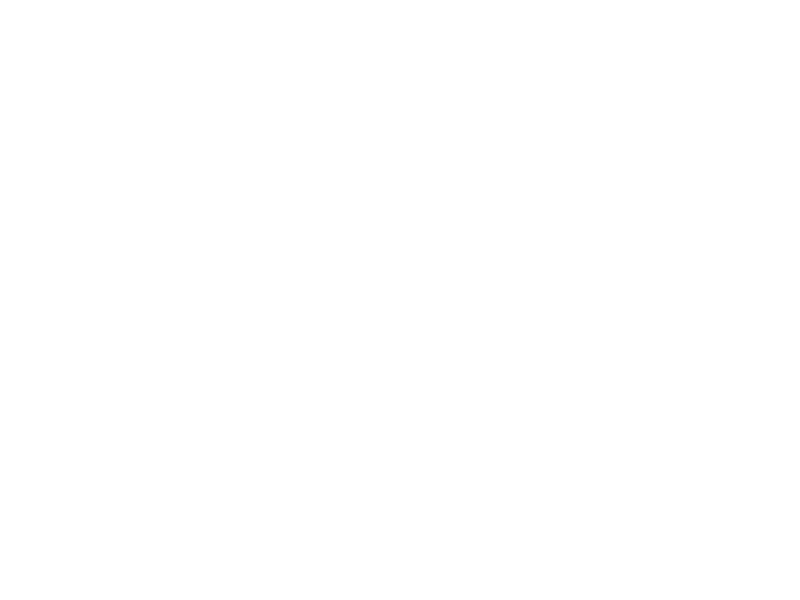

<IPython.core.display.Javascript object>


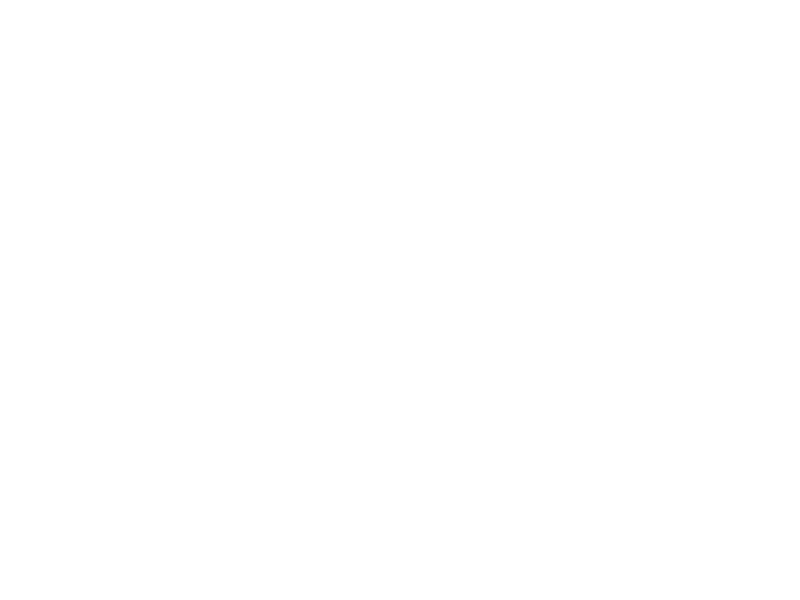

<IPython.core.display.Javascript object>


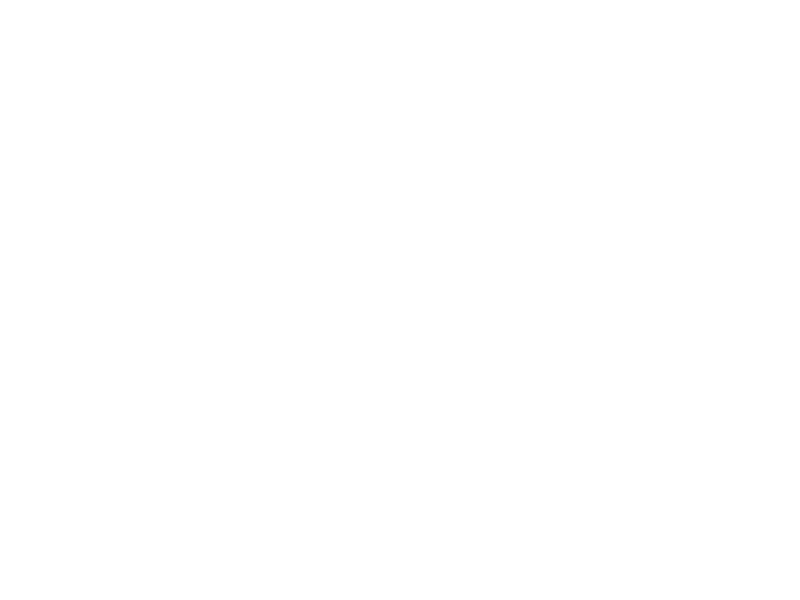

<IPython.core.display.Javascript object>


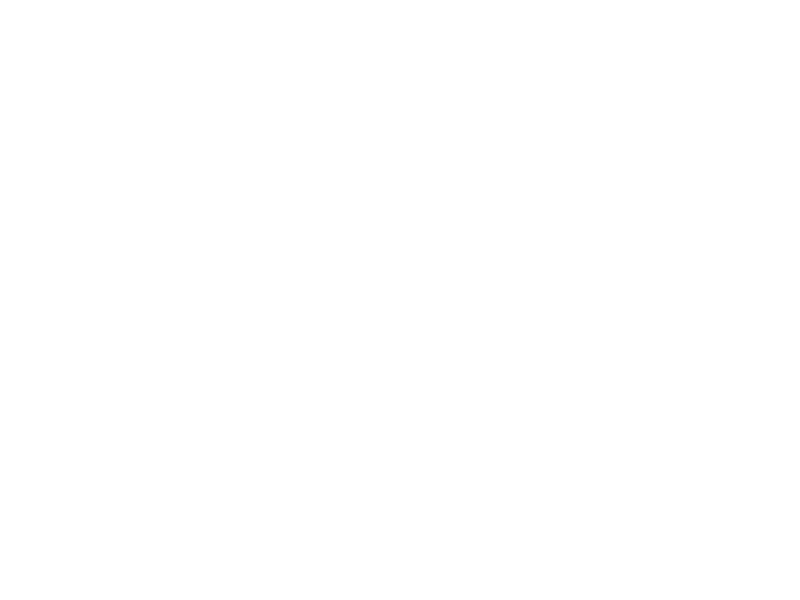

<IPython.core.display.Javascript object>


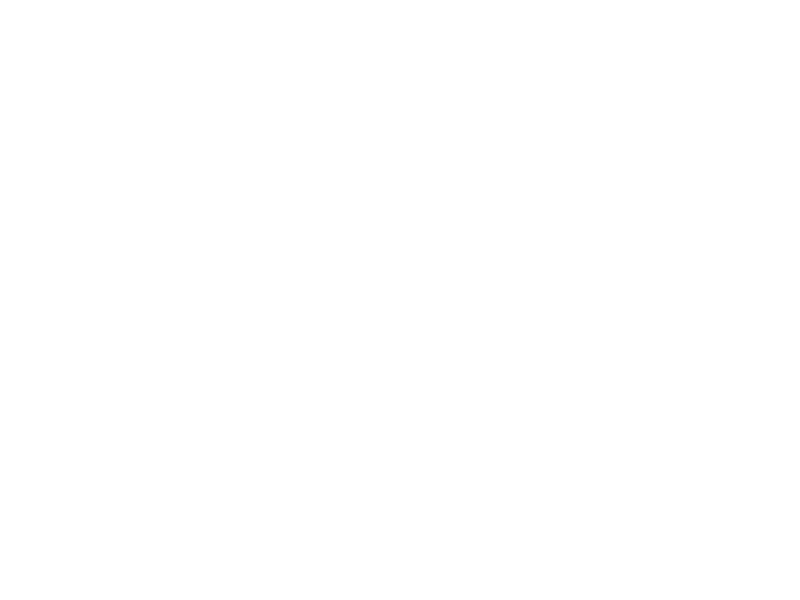

<IPython.core.display.Javascript object>


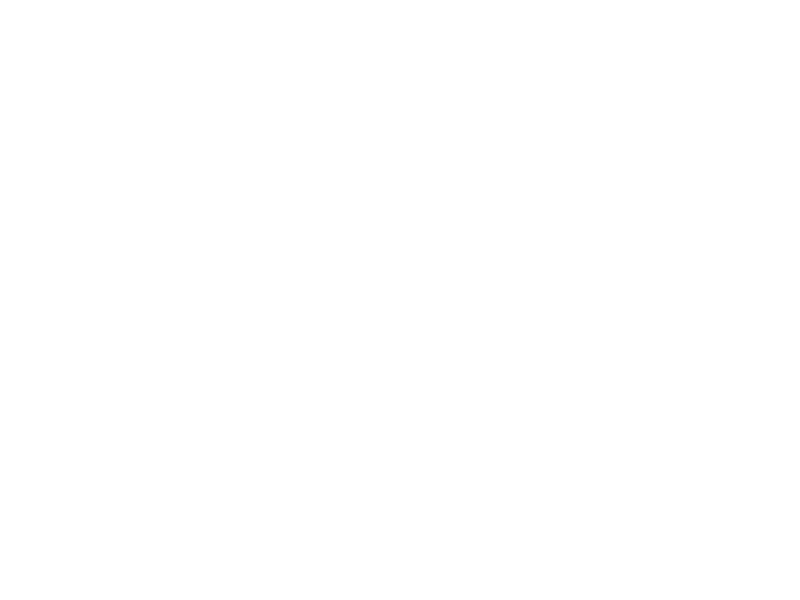

<IPython.core.display.Javascript object>


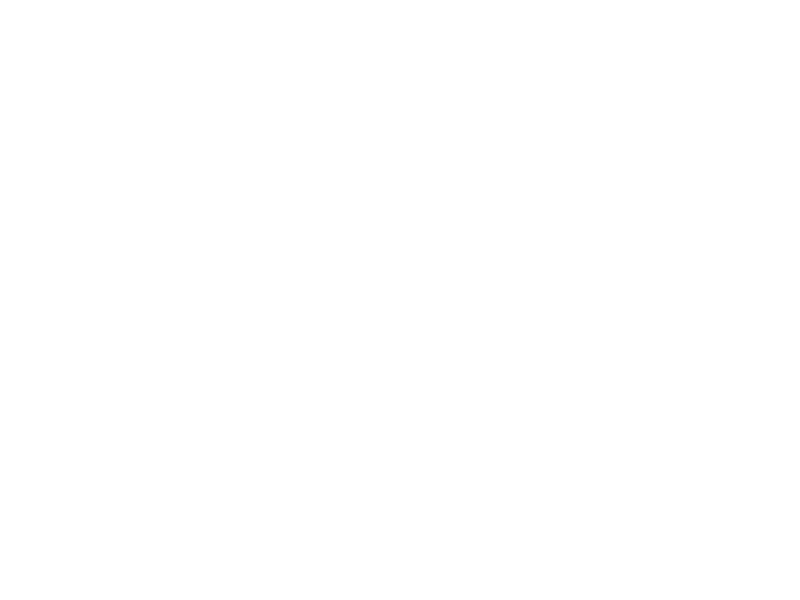

<IPython.core.display.Javascript object>


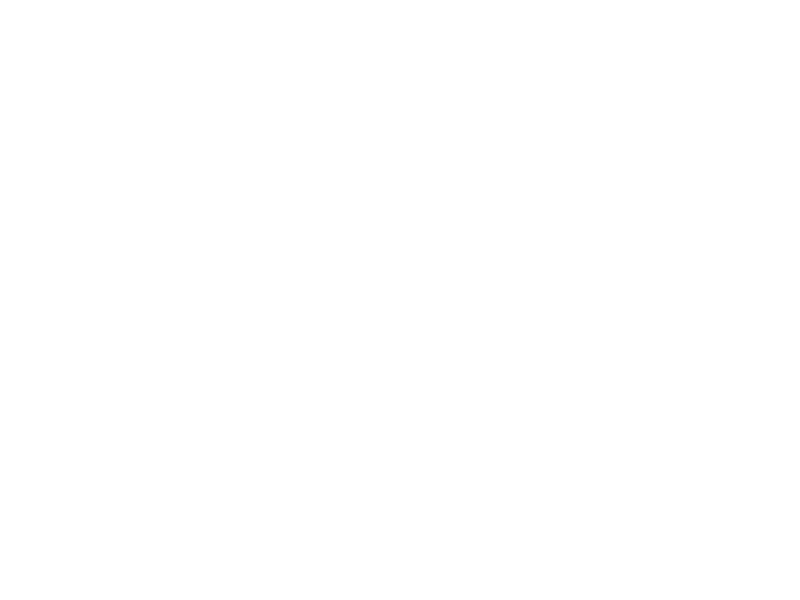

<IPython.core.display.Javascript object>


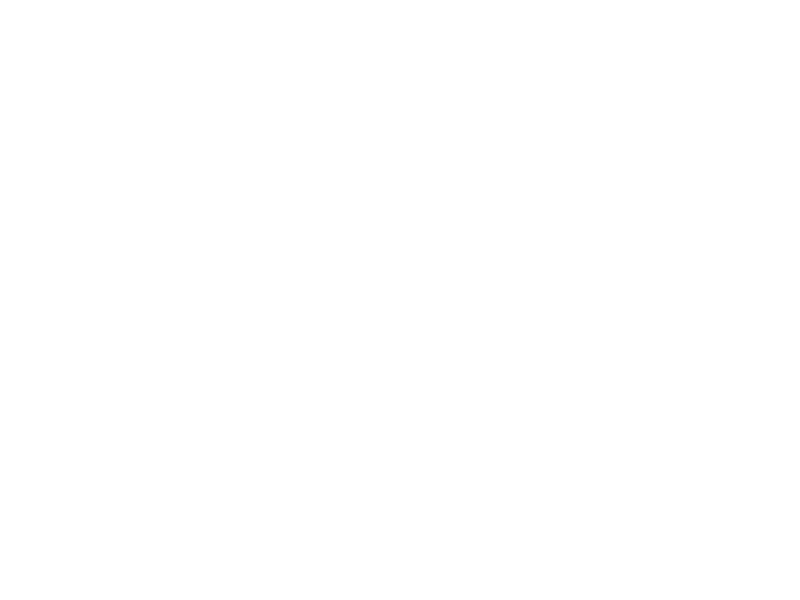

<IPython.core.display.Javascript object>


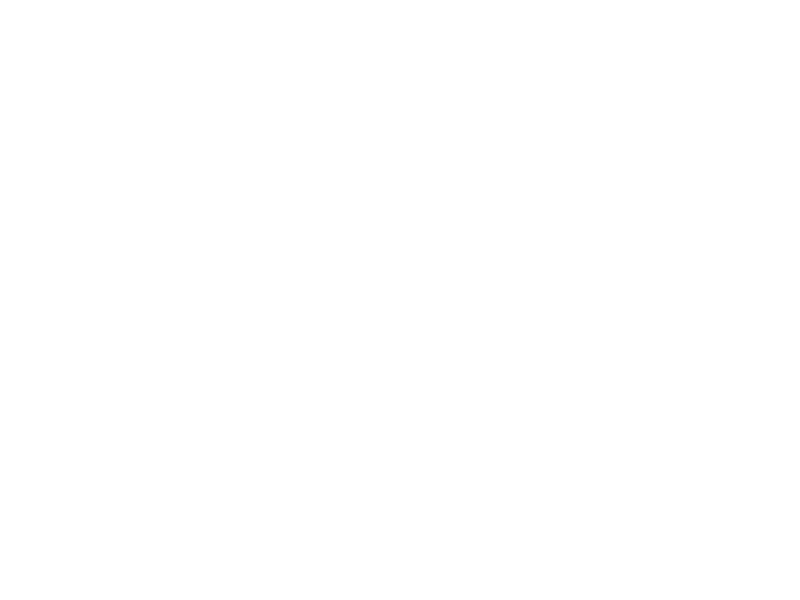

<IPython.core.display.Javascript object>


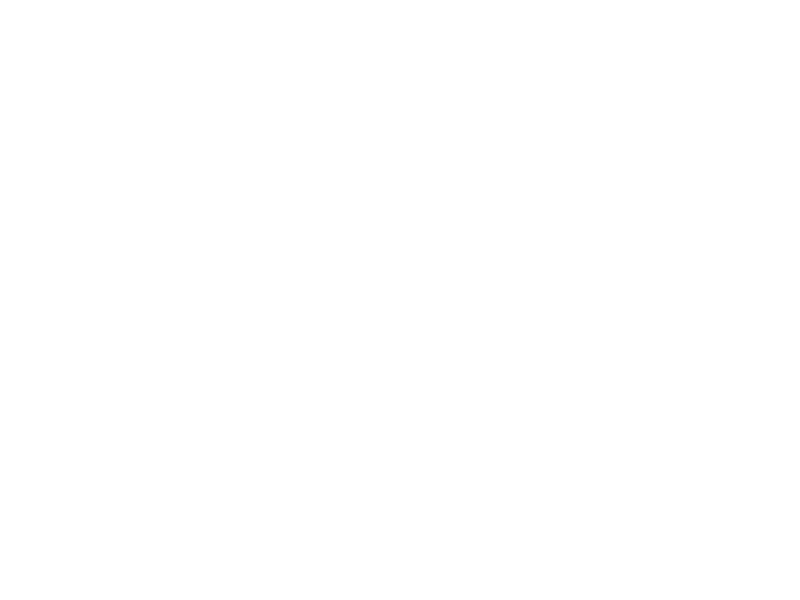

<IPython.core.display.Javascript object>


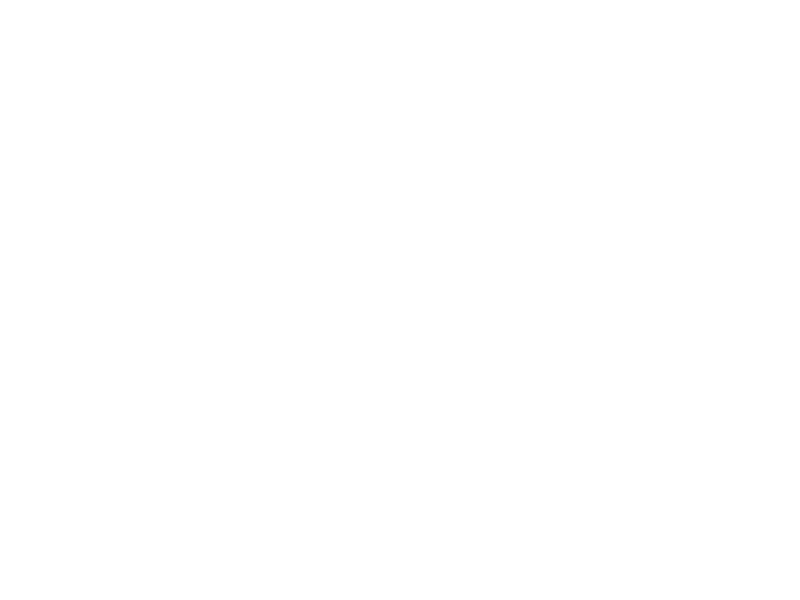

<IPython.core.display.Javascript object>


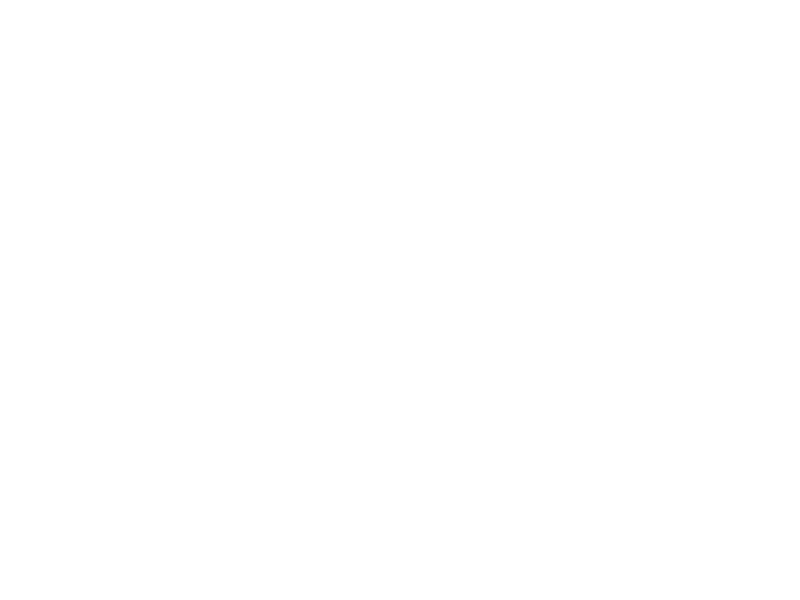

<IPython.core.display.Javascript object>


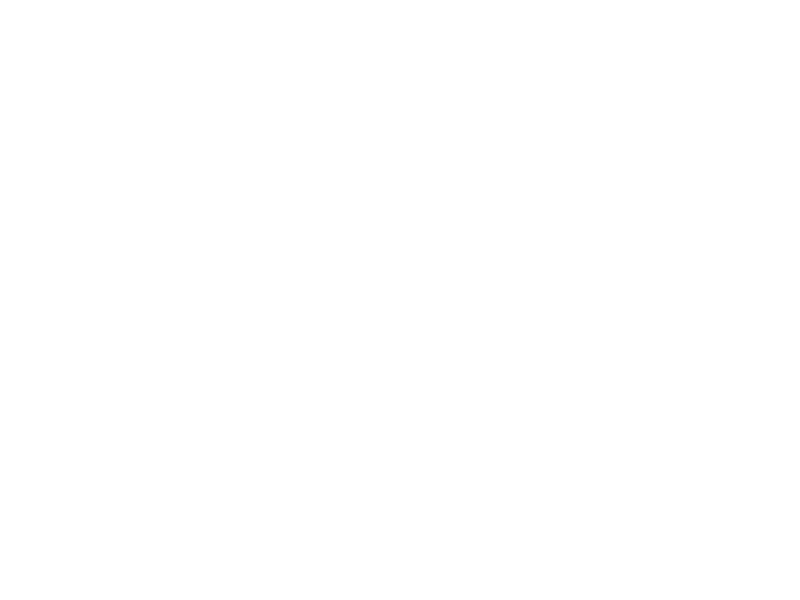

<IPython.core.display.Javascript object>


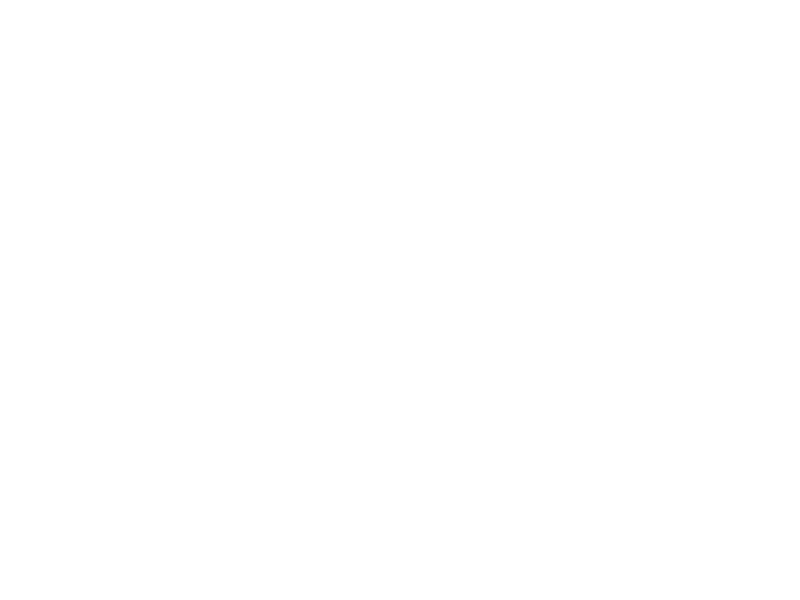

<IPython.core.display.Javascript object>


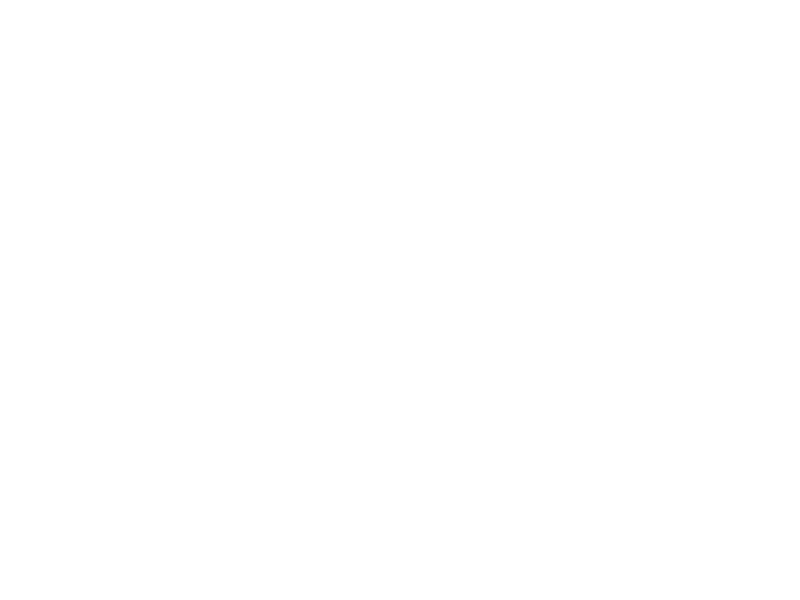

<IPython.core.display.Javascript object>


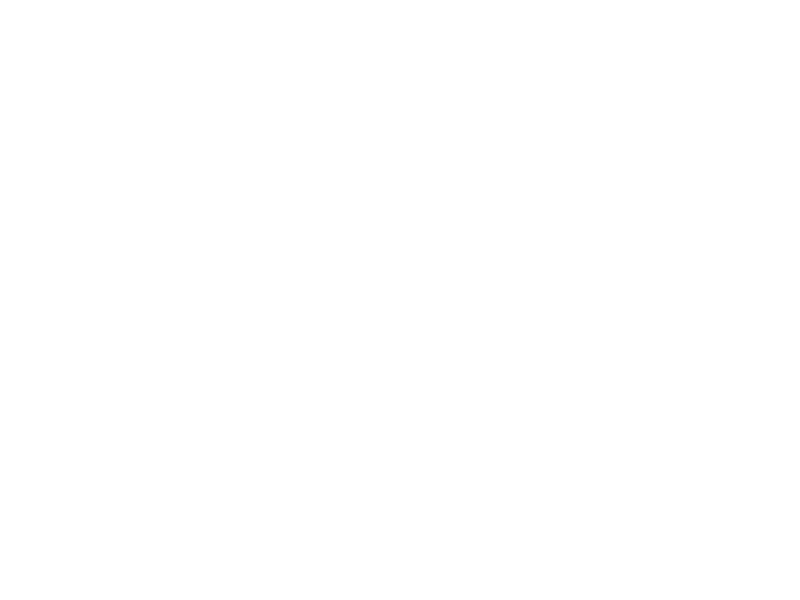

<IPython.core.display.Javascript object>


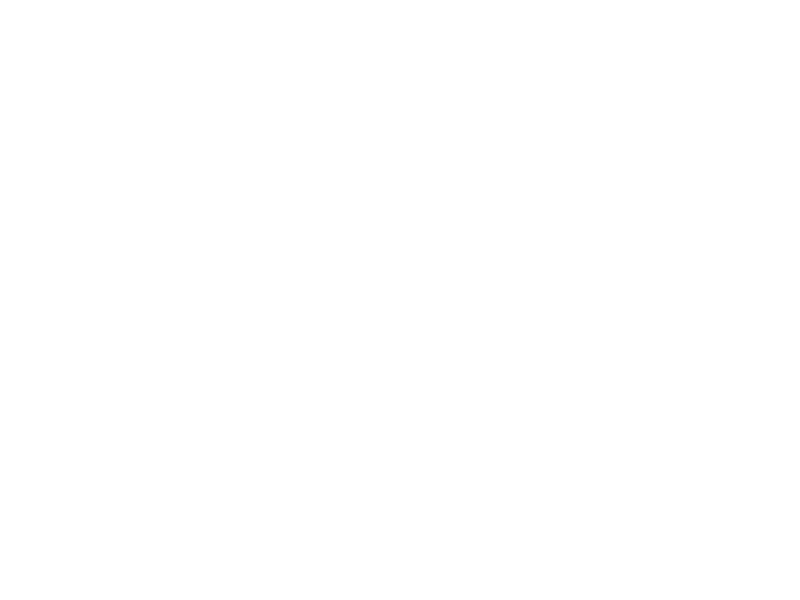

<IPython.core.display.Javascript object>


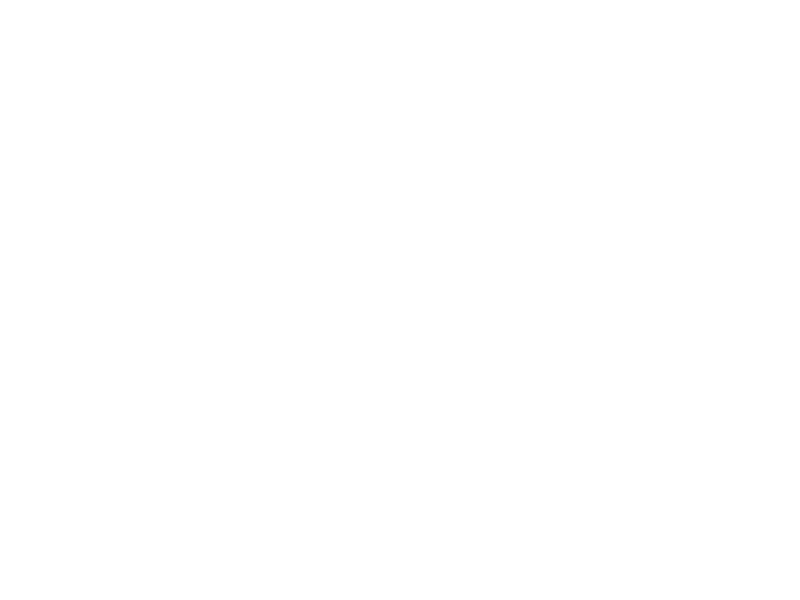

<IPython.core.display.Javascript object>


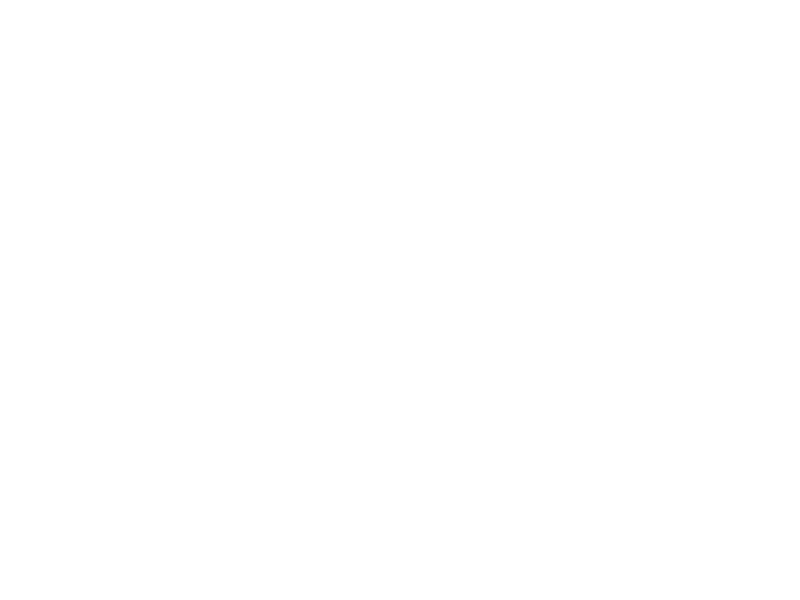

<IPython.core.display.Javascript object>


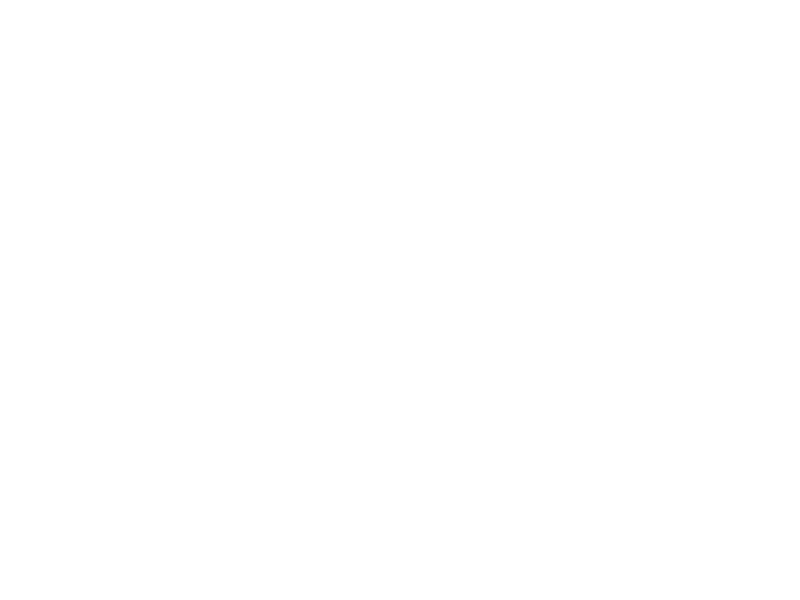

<IPython.core.display.Javascript object>


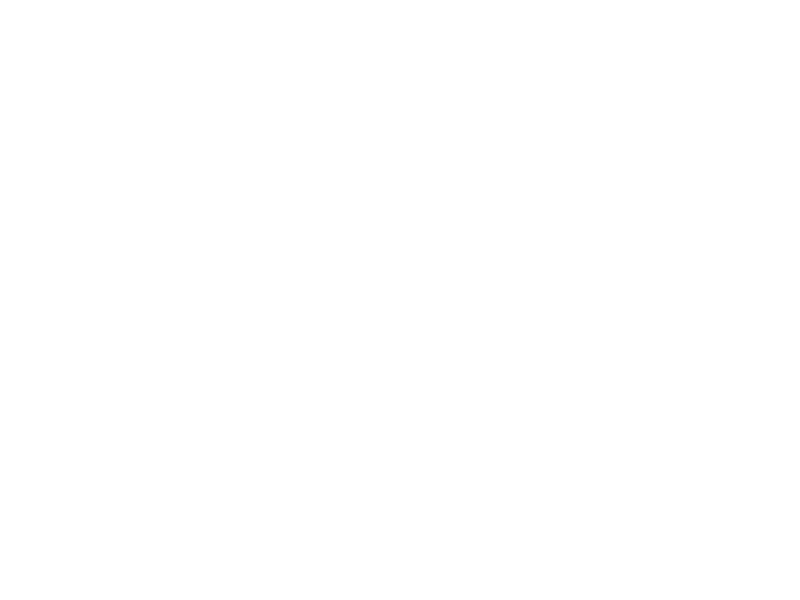

<IPython.core.display.Javascript object>


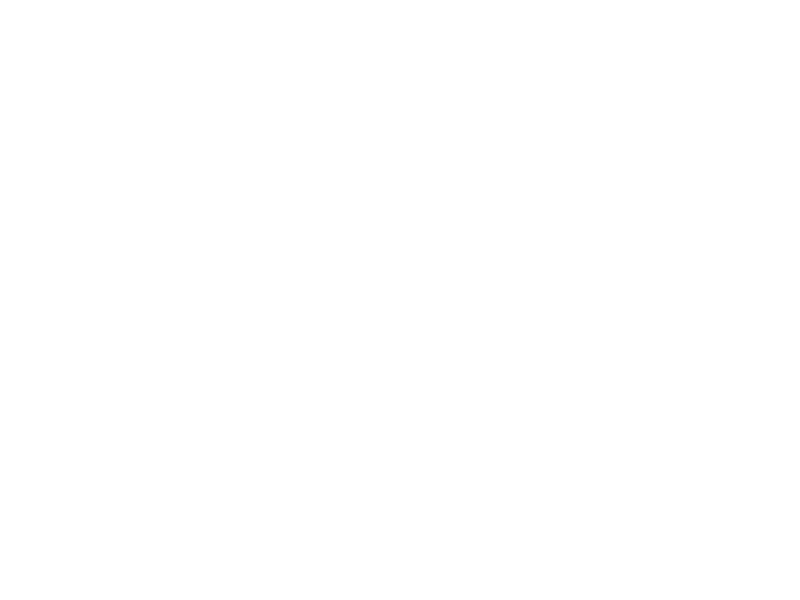

<IPython.core.display.Javascript object>


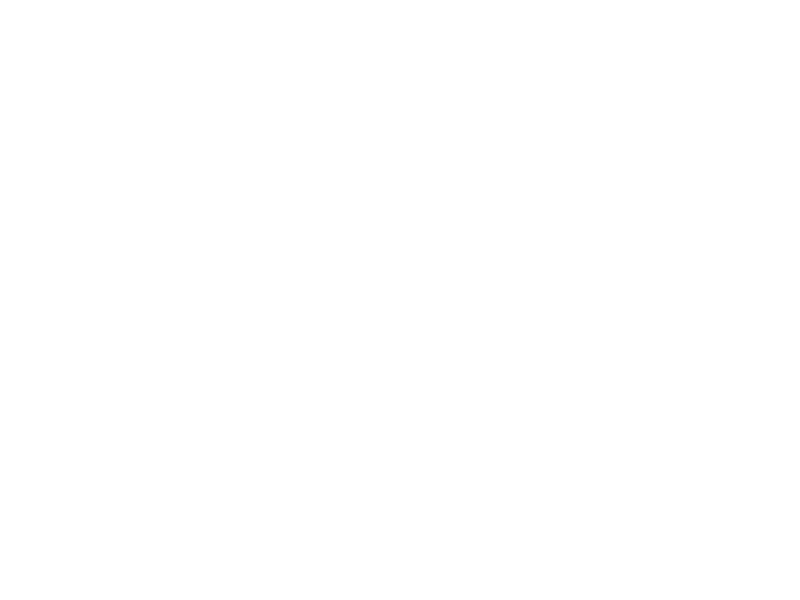

<IPython.core.display.Javascript object>


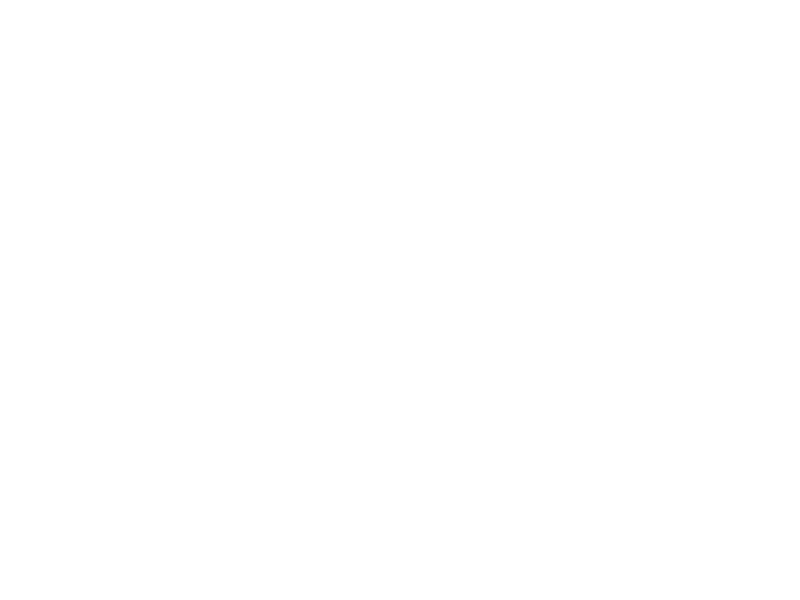

<IPython.core.display.Javascript object>


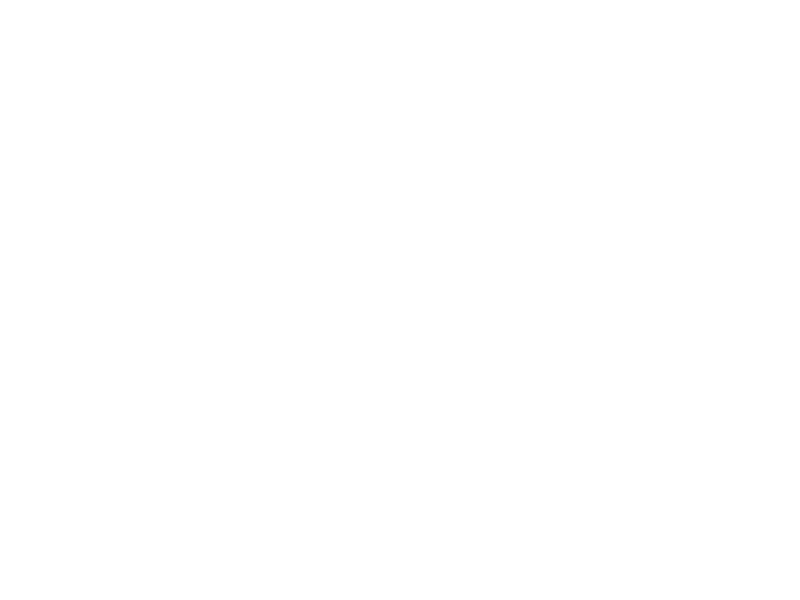

<IPython.core.display.Javascript object>


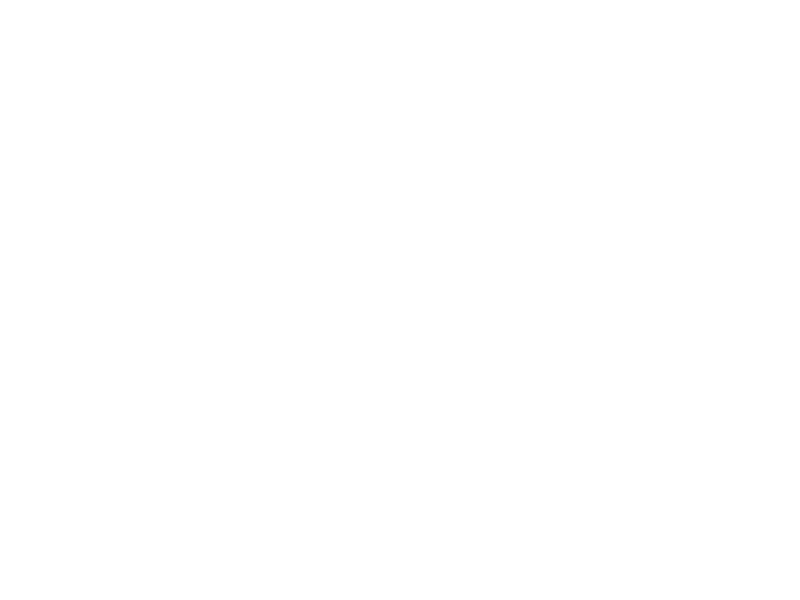

<IPython.core.display.Javascript object>


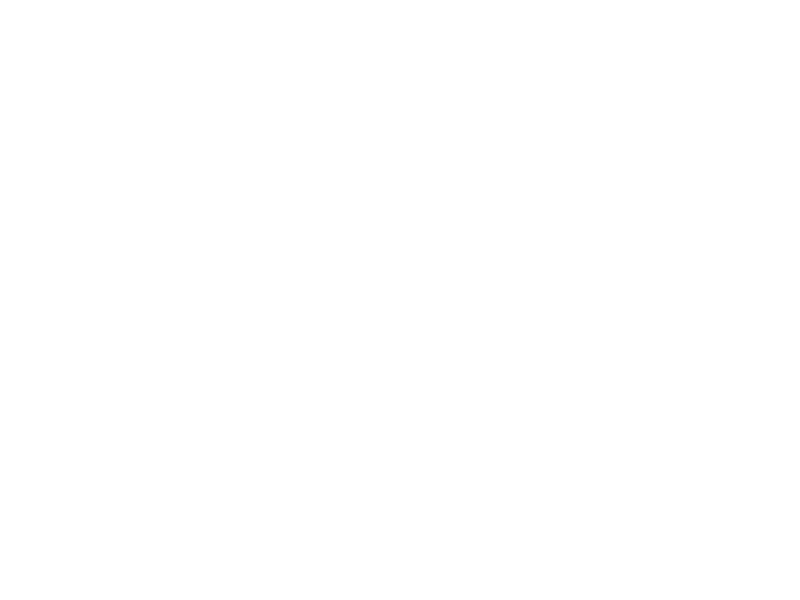

<IPython.core.display.Javascript object>


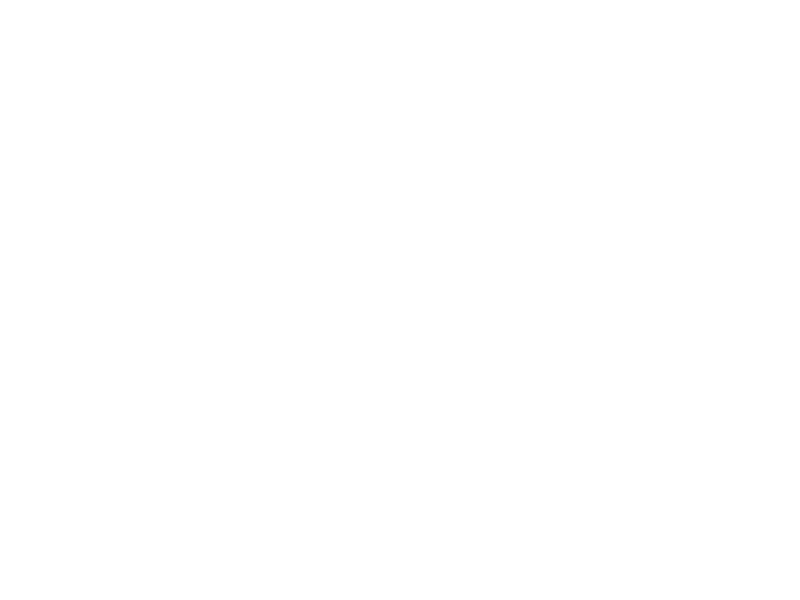

<IPython.core.display.Javascript object>


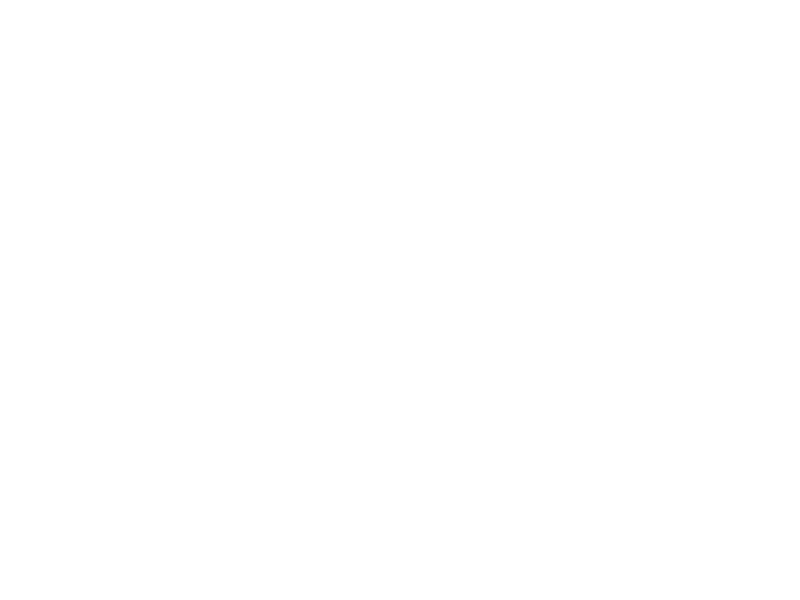

<IPython.core.display.Javascript object>


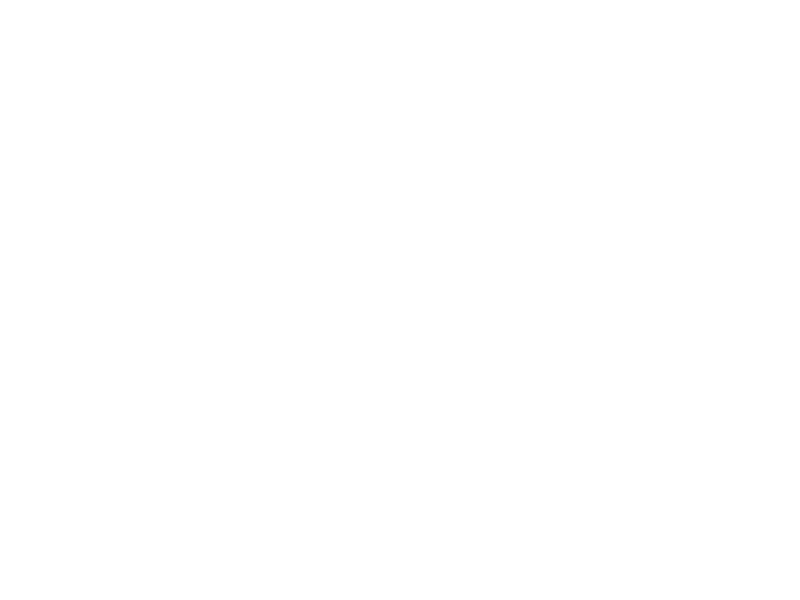

<IPython.core.display.Javascript object>


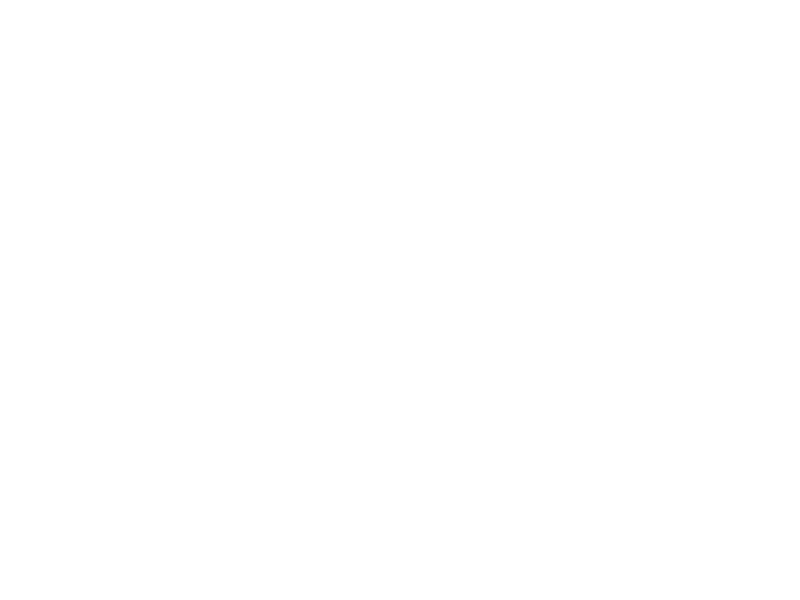

<IPython.core.display.Javascript object>


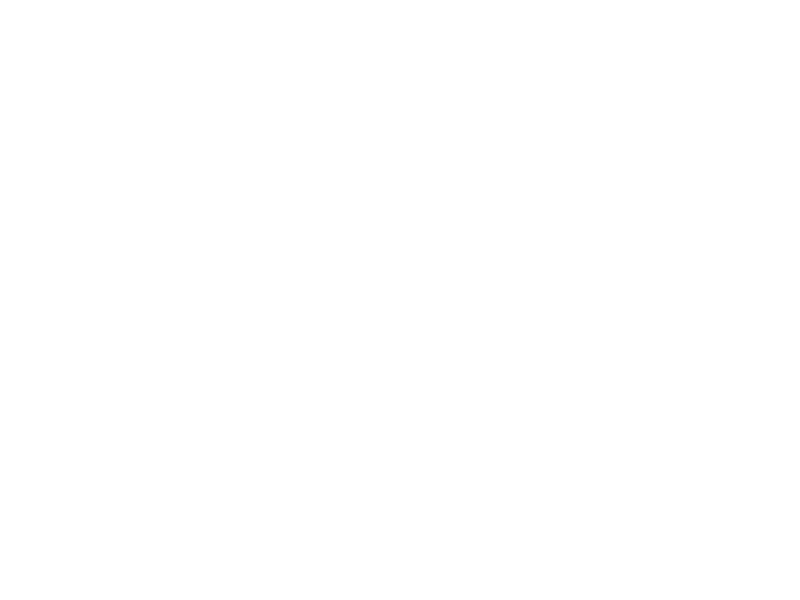

<IPython.core.display.Javascript object>


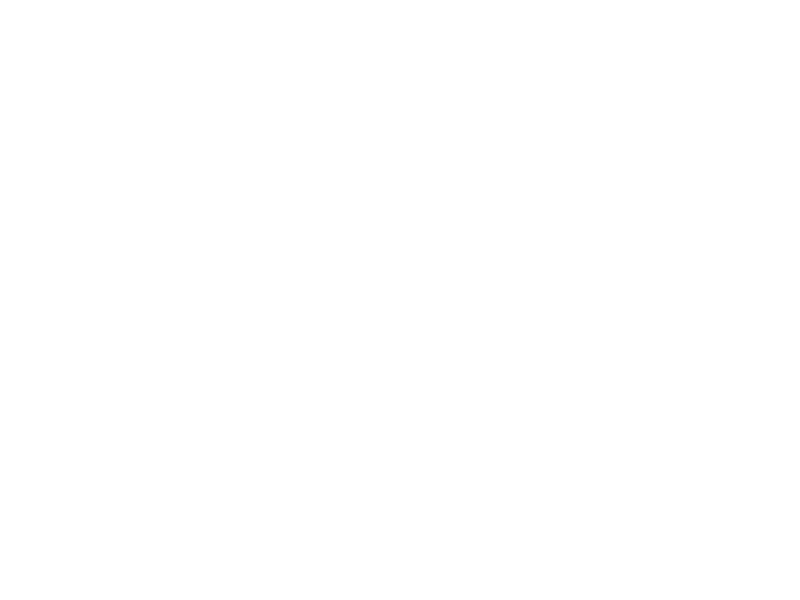

<IPython.core.display.Javascript object>


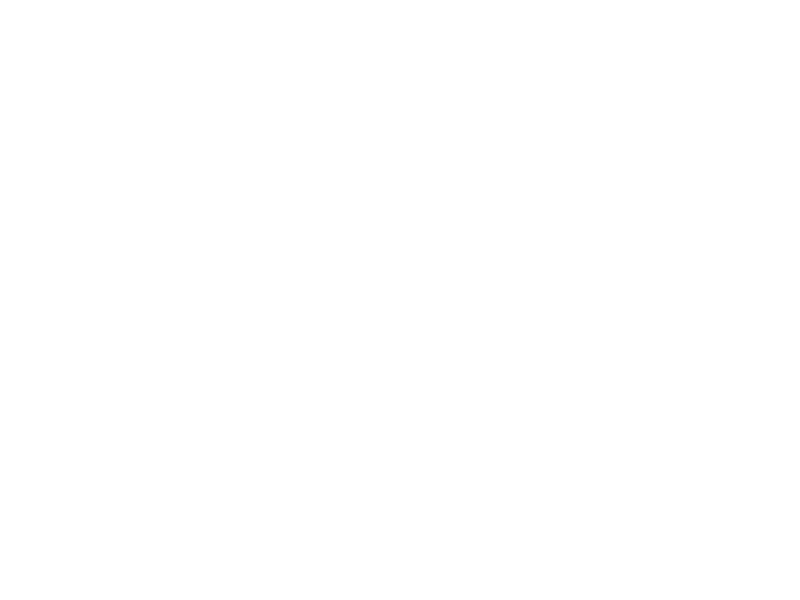

<IPython.core.display.Javascript object>


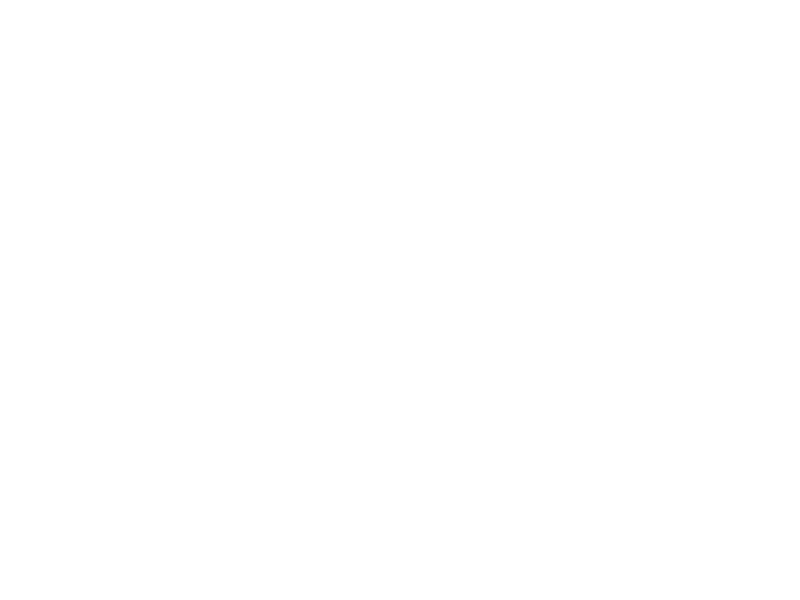

<IPython.core.display.Javascript object>


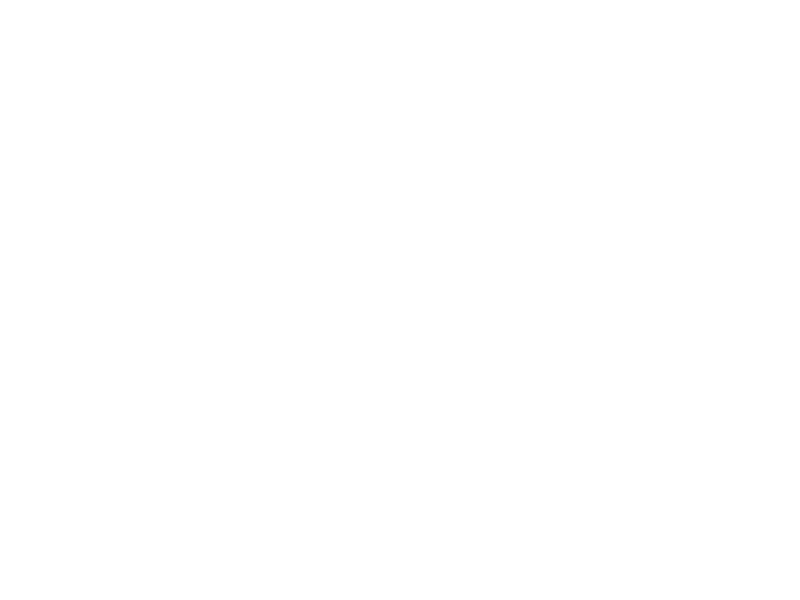

<IPython.core.display.Javascript object>


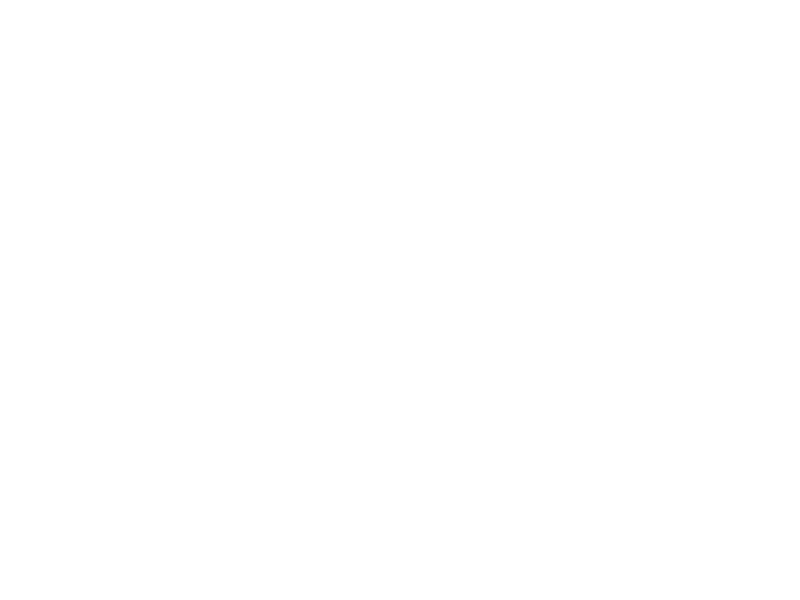

<IPython.core.display.Javascript object>


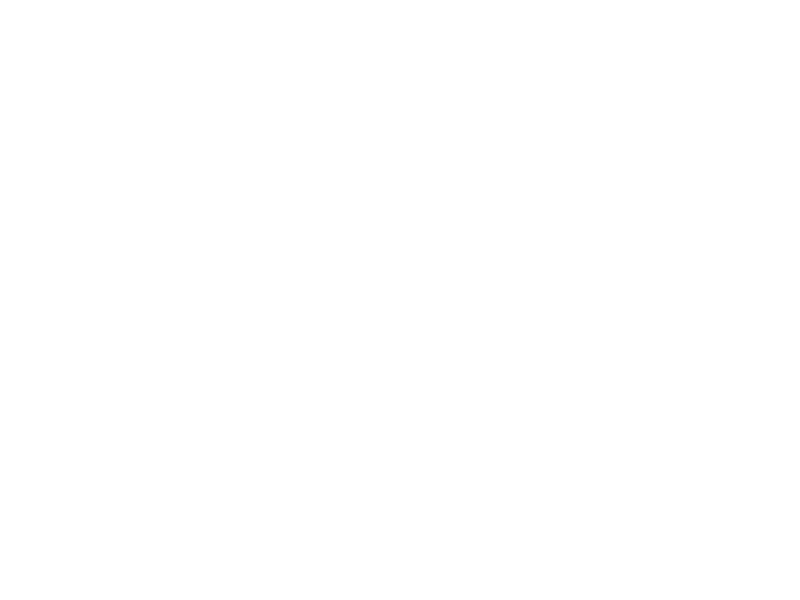

<IPython.core.display.Javascript object>


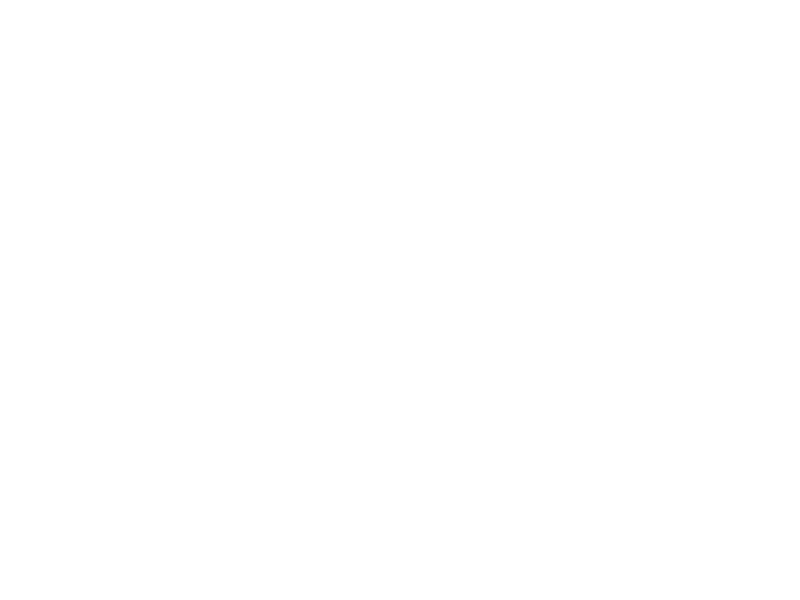

<IPython.core.display.Javascript object>


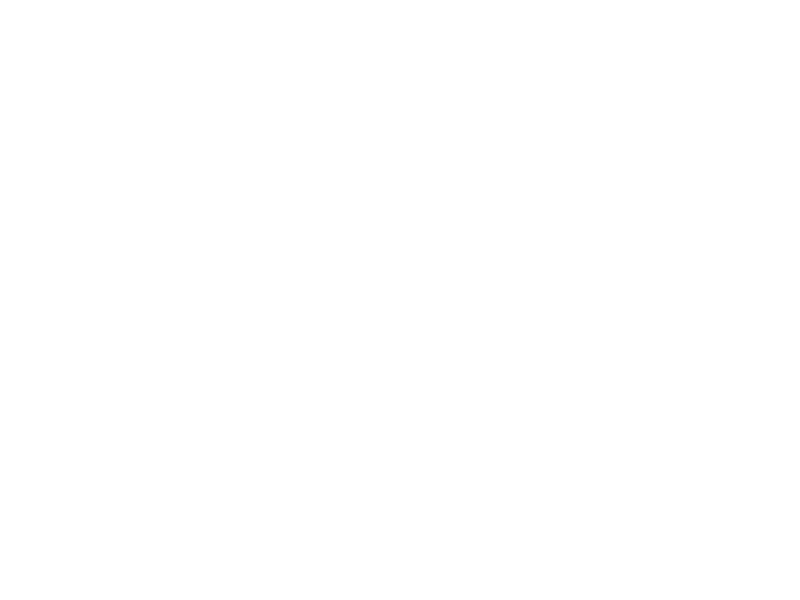

<IPython.core.display.Javascript object>


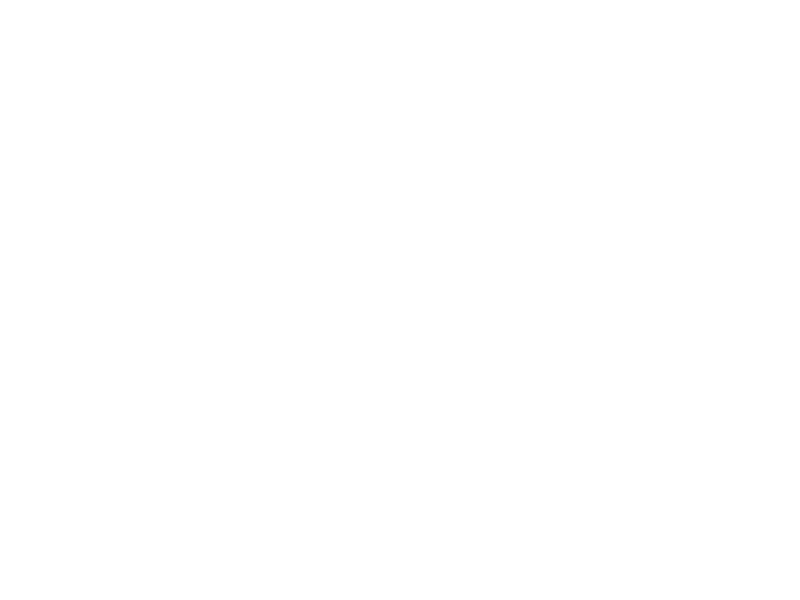

<IPython.core.display.Javascript object>


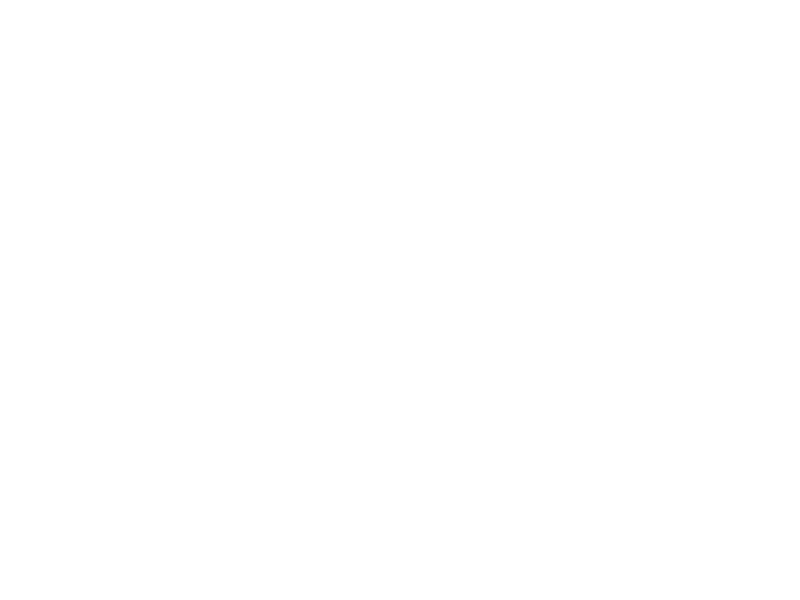

<IPython.core.display.Javascript object>


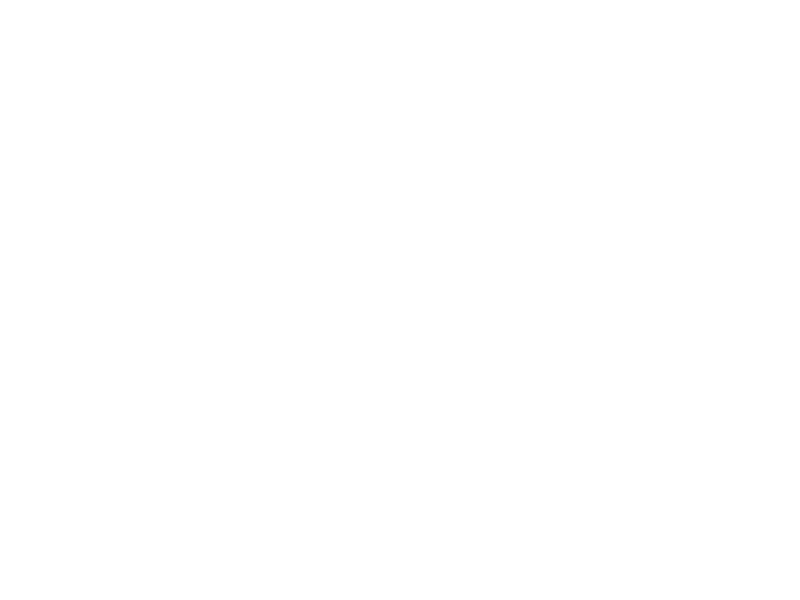

<IPython.core.display.Javascript object>


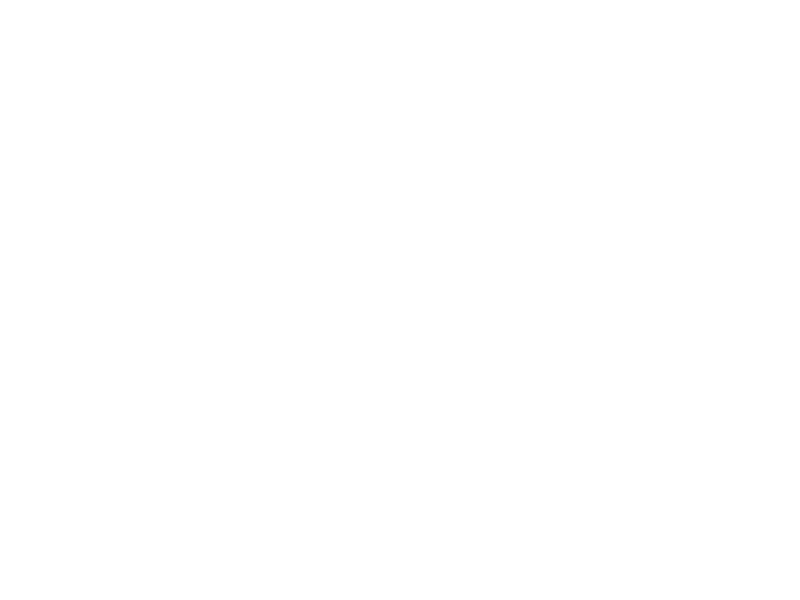

<IPython.core.display.Javascript object>


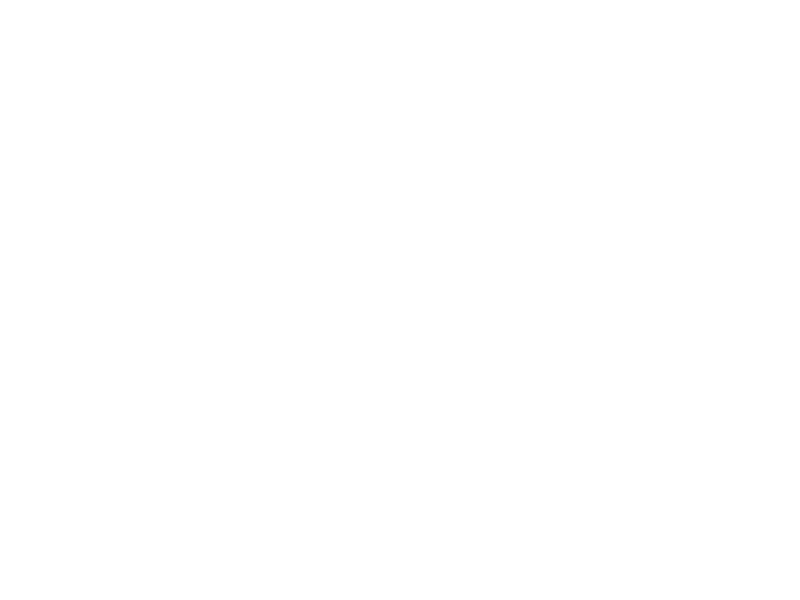

<IPython.core.display.Javascript object>


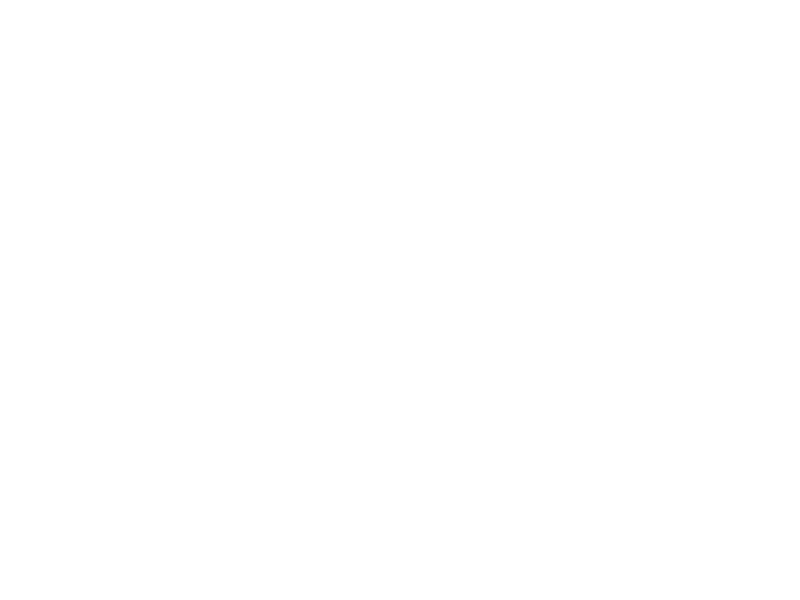

<IPython.core.display.Javascript object>


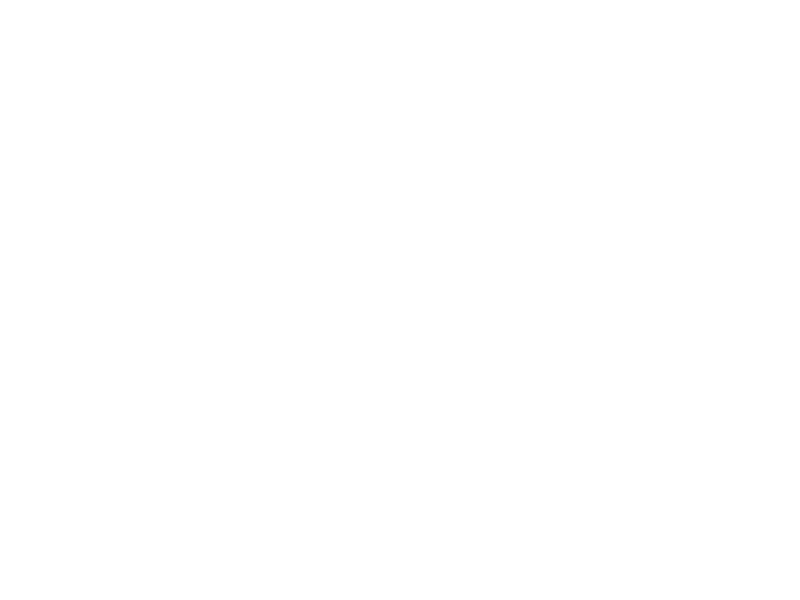

<IPython.core.display.Javascript object>


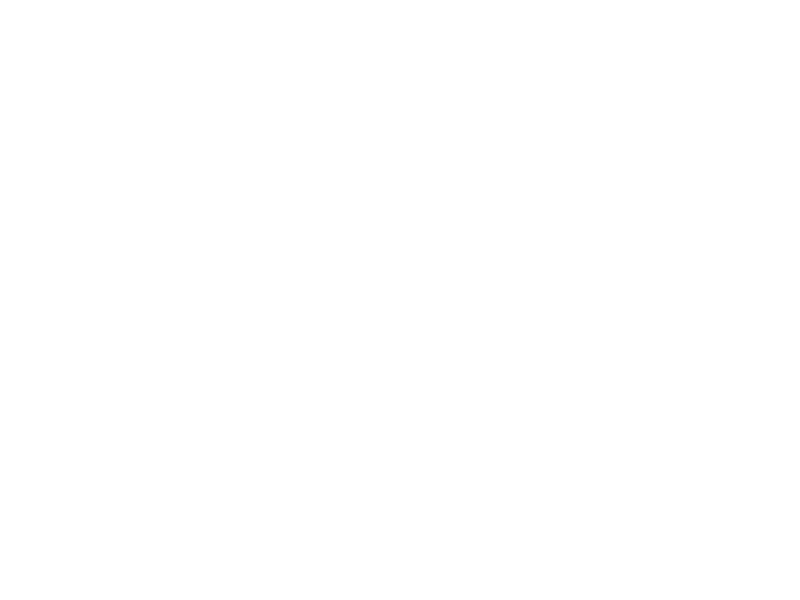

<IPython.core.display.Javascript object>


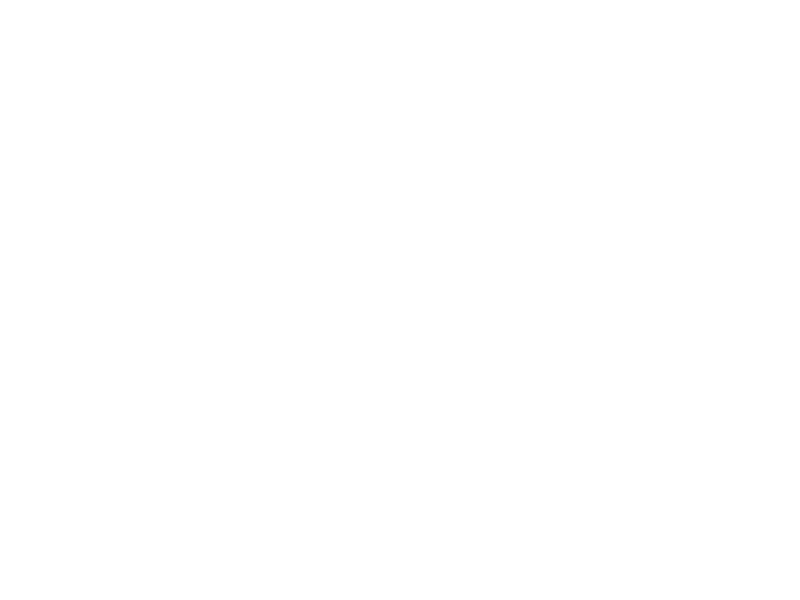

<IPython.core.display.Javascript object>


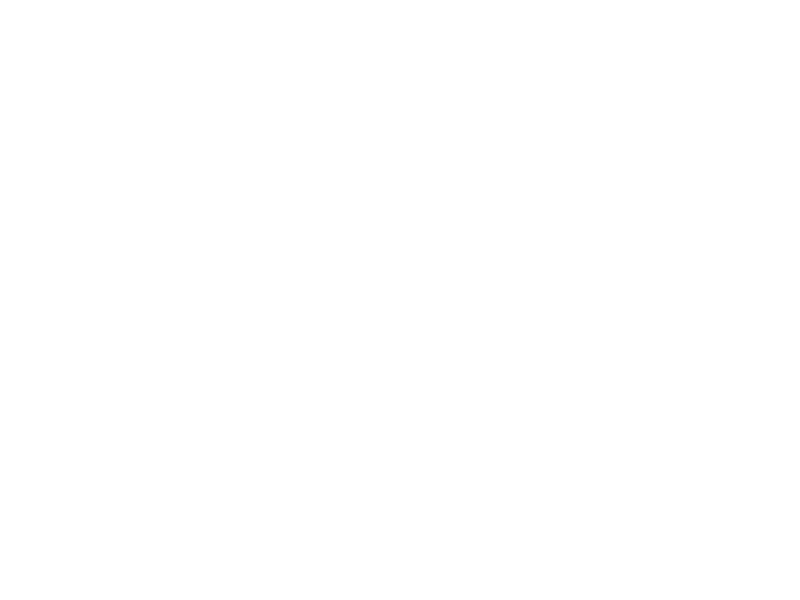

<IPython.core.display.Javascript object>


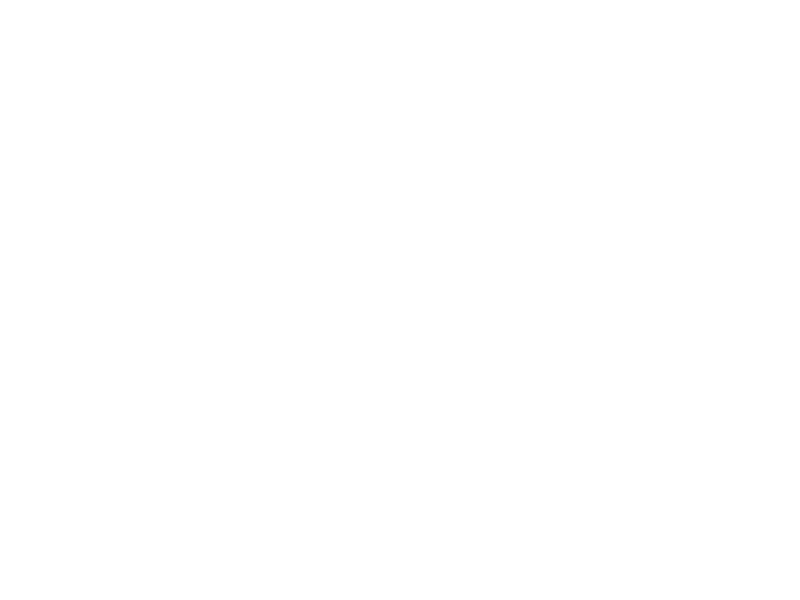

<IPython.core.display.Javascript object>


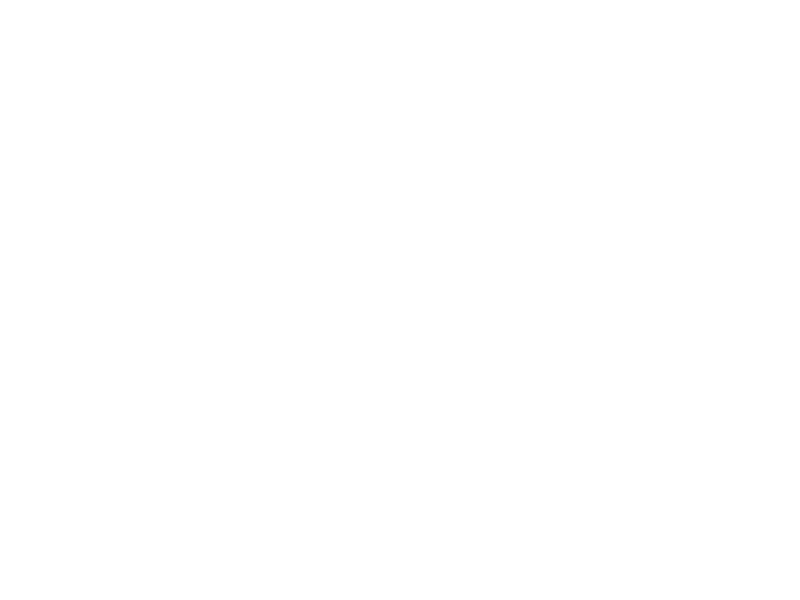

<IPython.core.display.Javascript object>


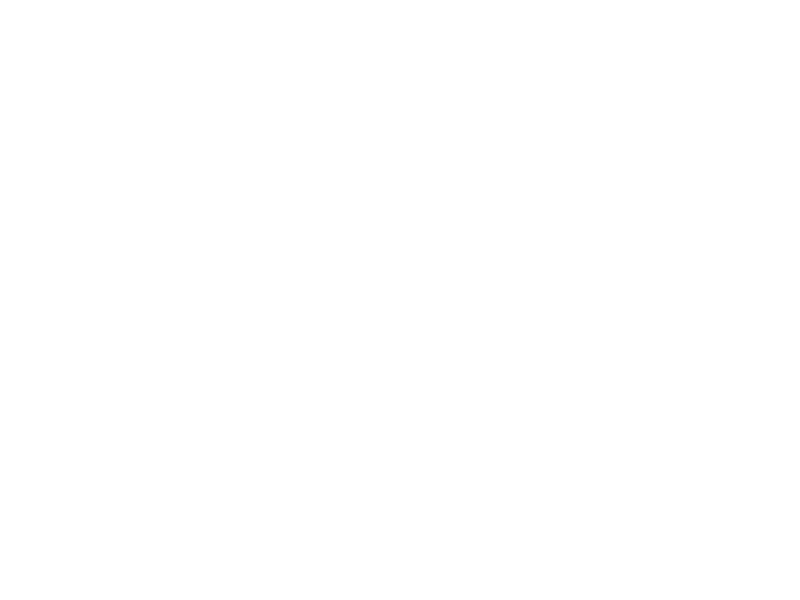

<IPython.core.display.Javascript object>


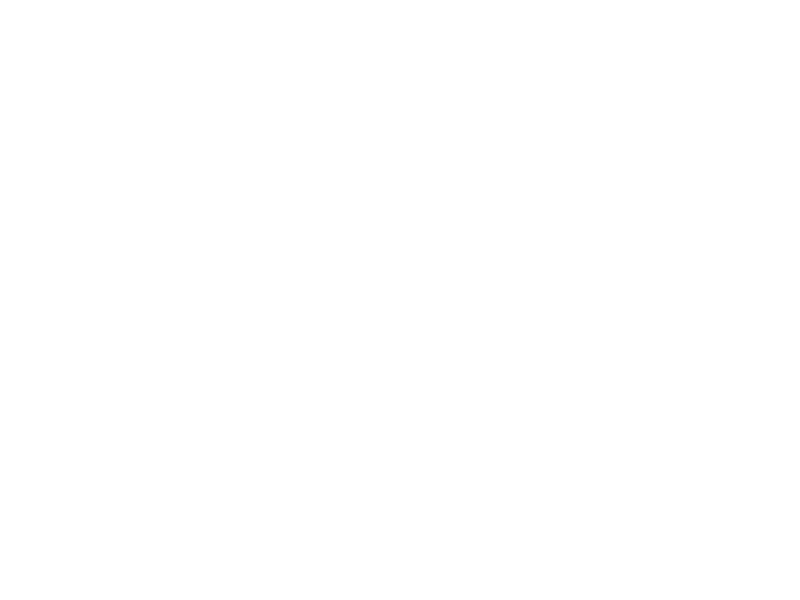

<IPython.core.display.Javascript object>


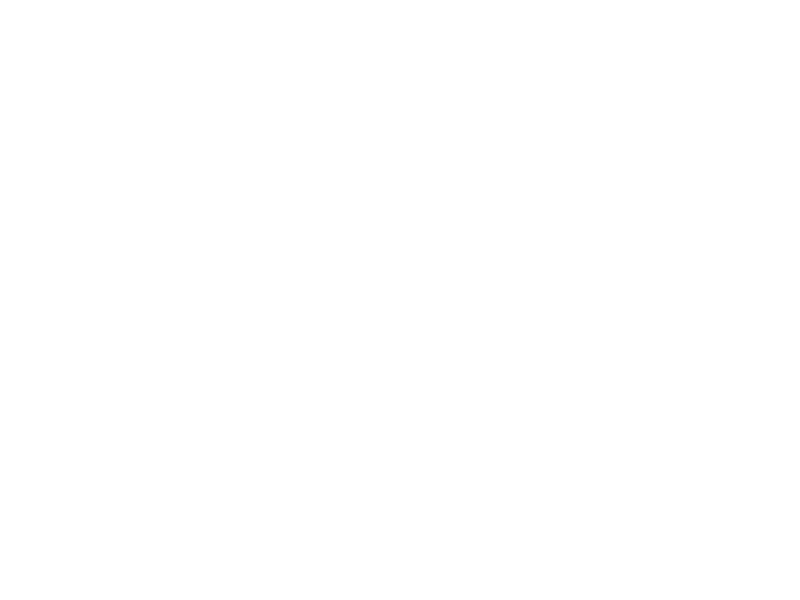

<IPython.core.display.Javascript object>


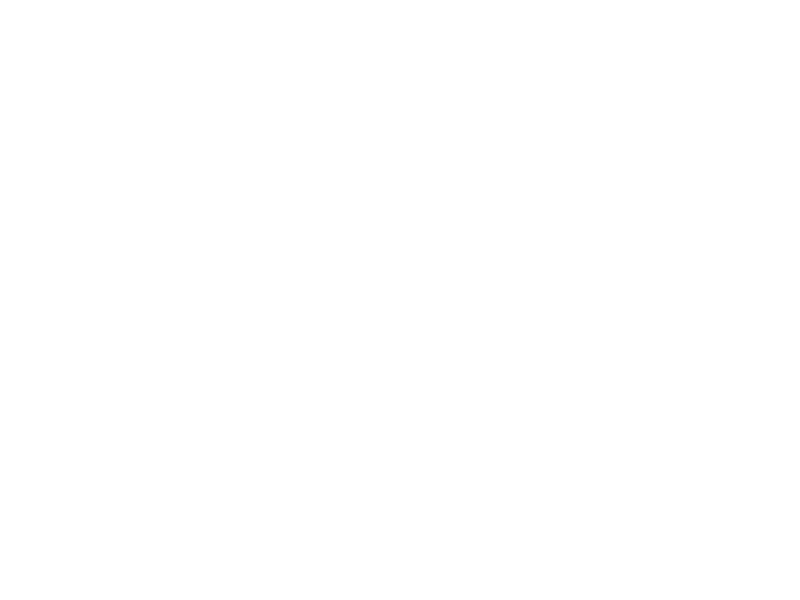

<IPython.core.display.Javascript object>


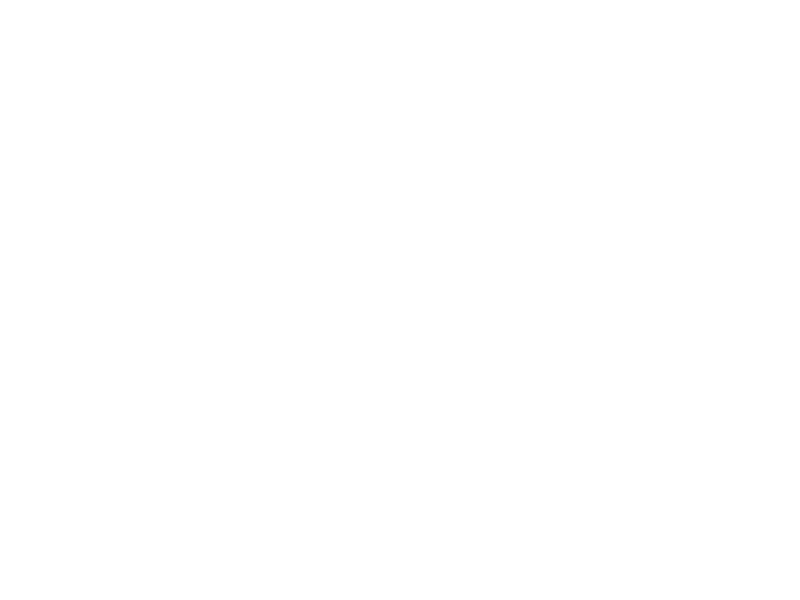

<IPython.core.display.Javascript object>


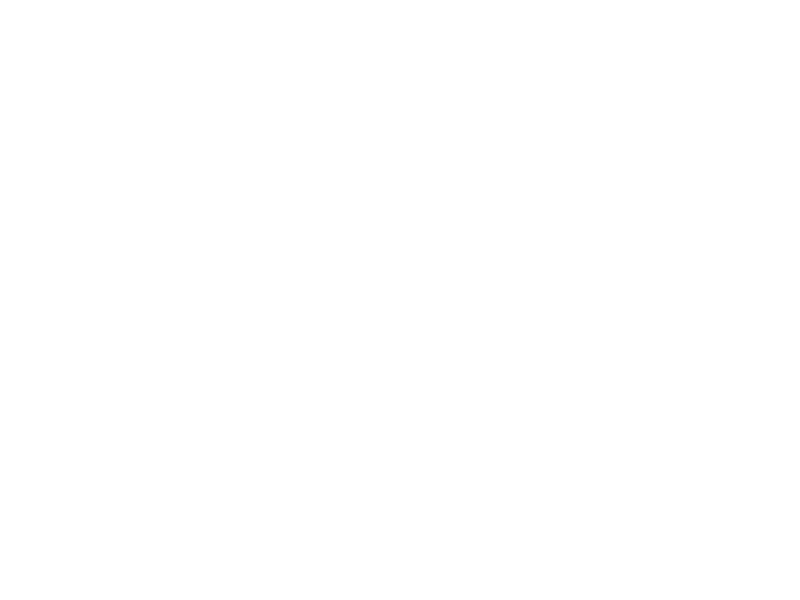

<IPython.core.display.Javascript object>


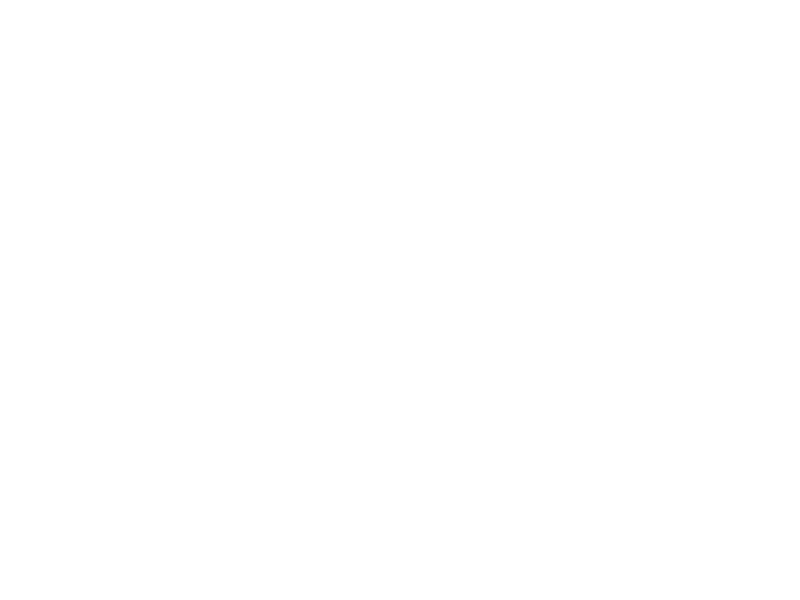

<IPython.core.display.Javascript object>


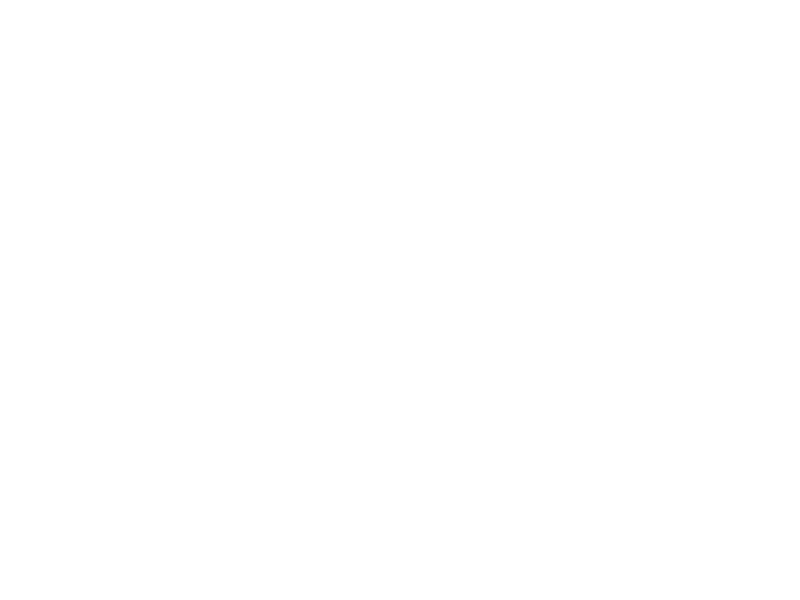

<IPython.core.display.Javascript object>


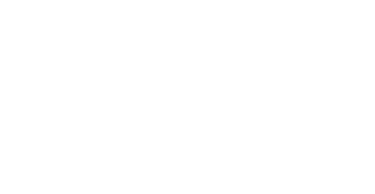

<IPython.core.display.Javascript object>


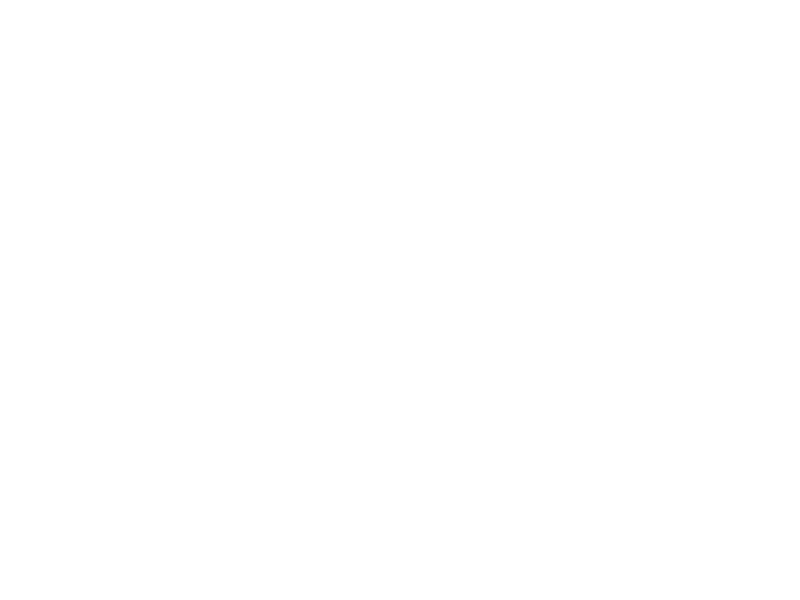

<IPython.core.display.Javascript object>


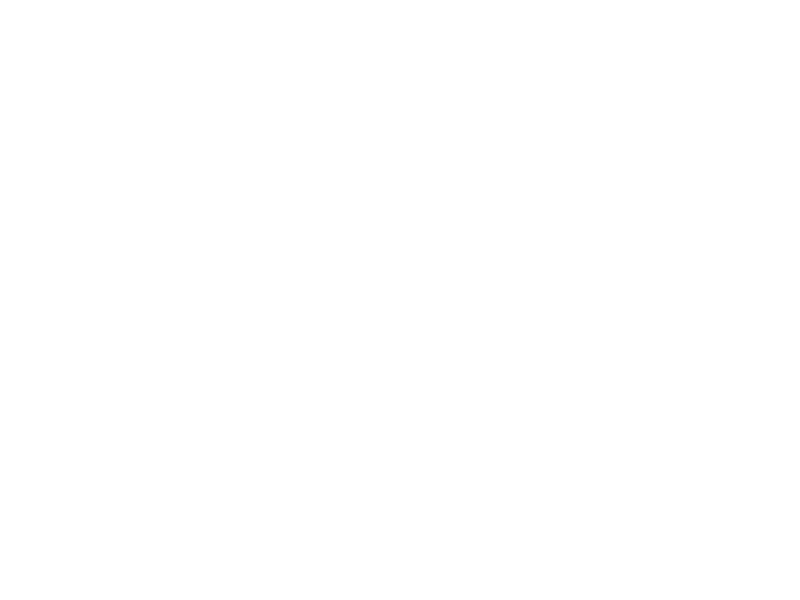

<IPython.core.display.Javascript object>


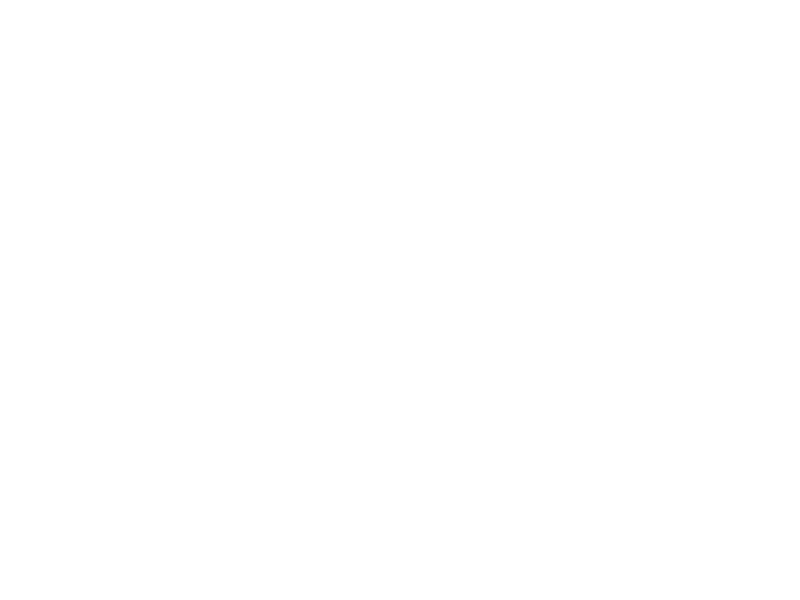

<IPython.core.display.Javascript object>


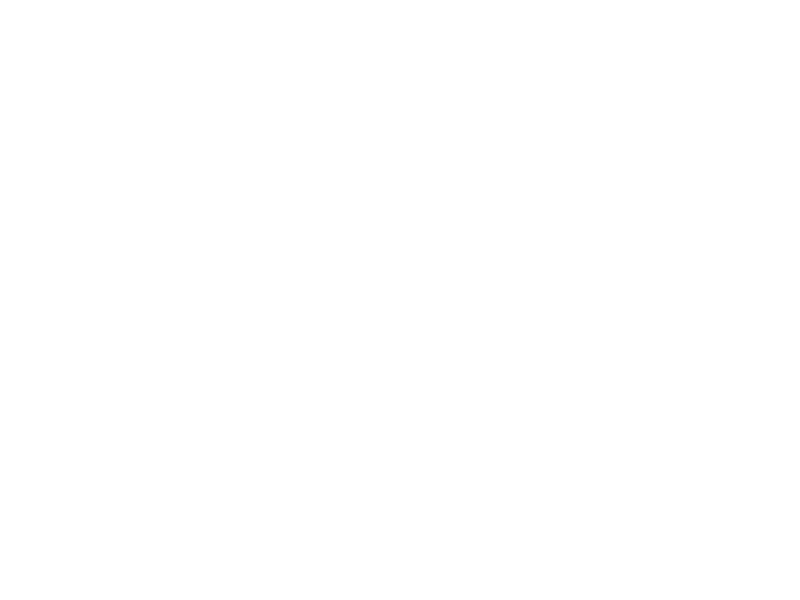

<IPython.core.display.Javascript object>


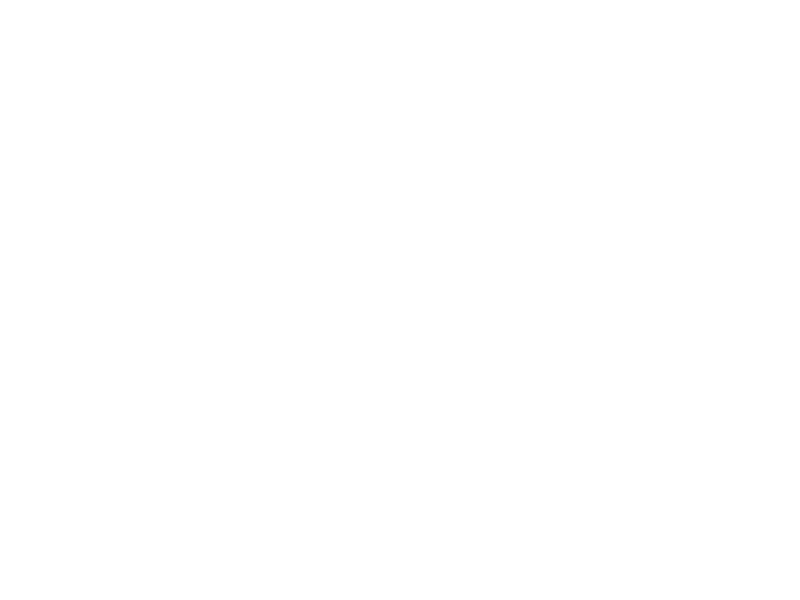

<IPython.core.display.Javascript object>


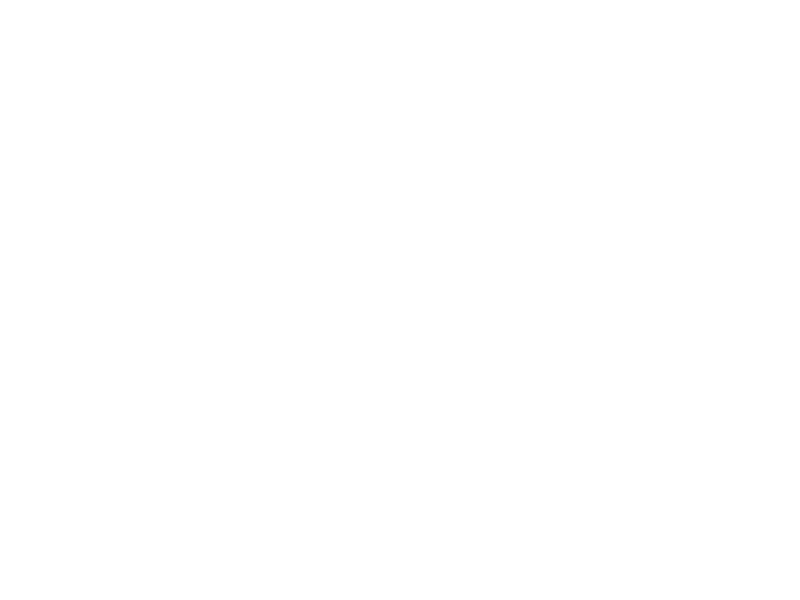

<IPython.core.display.Javascript object>


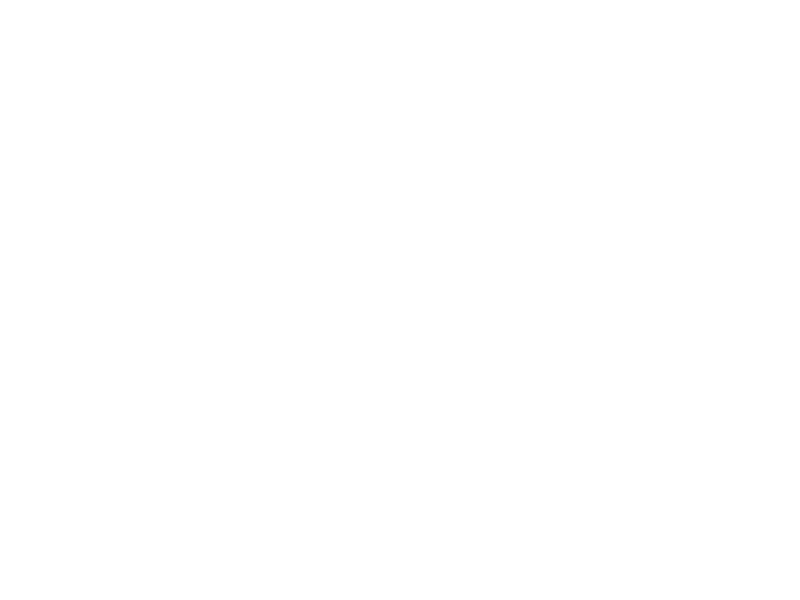

<IPython.core.display.Javascript object>


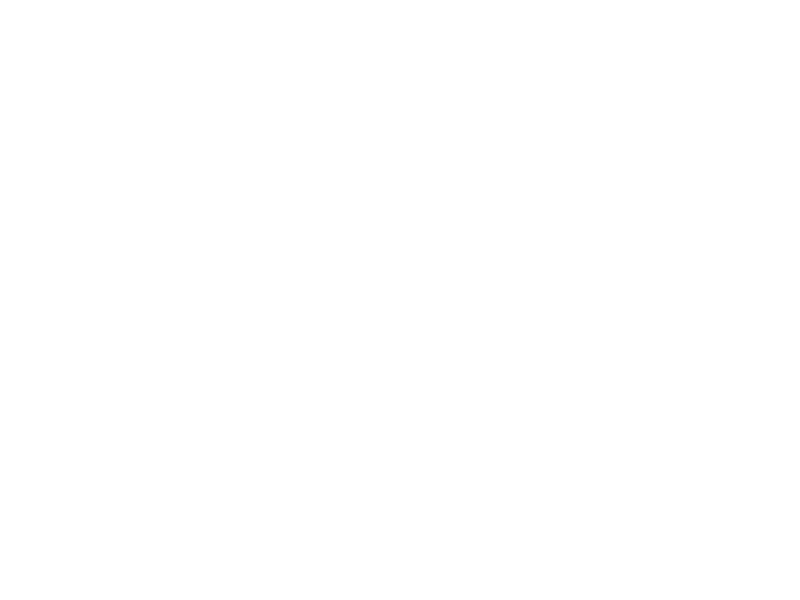

<IPython.core.display.Javascript object>


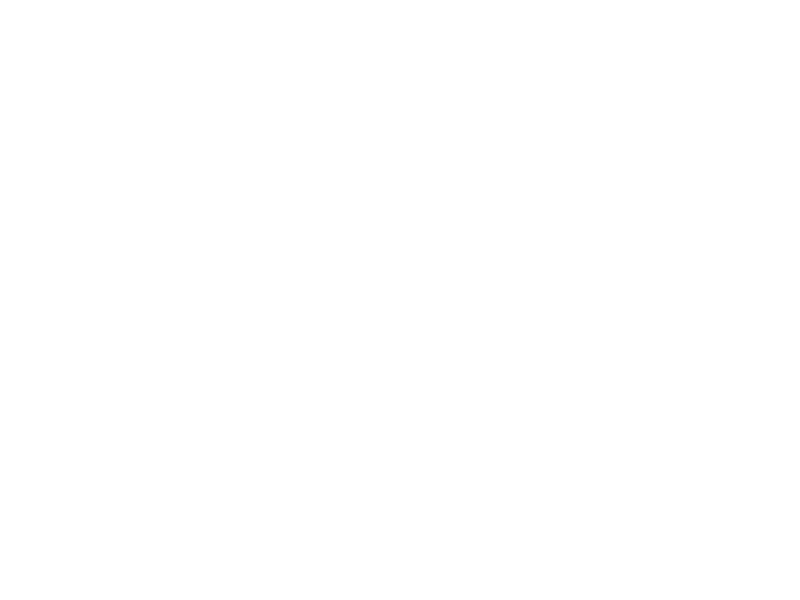

<IPython.core.display.Javascript object>


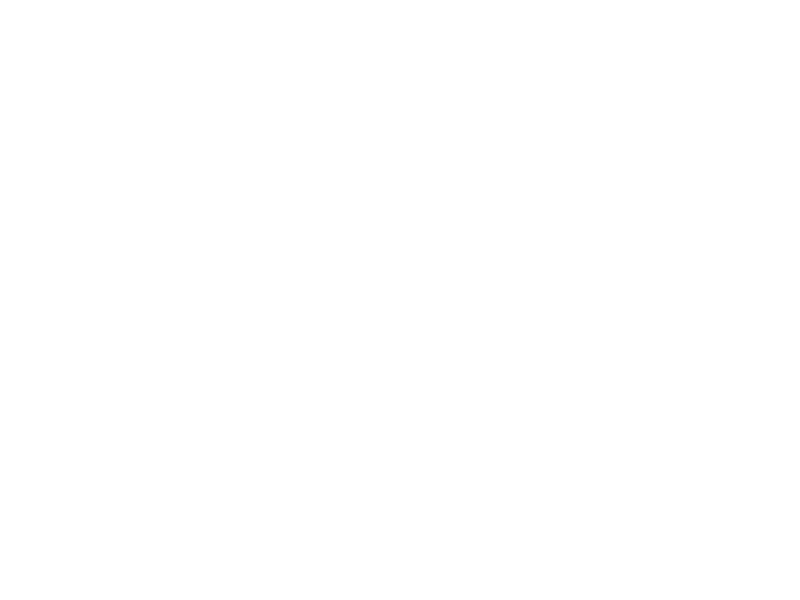

<IPython.core.display.Javascript object>


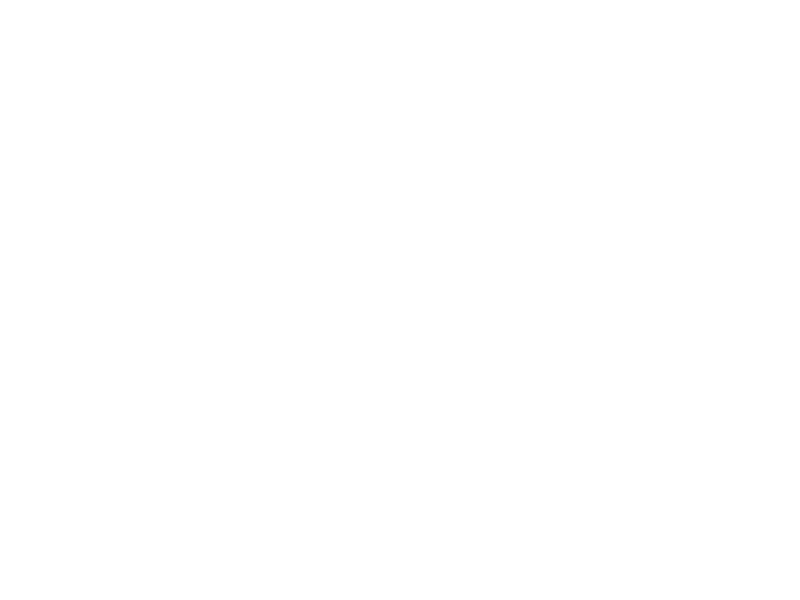

<IPython.core.display.Javascript object>


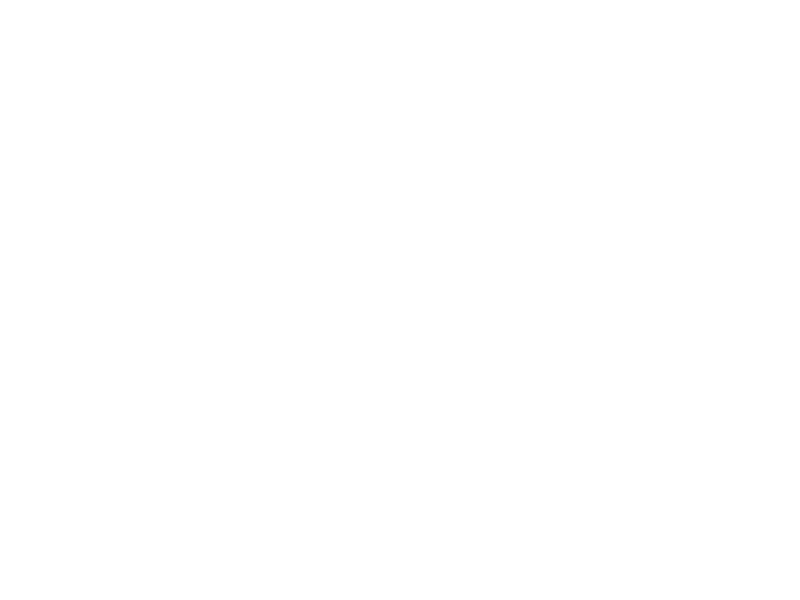

<IPython.core.display.Javascript object>


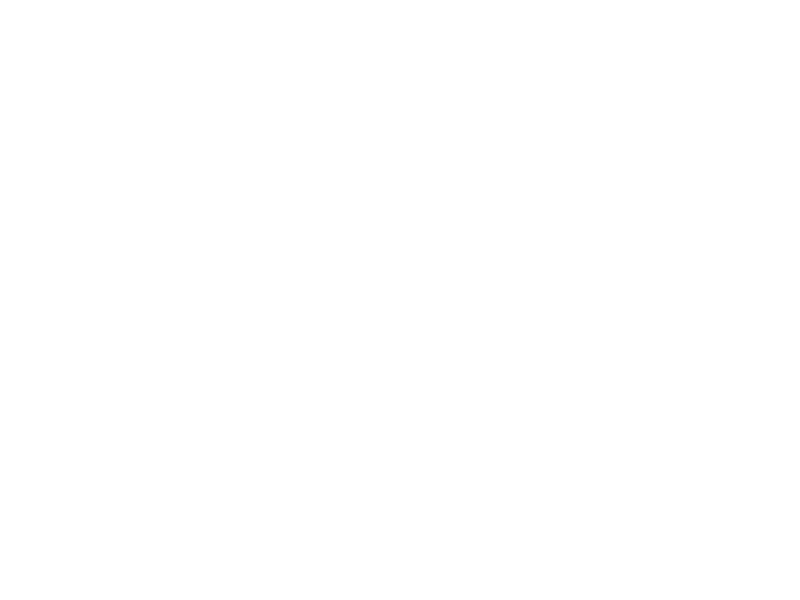

<IPython.core.display.Javascript object>


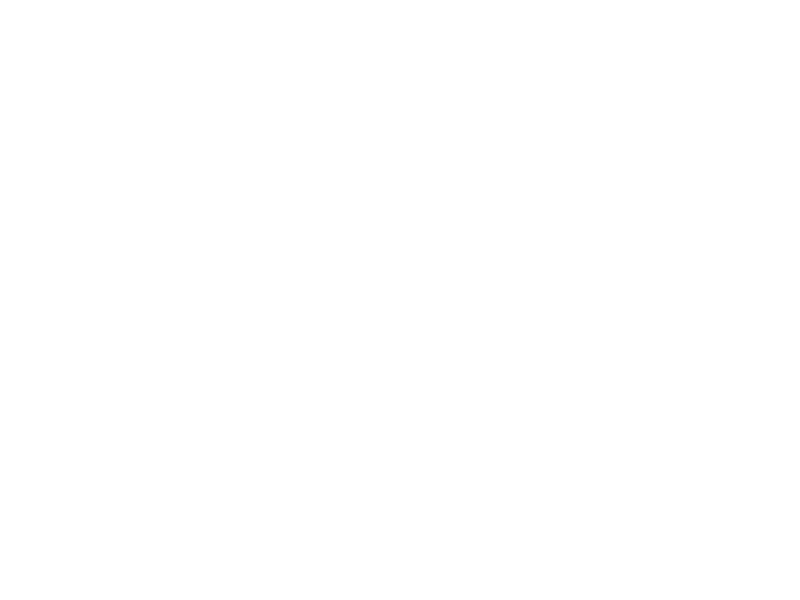

<IPython.core.display.Javascript object>


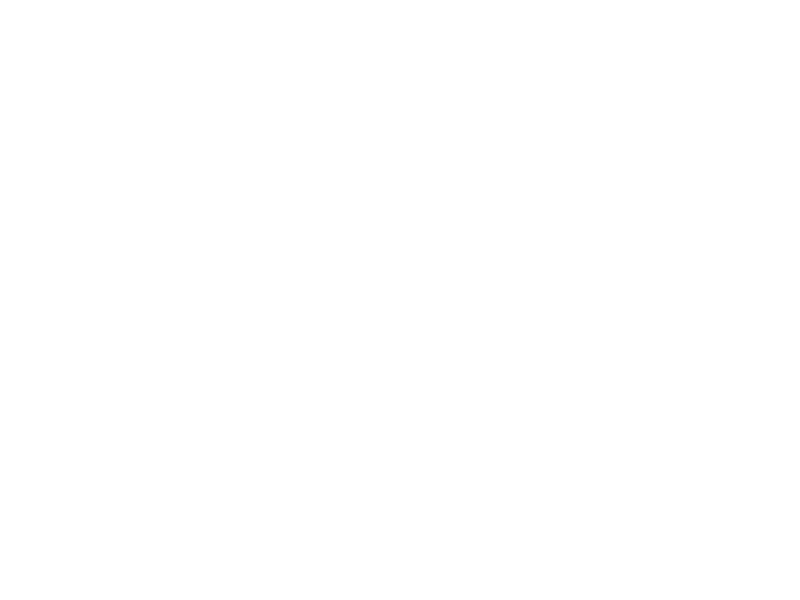

<IPython.core.display.Javascript object>


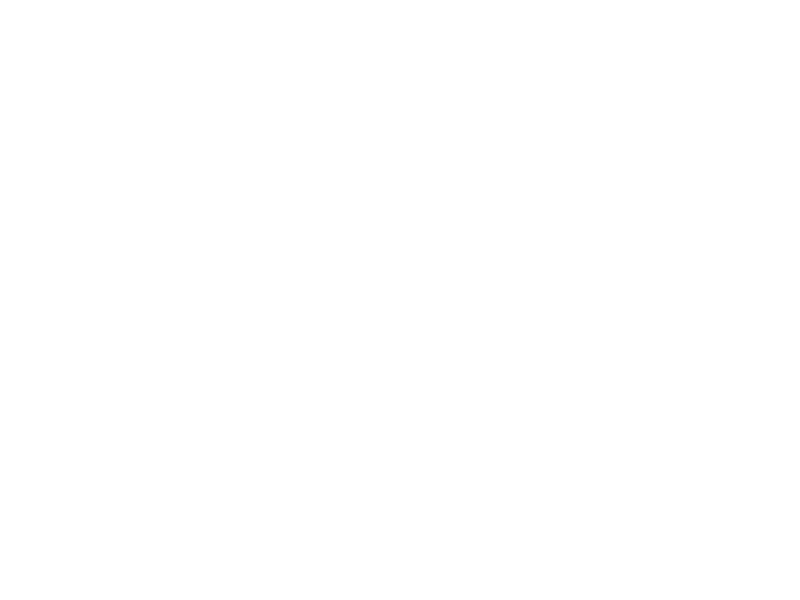

<IPython.core.display.Javascript object>


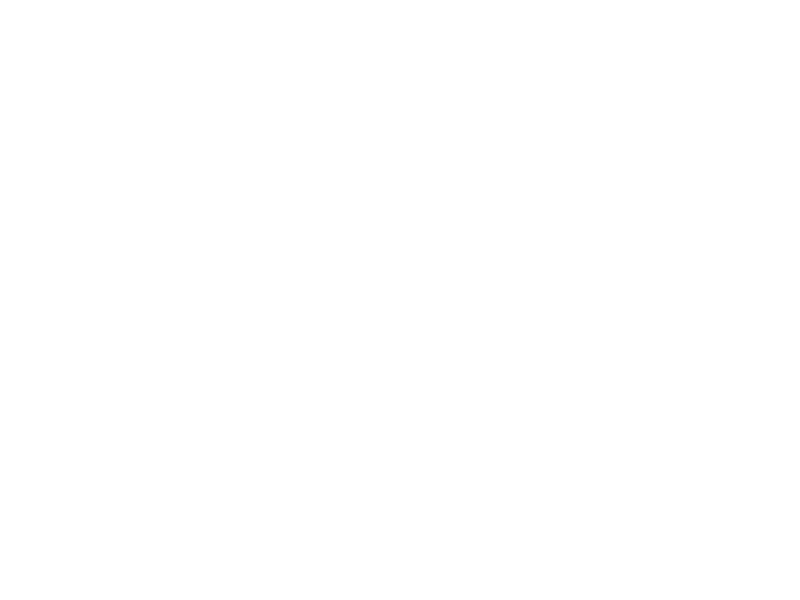

<IPython.core.display.Javascript object>


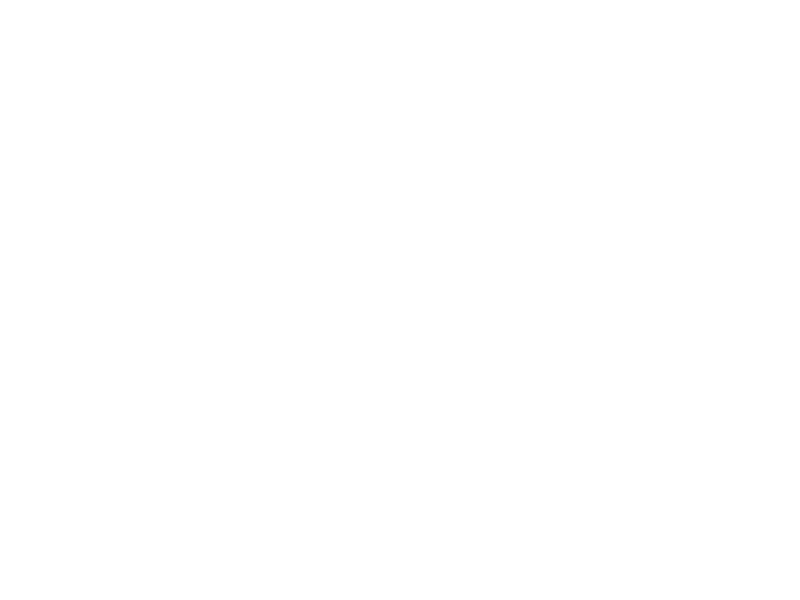

<IPython.core.display.Javascript object>


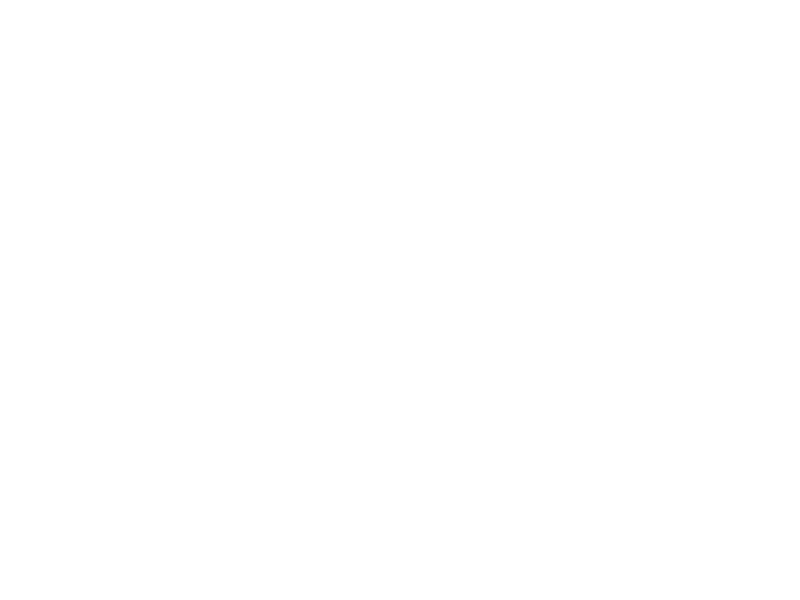

<IPython.core.display.Javascript object>


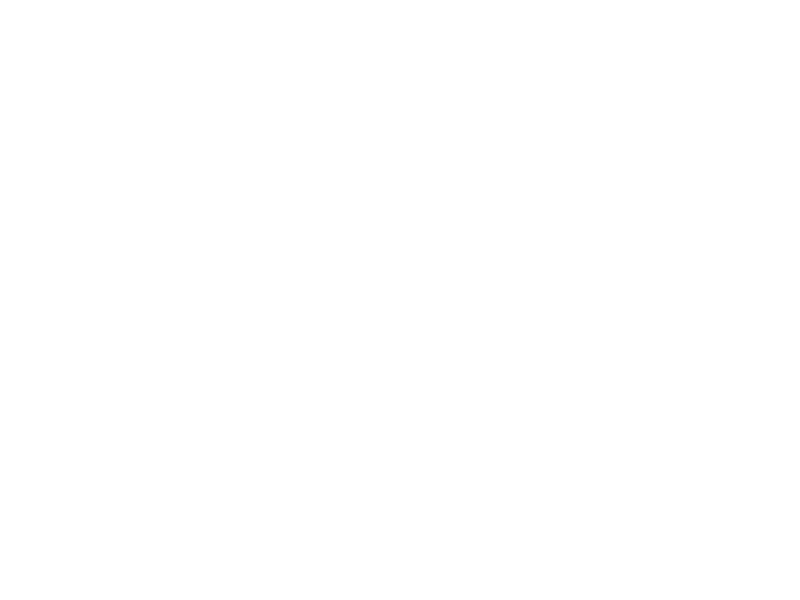

<IPython.core.display.Javascript object>


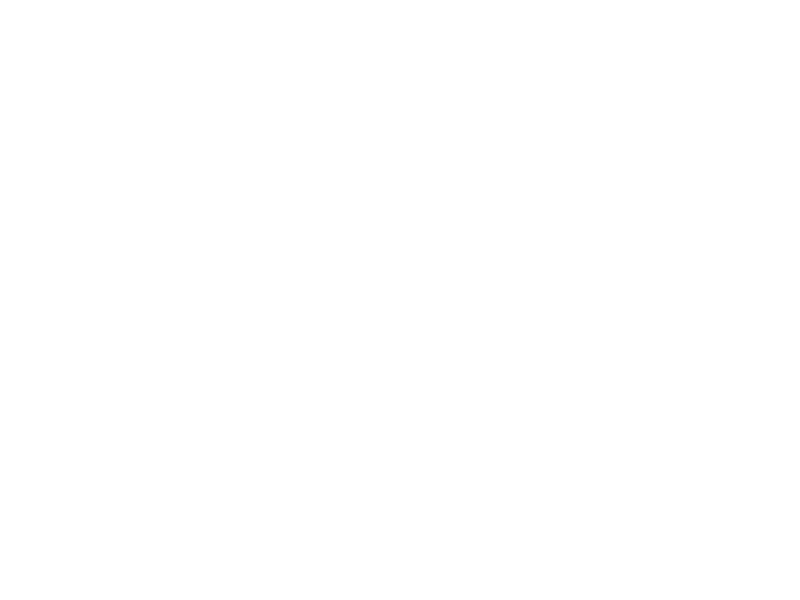

<IPython.core.display.Javascript object>


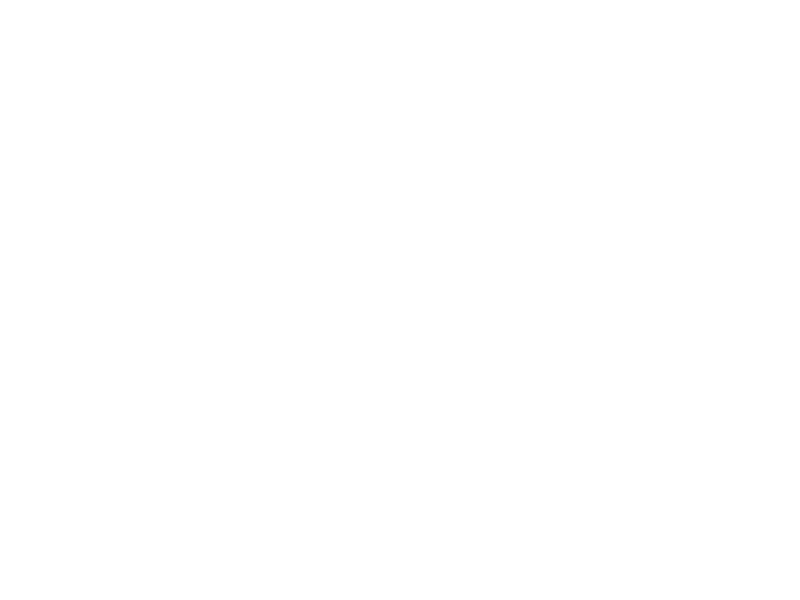

<IPython.core.display.Javascript object>


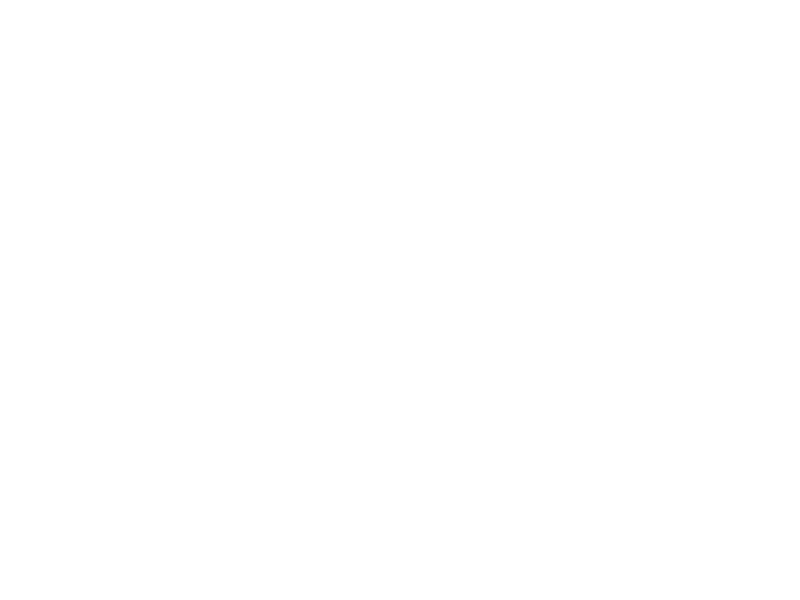

<IPython.core.display.Javascript object>


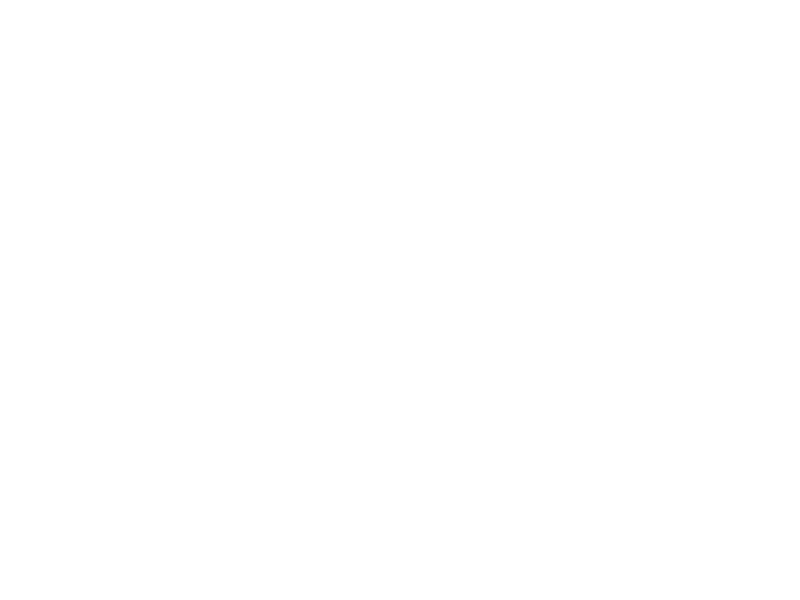

<IPython.core.display.Javascript object>


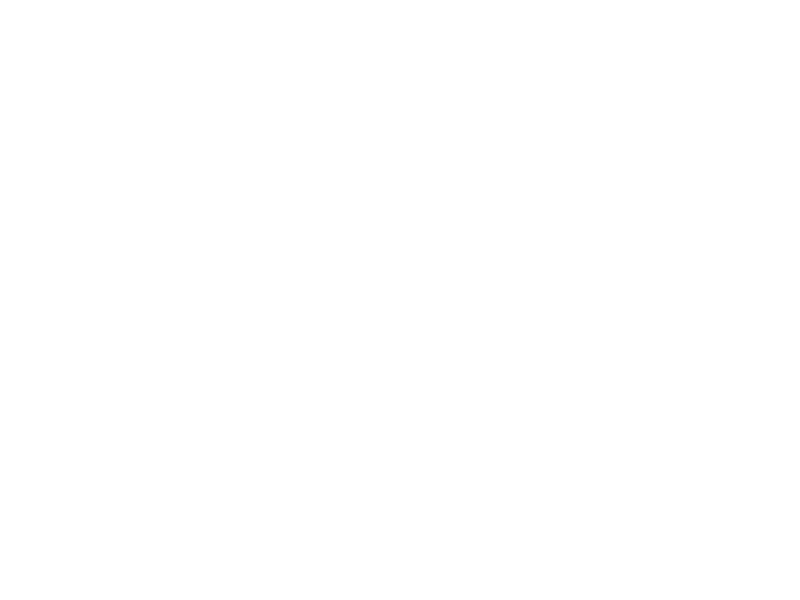

<IPython.core.display.Javascript object>


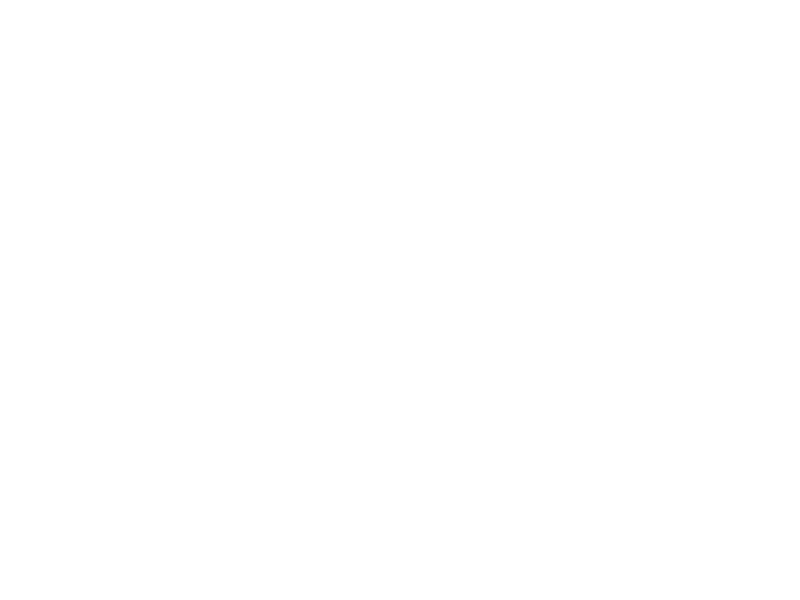

<IPython.core.display.Javascript object>


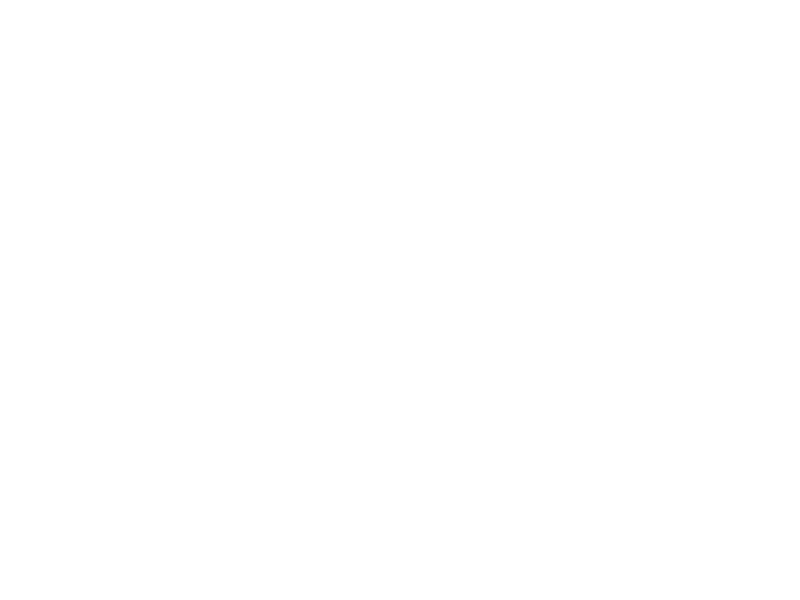

<IPython.core.display.Javascript object>


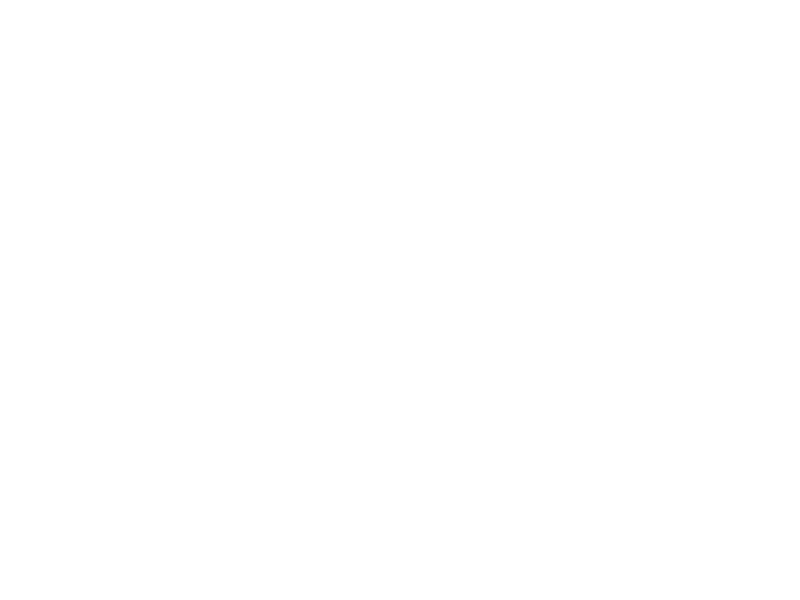

<IPython.core.display.Javascript object>


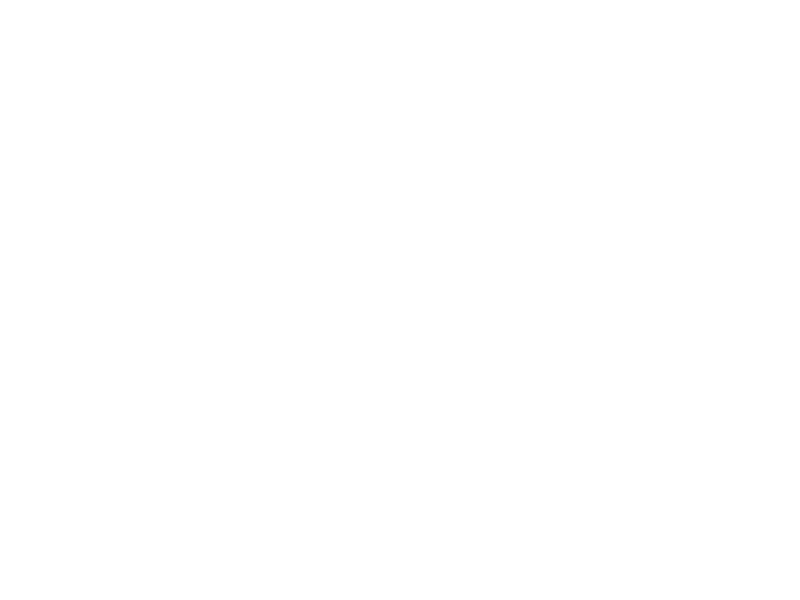

<IPython.core.display.Javascript object>


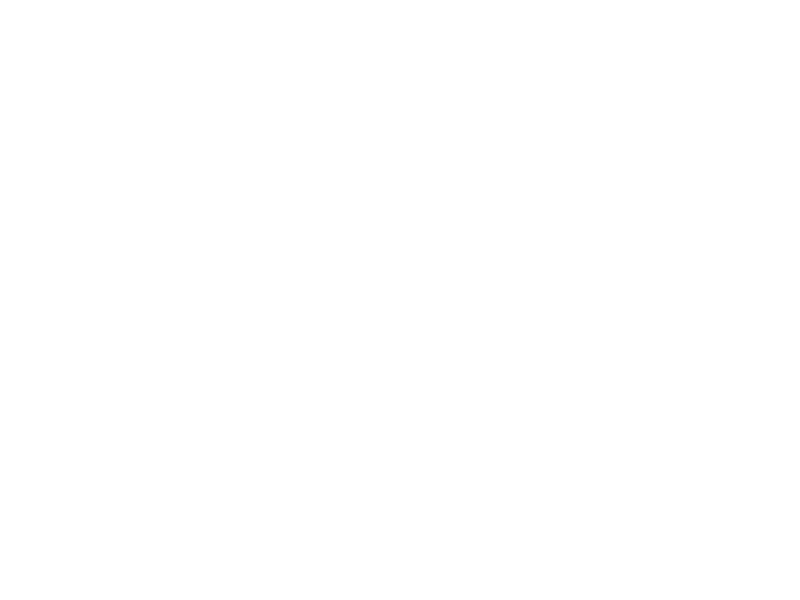

<IPython.core.display.Javascript object>


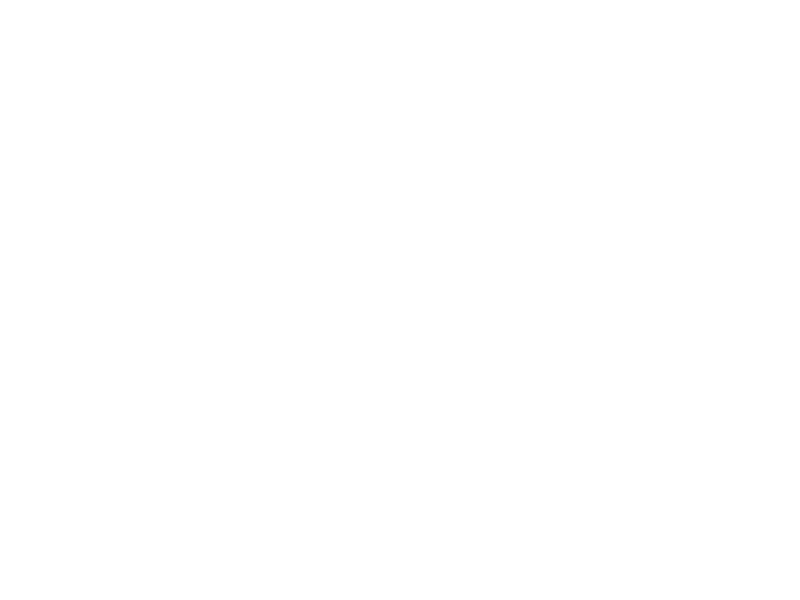

<IPython.core.display.Javascript object>


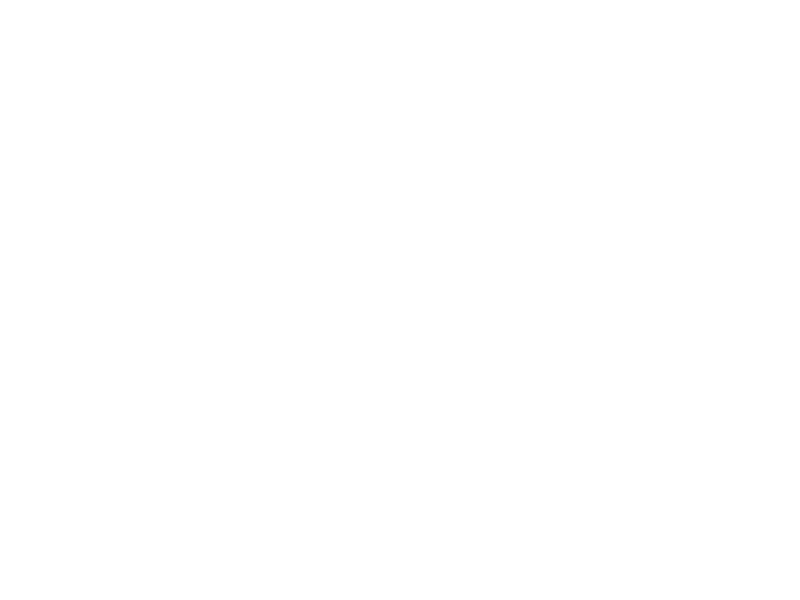

<IPython.core.display.Javascript object>


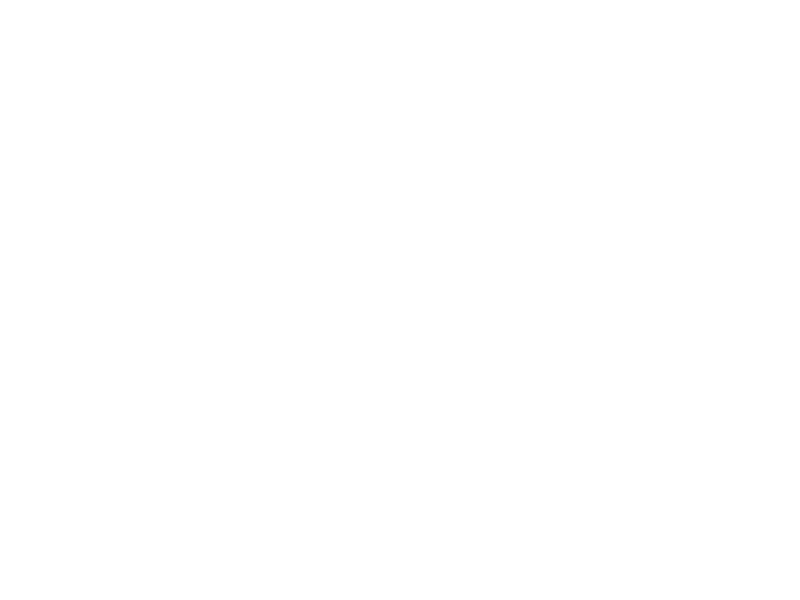

<IPython.core.display.Javascript object>


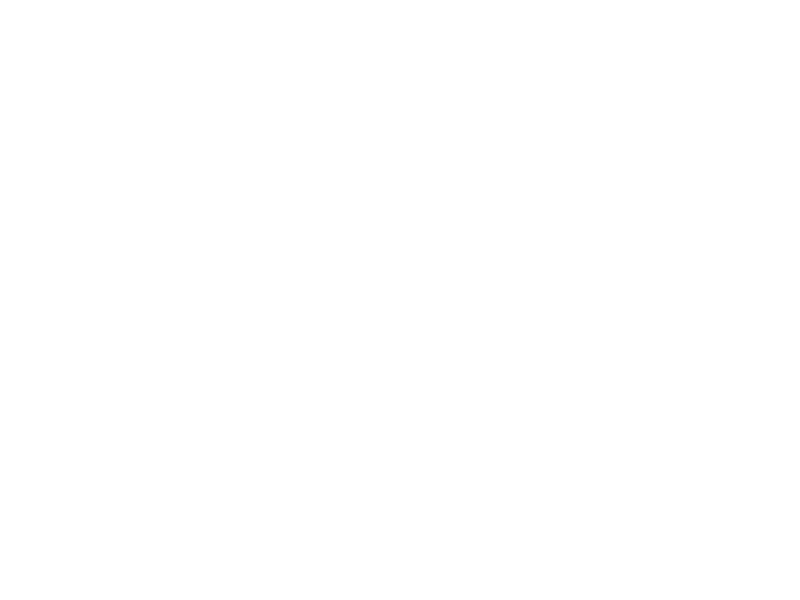

<IPython.core.display.Javascript object>


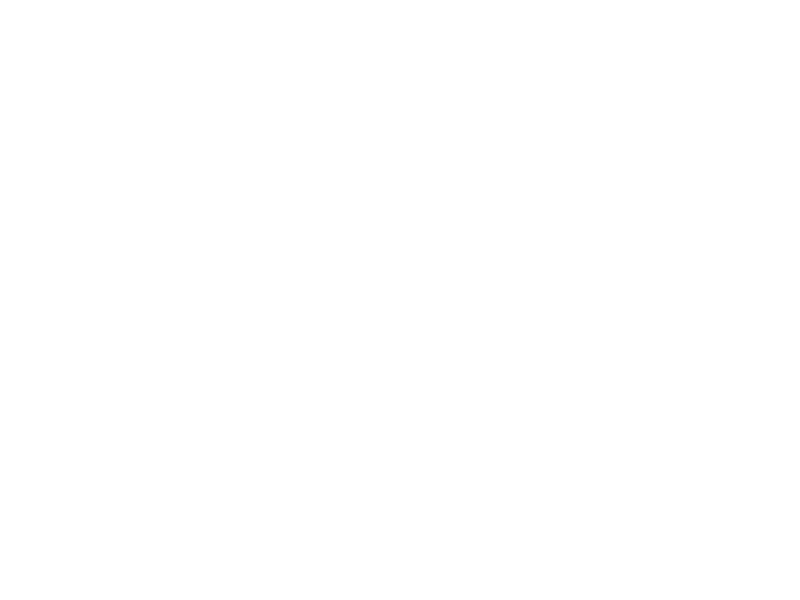

<IPython.core.display.Javascript object>


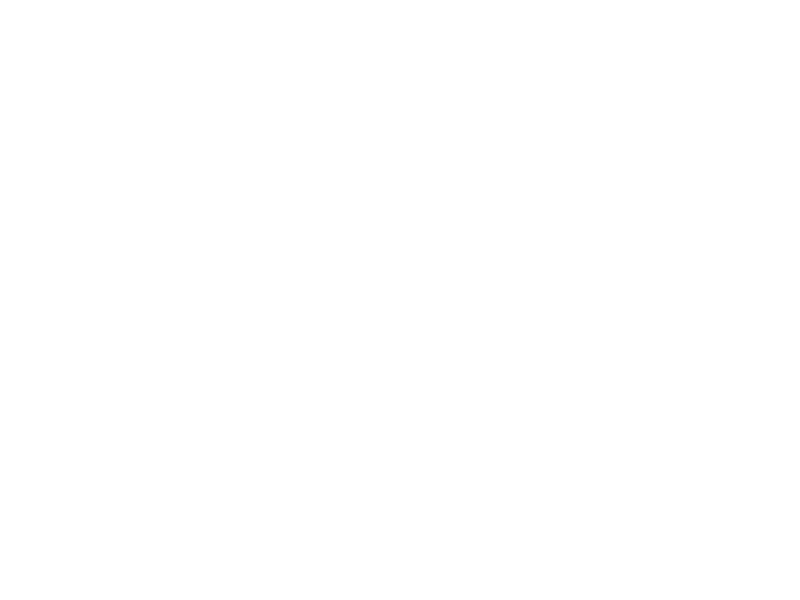

<IPython.core.display.Javascript object>


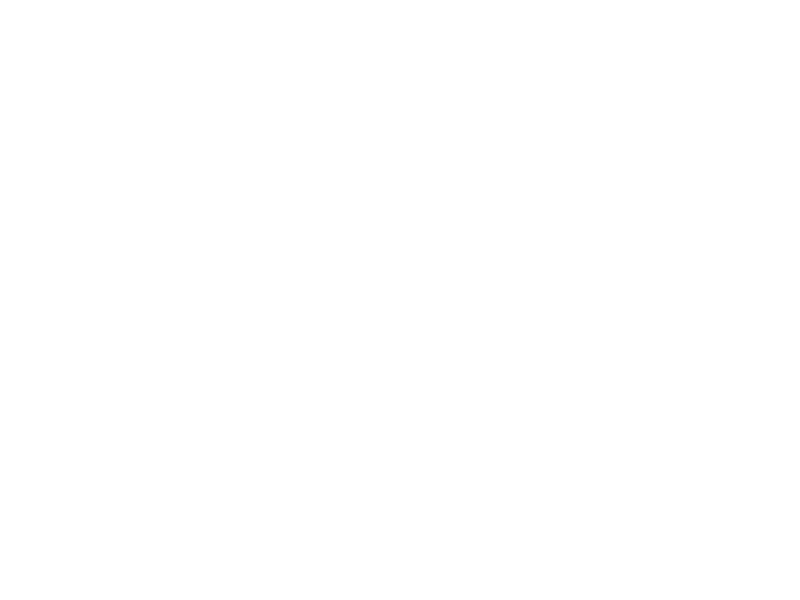

<IPython.core.display.Javascript object>


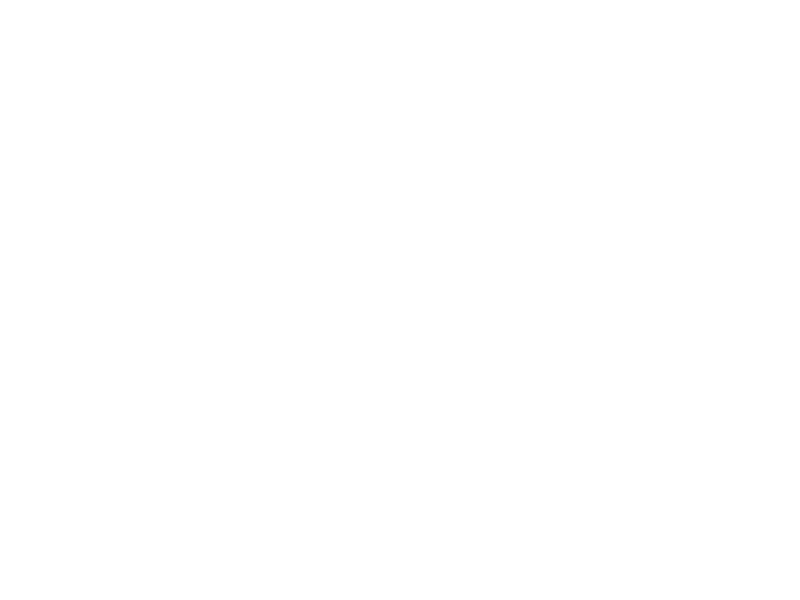

<IPython.core.display.Javascript object>


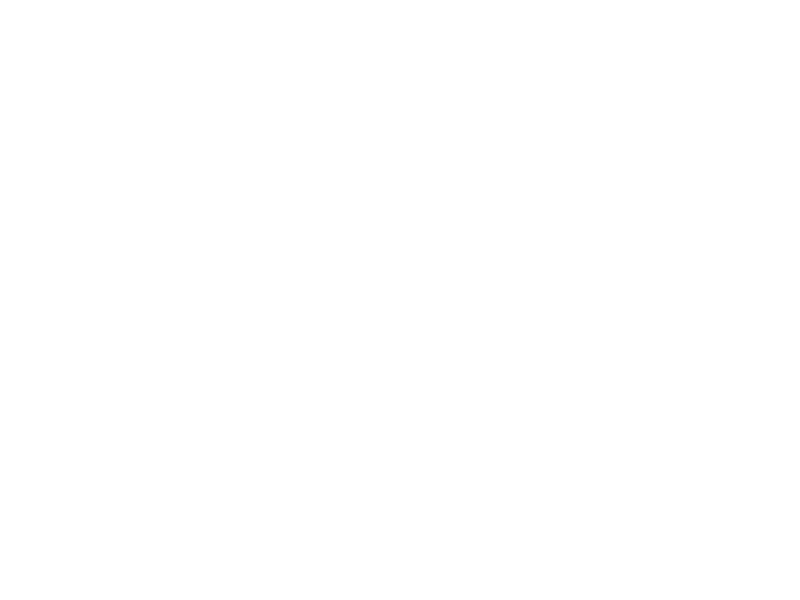

<IPython.core.display.Javascript object>


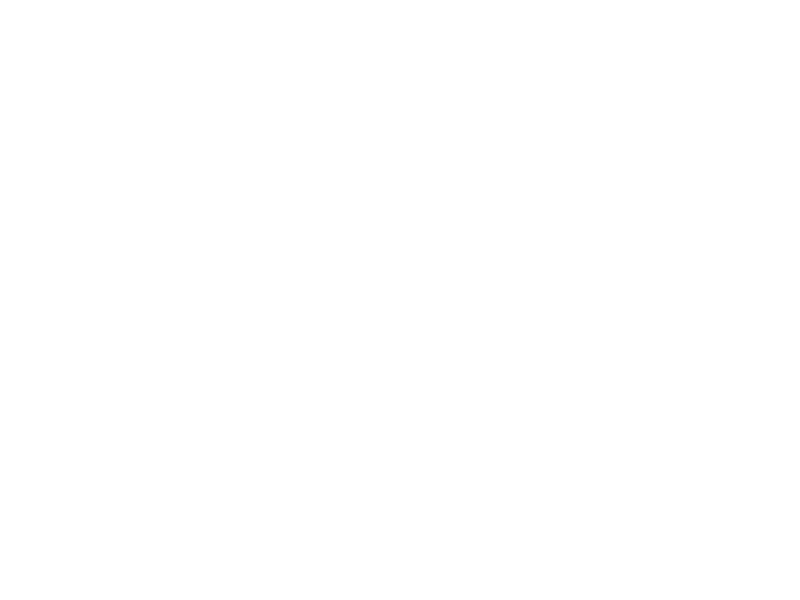

<IPython.core.display.Javascript object>


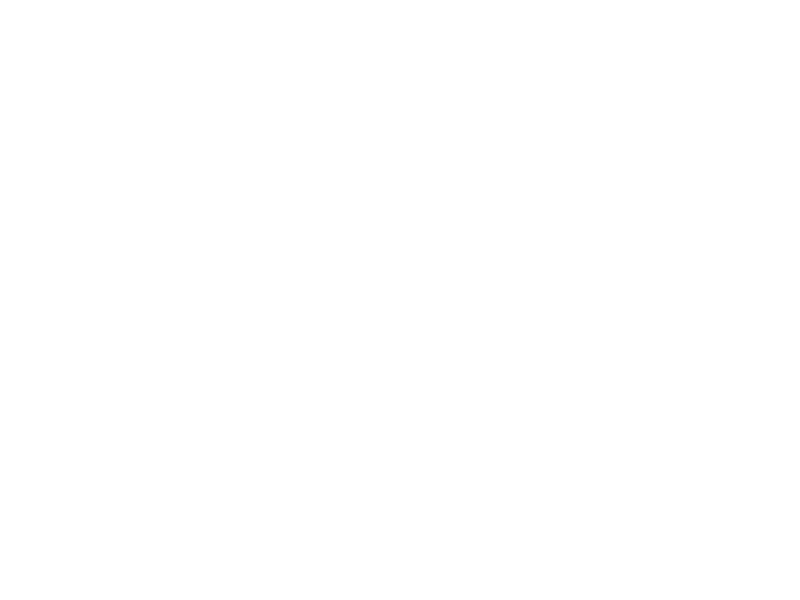

<IPython.core.display.Javascript object>


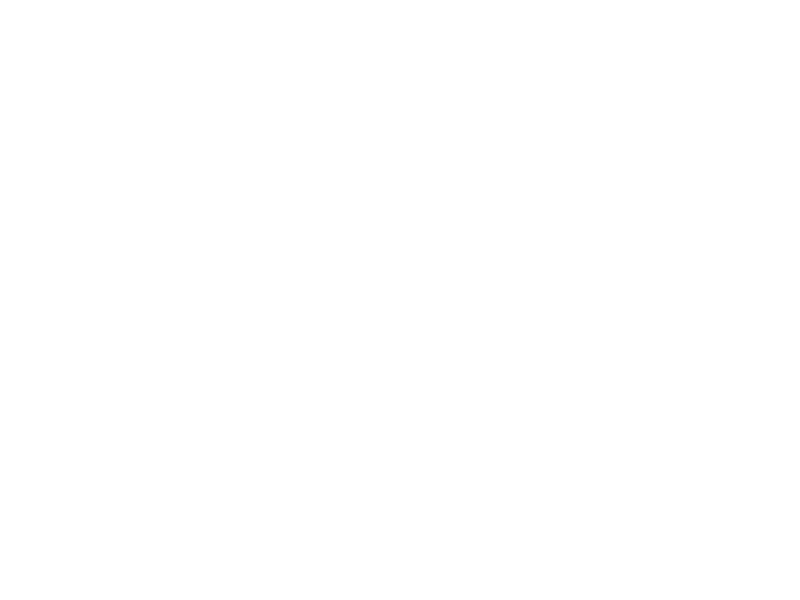

<IPython.core.display.Javascript object>


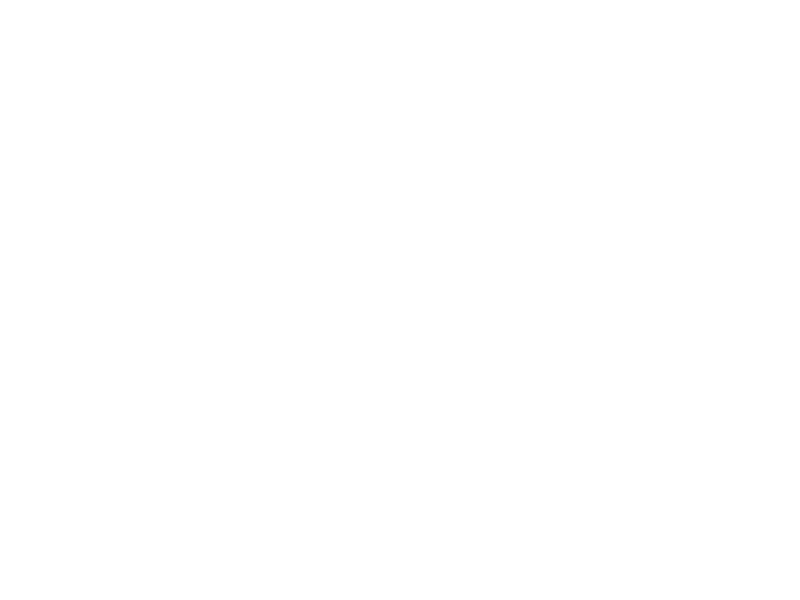

<IPython.core.display.Javascript object>


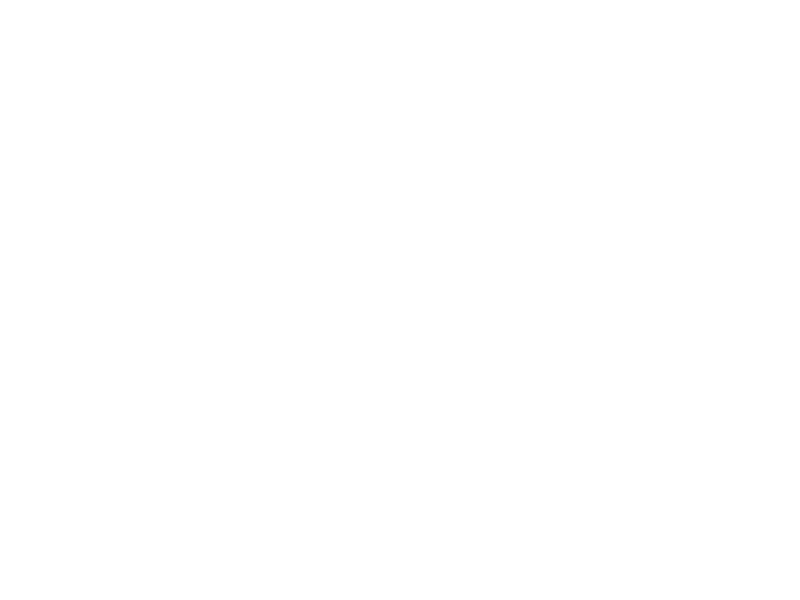

<IPython.core.display.Javascript object>


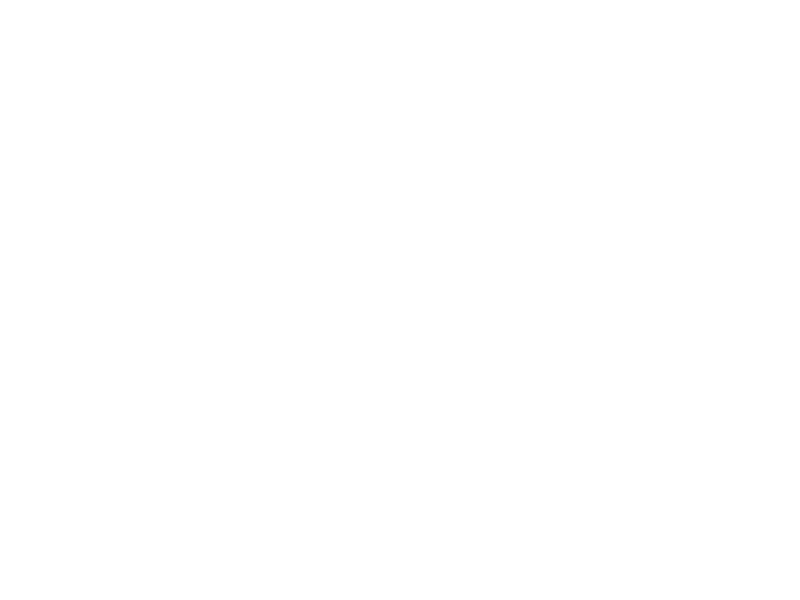

<IPython.core.display.Javascript object>


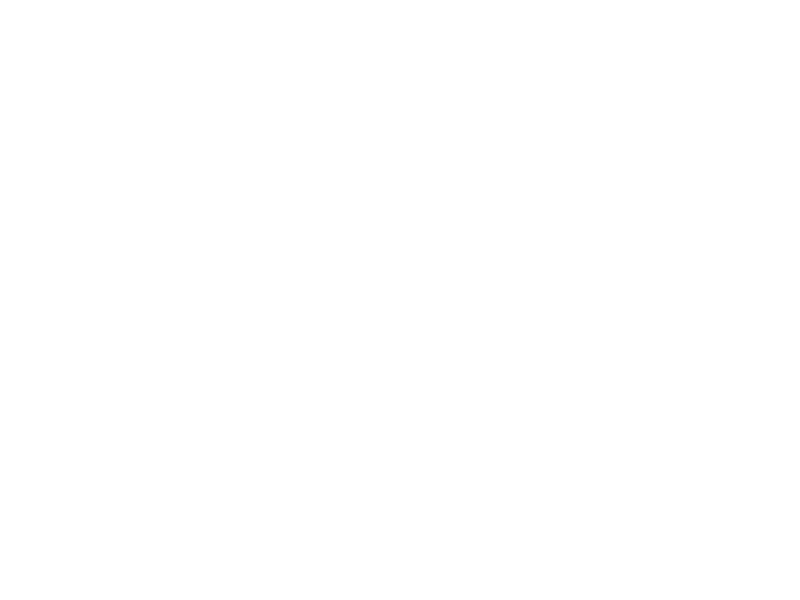

<IPython.core.display.Javascript object>


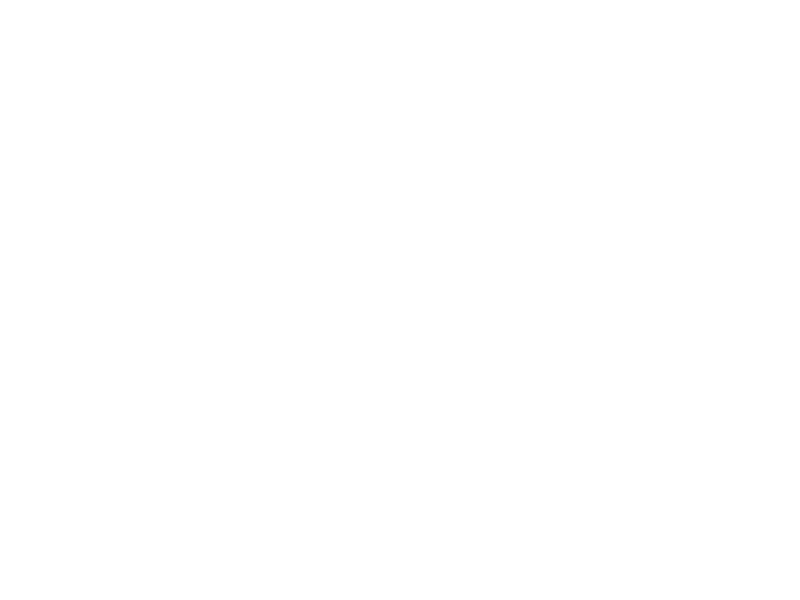

<IPython.core.display.Javascript object>


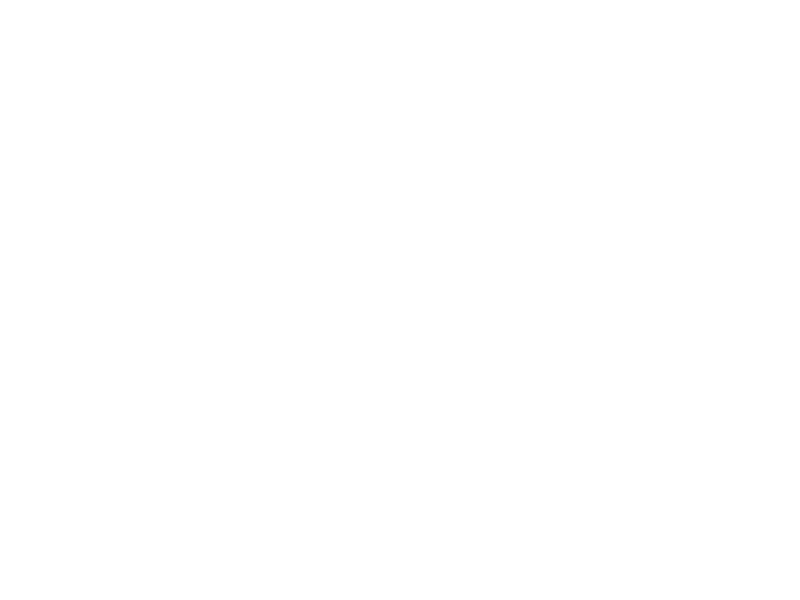

<IPython.core.display.Javascript object>


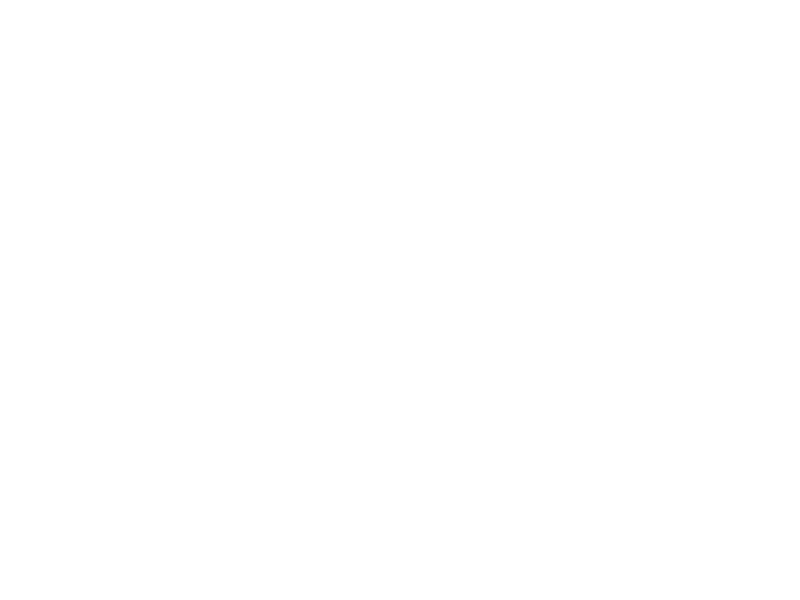

<IPython.core.display.Javascript object>


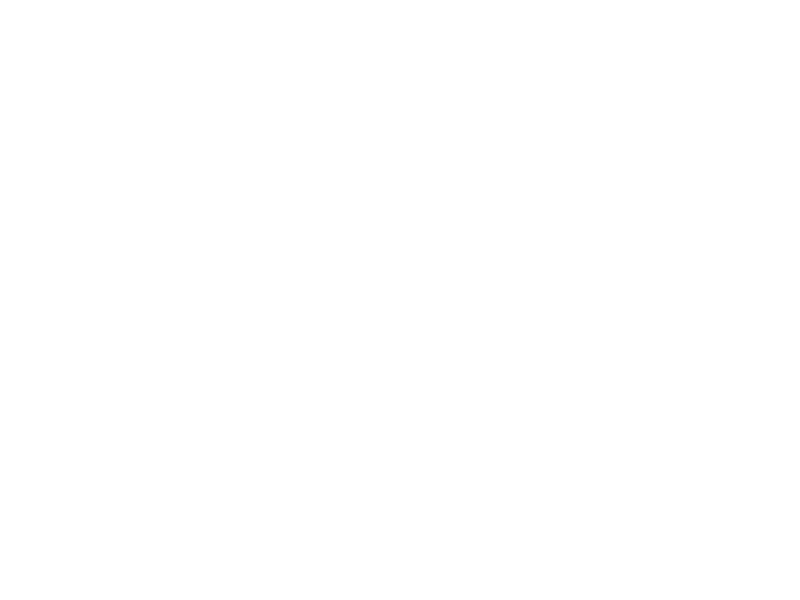

<IPython.core.display.Javascript object>


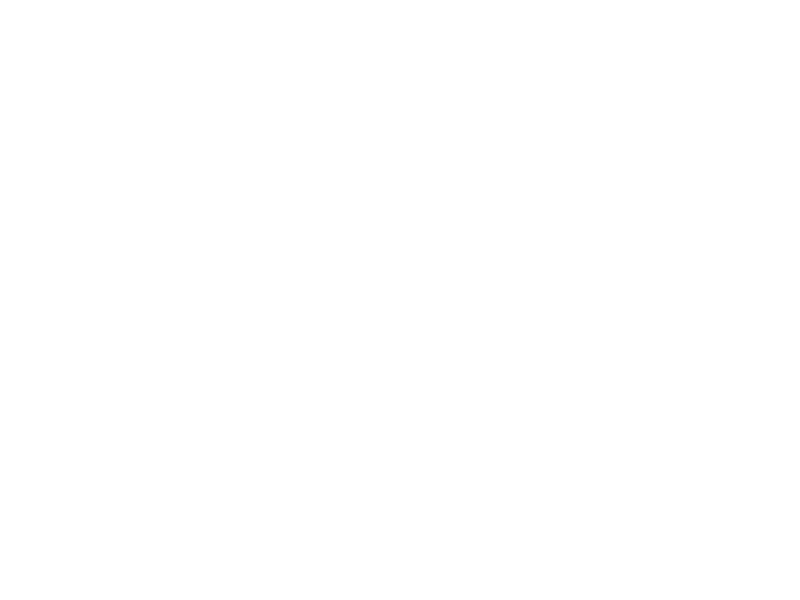

<IPython.core.display.Javascript object>


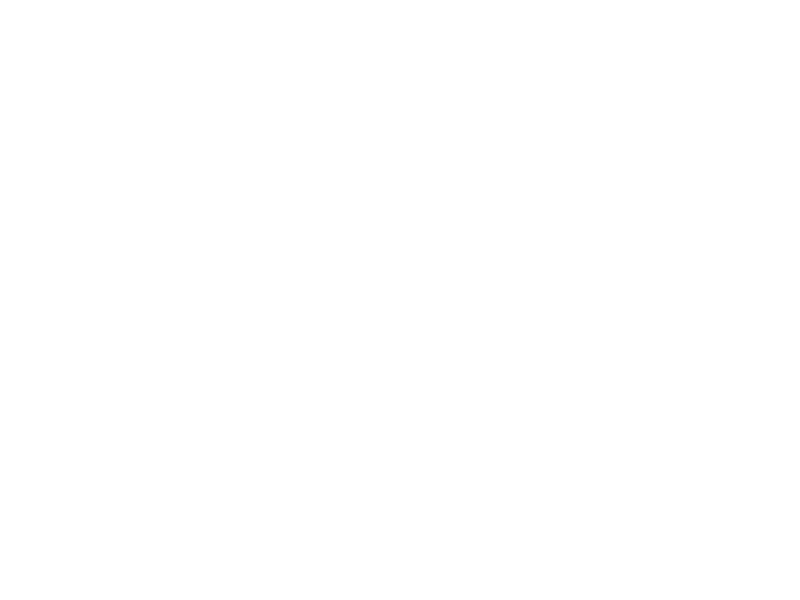

<IPython.core.display.Javascript object>


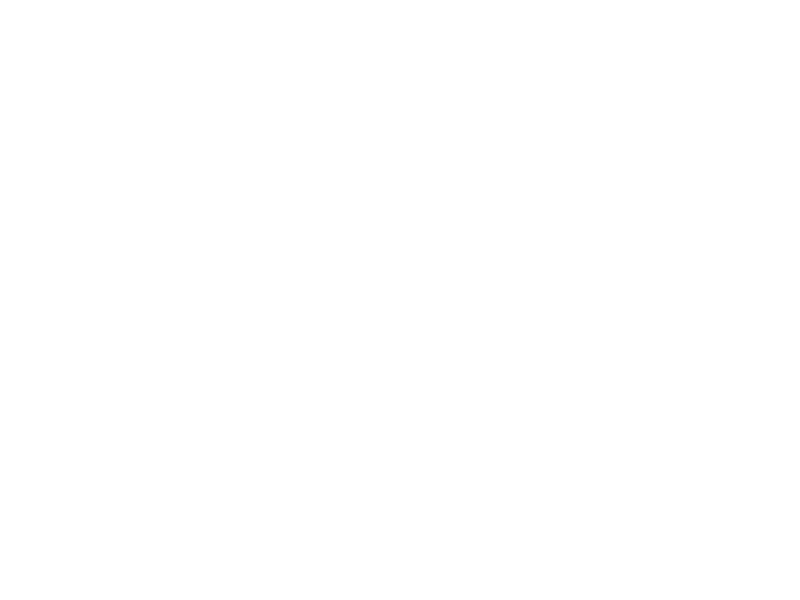

<IPython.core.display.Javascript object>


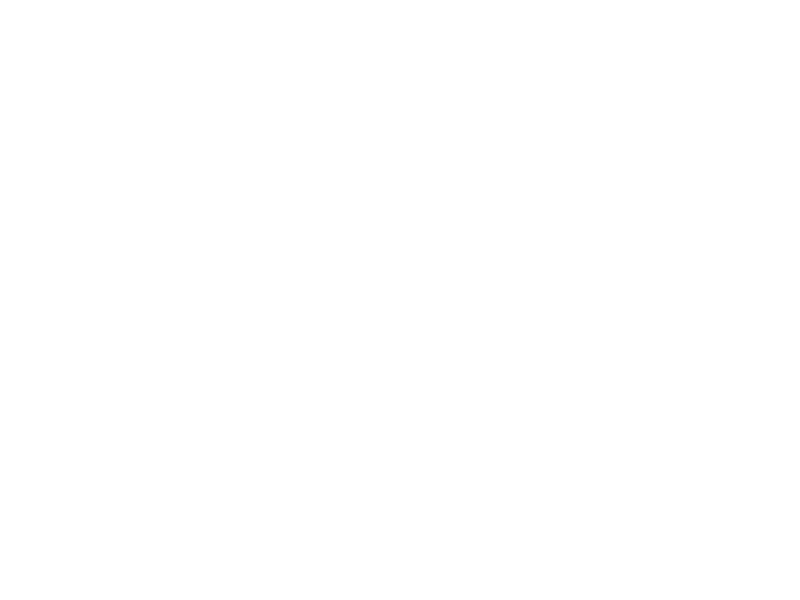

<IPython.core.display.Javascript object>


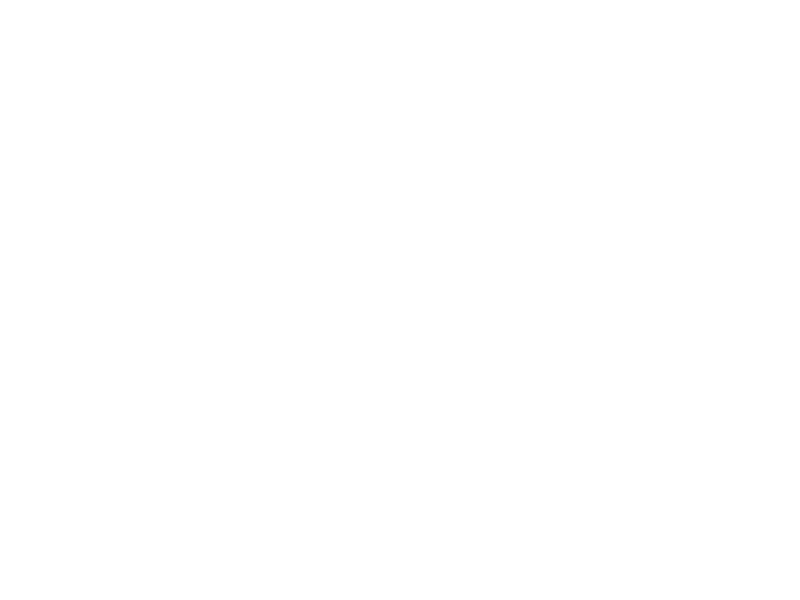

<IPython.core.display.Javascript object>


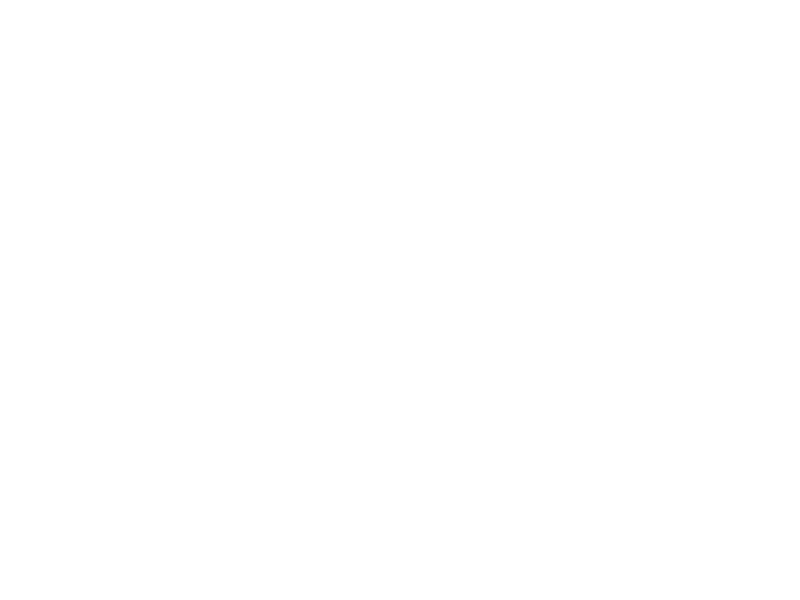

<IPython.core.display.Javascript object>


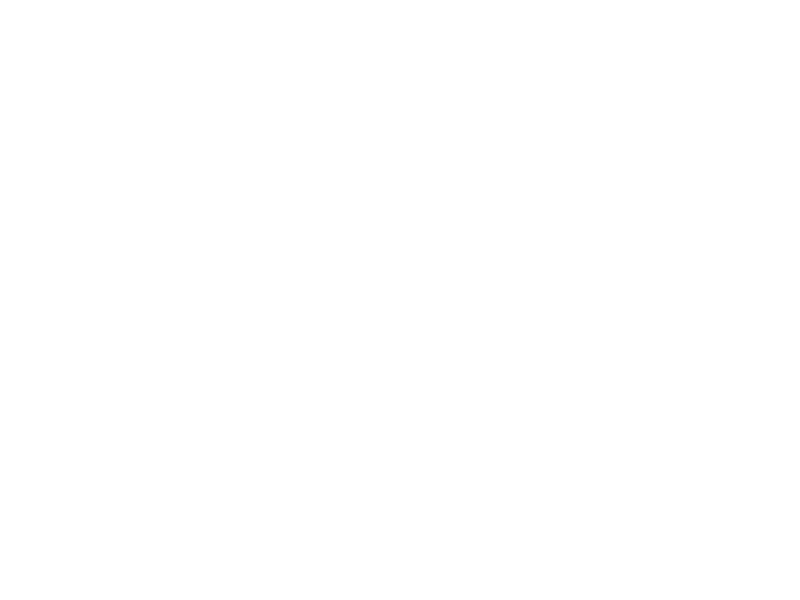

<IPython.core.display.Javascript object>


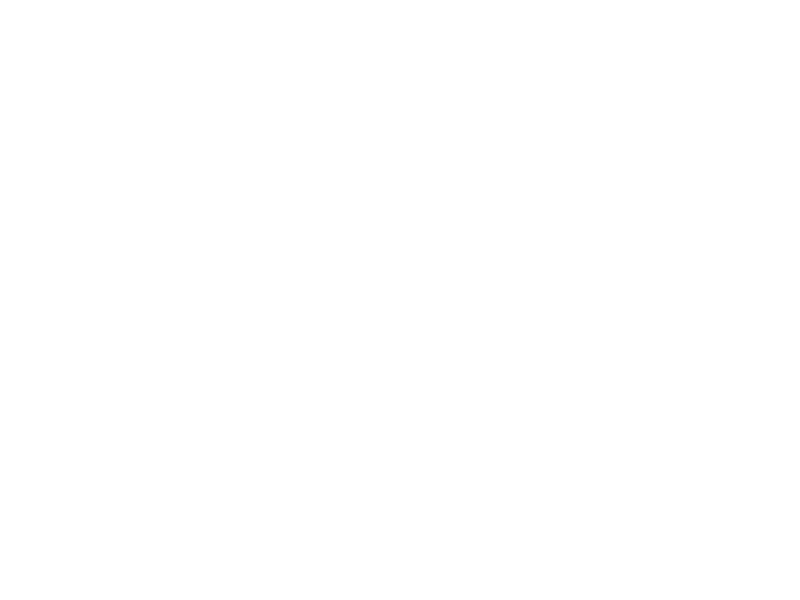

<IPython.core.display.Javascript object>


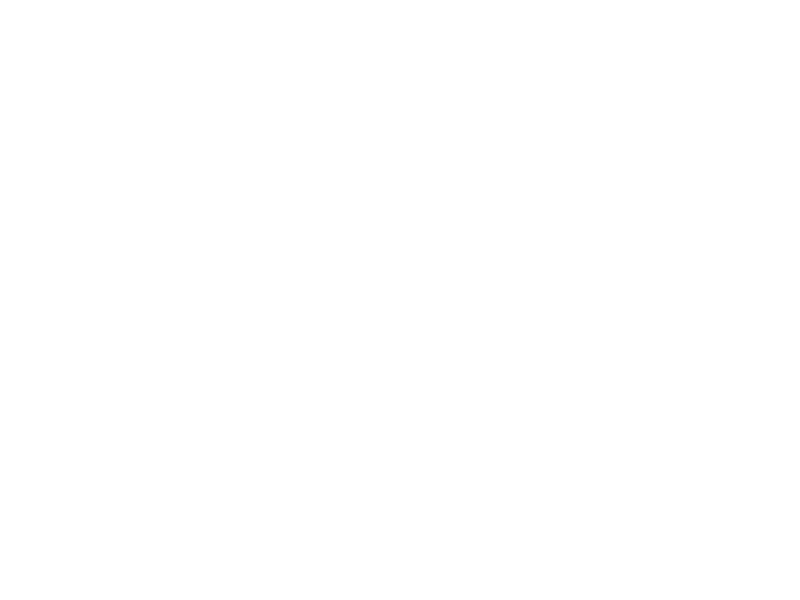

<IPython.core.display.Javascript object>


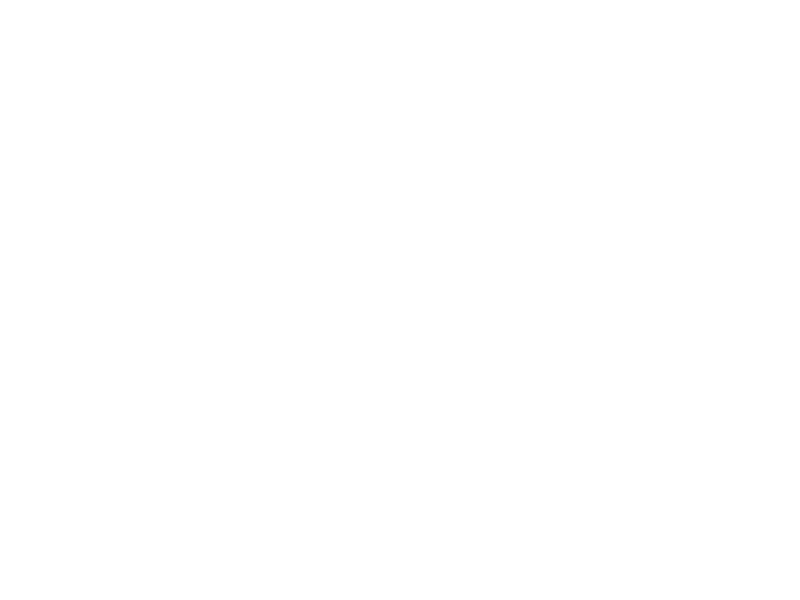

<IPython.core.display.Javascript object>


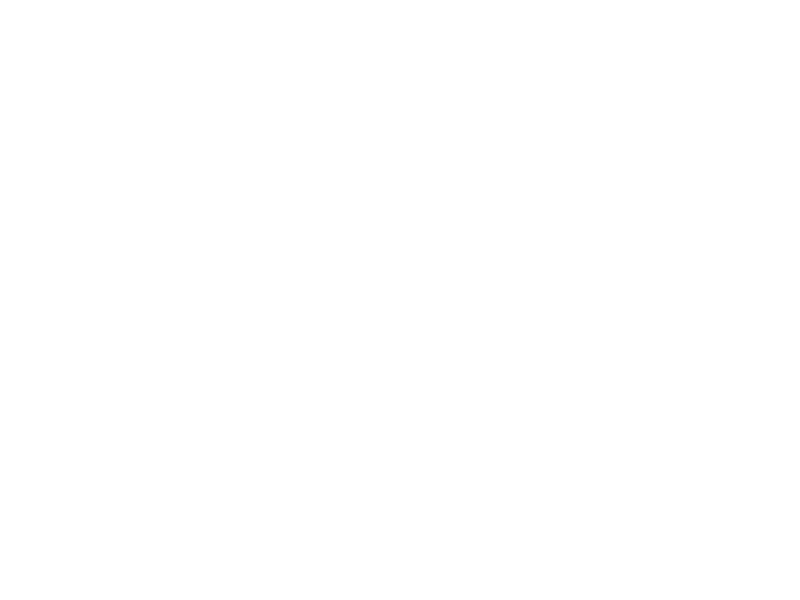

<IPython.core.display.Javascript object>


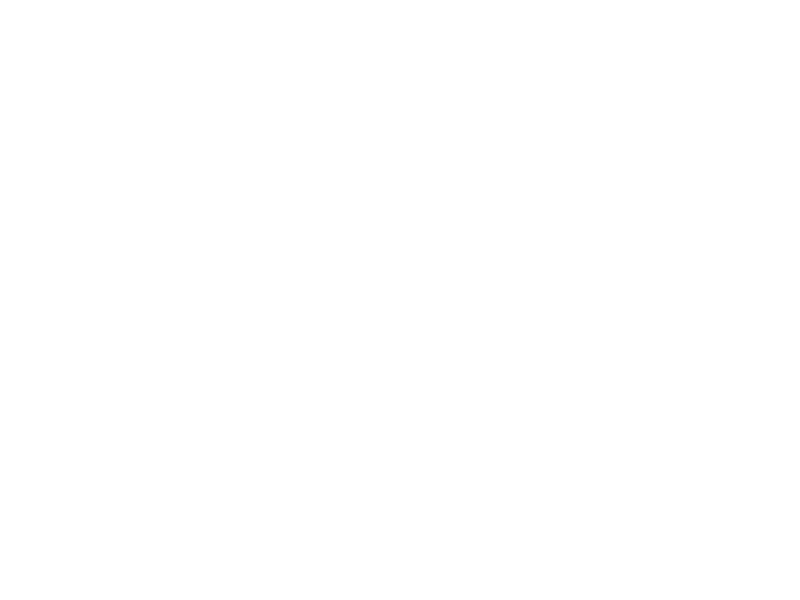

<IPython.core.display.Javascript object>


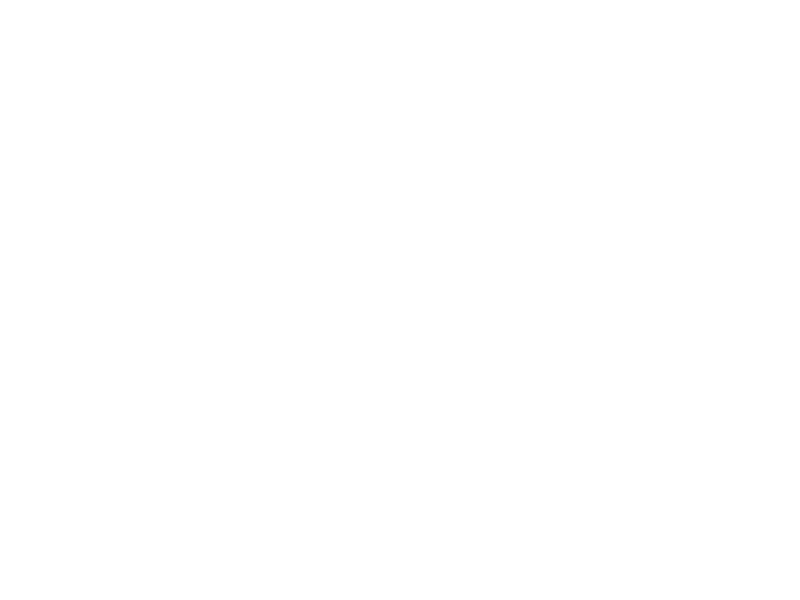

<IPython.core.display.Javascript object>


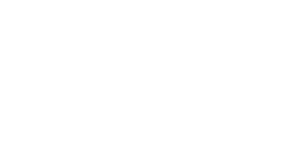

<IPython.core.display.Javascript object>


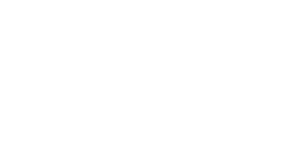

<IPython.core.display.Javascript object>


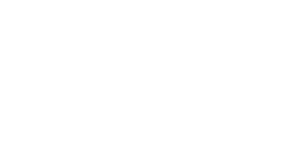

<IPython.core.display.Javascript object>


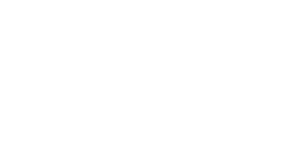

<IPython.core.display.Javascript object>


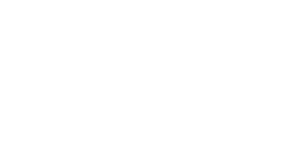

<IPython.core.display.Javascript object>


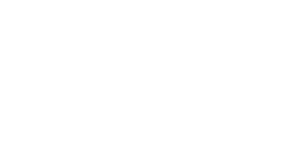

<IPython.core.display.Javascript object>


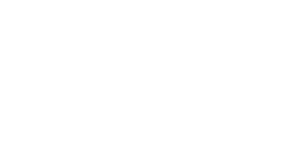

<IPython.core.display.Javascript object>


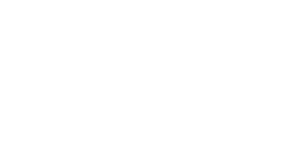

<IPython.core.display.Javascript object>


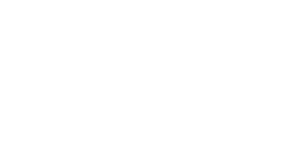

<IPython.core.display.Javascript object>


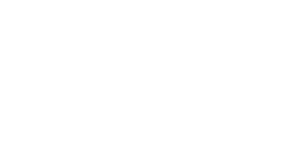

<IPython.core.display.Javascript object>


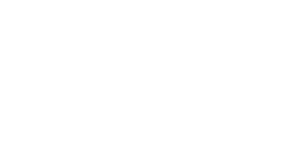

<IPython.core.display.Javascript object>


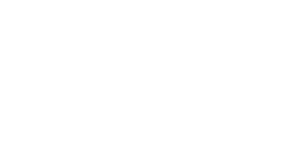

<IPython.core.display.Javascript object>


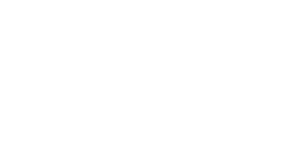

<IPython.core.display.Javascript object>


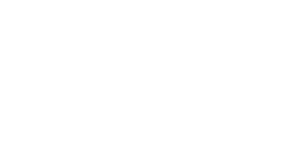

<IPython.core.display.Javascript object>


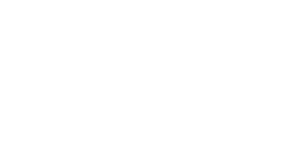

<IPython.core.display.Javascript object>


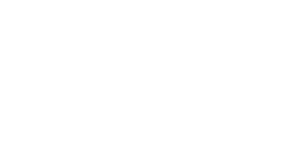

<IPython.core.display.Javascript object>


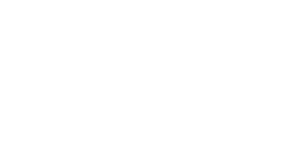

<IPython.core.display.Javascript object>


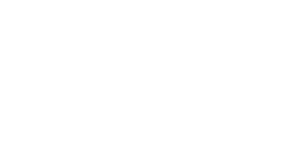

<IPython.core.display.Javascript object>


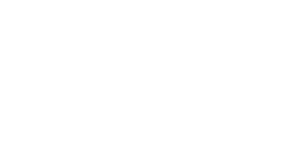

<IPython.core.display.Javascript object>


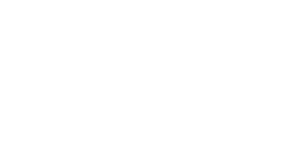

<IPython.core.display.Javascript object>


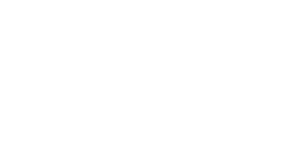

<IPython.core.display.Javascript object>


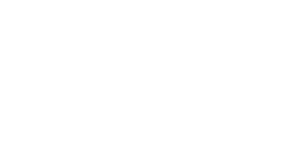

<IPython.core.display.Javascript object>


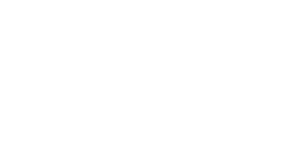

<IPython.core.display.Javascript object>


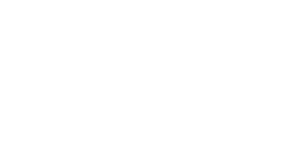

<IPython.core.display.Javascript object>


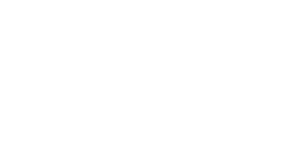

<IPython.core.display.Javascript object>


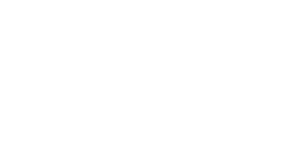

<IPython.core.display.Javascript object>


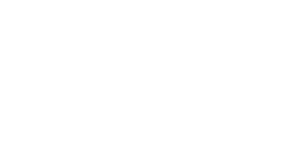

<IPython.core.display.Javascript object>


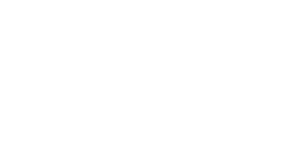

<IPython.core.display.Javascript object>


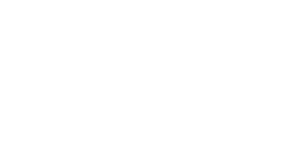

<IPython.core.display.Javascript object>


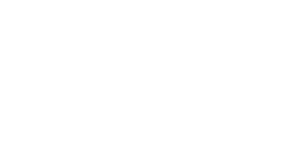

<IPython.core.display.Javascript object>


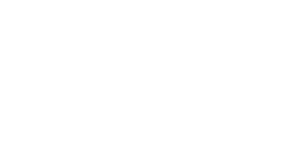

<IPython.core.display.Javascript object>


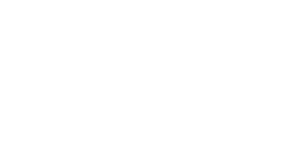

<IPython.core.display.Javascript object>


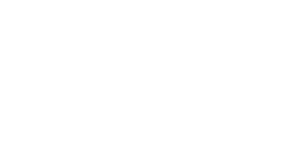

<IPython.core.display.Javascript object>


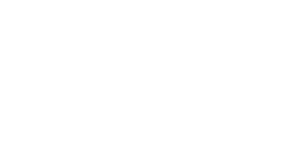

<IPython.core.display.Javascript object>


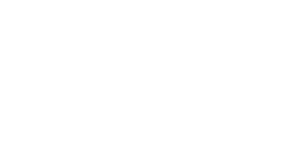

<IPython.core.display.Javascript object>


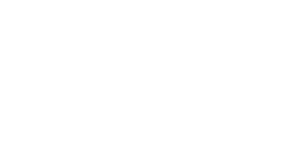

<IPython.core.display.Javascript object>


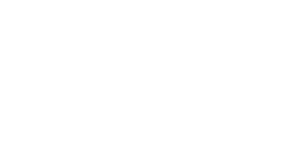

<IPython.core.display.Javascript object>


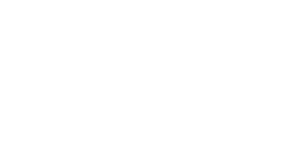

<IPython.core.display.Javascript object>


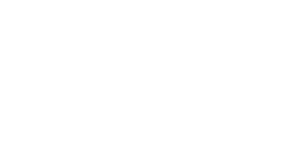

<IPython.core.display.Javascript object>


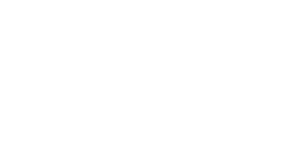

<IPython.core.display.Javascript object>


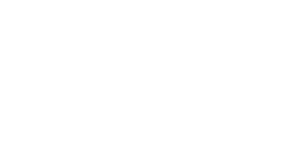

<IPython.core.display.Javascript object>


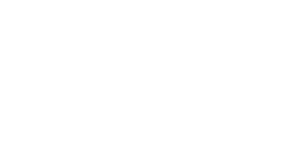

<IPython.core.display.Javascript object>


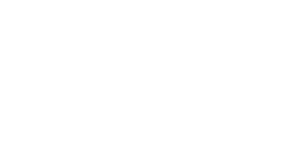

<IPython.core.display.Javascript object>


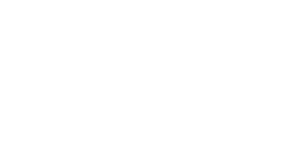

<IPython.core.display.Javascript object>


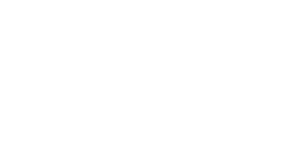

<IPython.core.display.Javascript object>


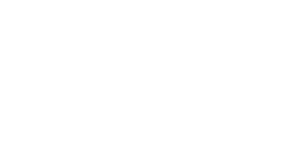

<IPython.core.display.Javascript object>


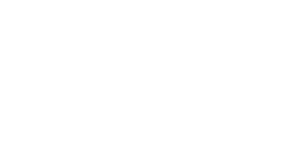

<IPython.core.display.Javascript object>


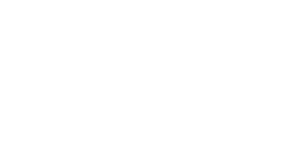

<IPython.core.display.Javascript object>


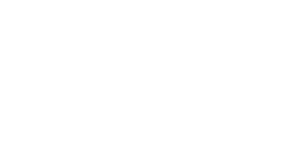

<IPython.core.display.Javascript object>


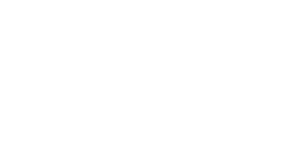

<IPython.core.display.Javascript object>


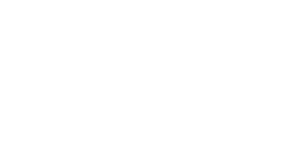

<IPython.core.display.Javascript object>


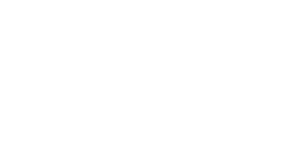

<IPython.core.display.Javascript object>


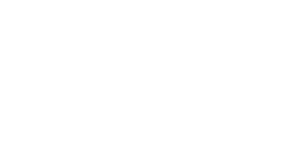

<IPython.core.display.Javascript object>


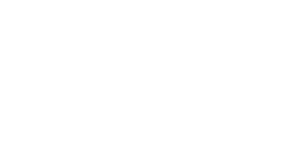

<IPython.core.display.Javascript object>


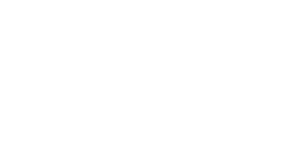

<IPython.core.display.Javascript object>


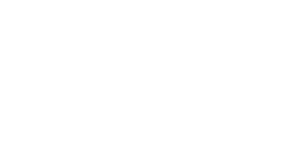

<IPython.core.display.Javascript object>


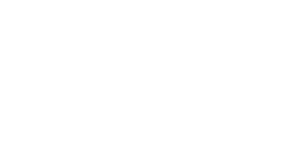

<IPython.core.display.Javascript object>


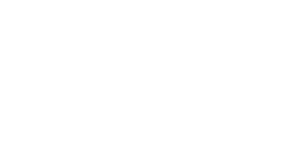

<IPython.core.display.Javascript object>


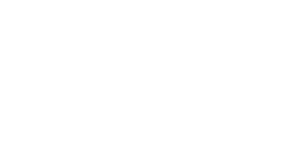

<IPython.core.display.Javascript object>


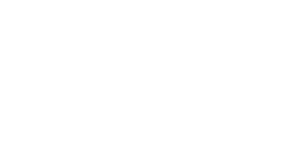

<IPython.core.display.Javascript object>


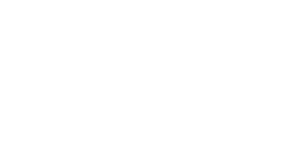

<IPython.core.display.Javascript object>


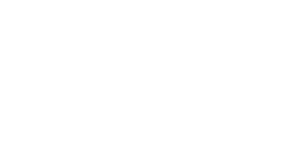

<IPython.core.display.Javascript object>


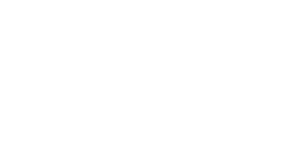

<IPython.core.display.Javascript object>


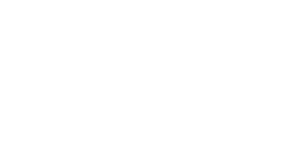

<IPython.core.display.Javascript object>


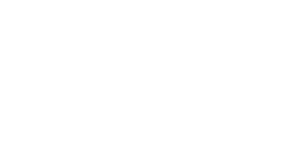

<IPython.core.display.Javascript object>


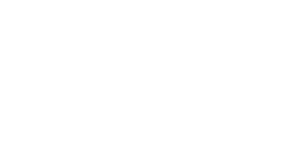

<IPython.core.display.Javascript object>


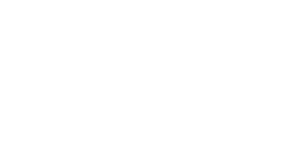

<IPython.core.display.Javascript object>


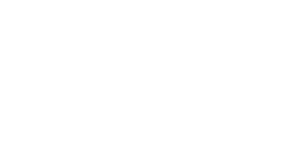

<IPython.core.display.Javascript object>


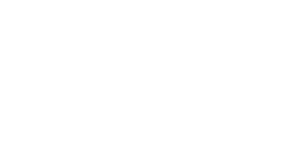

<IPython.core.display.Javascript object>


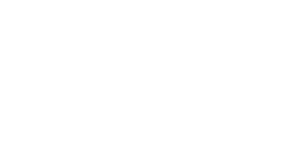

<IPython.core.display.Javascript object>


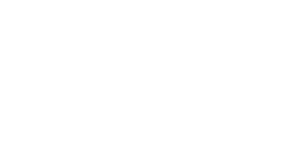

<IPython.core.display.Javascript object>


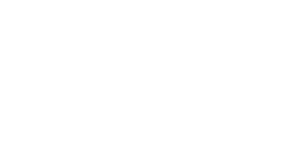

<IPython.core.display.Javascript object>


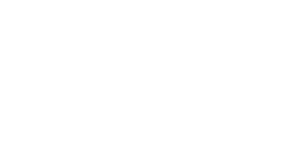

<IPython.core.display.Javascript object>


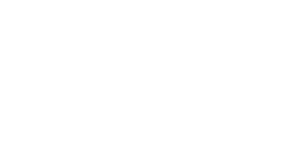

<IPython.core.display.Javascript object>


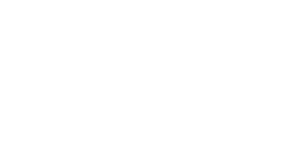

<IPython.core.display.Javascript object>


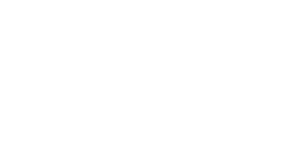

<IPython.core.display.Javascript object>


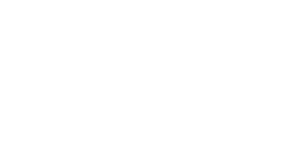

<IPython.core.display.Javascript object>


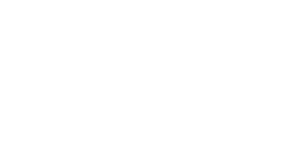

<IPython.core.display.Javascript object>


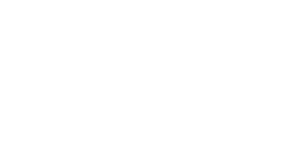

<IPython.core.display.Javascript object>


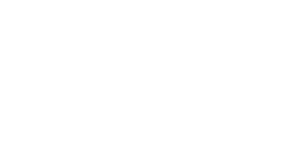

<IPython.core.display.Javascript object>


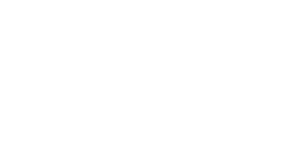

<IPython.core.display.Javascript object>


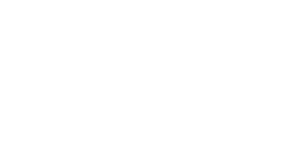

<IPython.core.display.Javascript object>


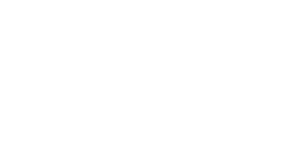

<IPython.core.display.Javascript object>


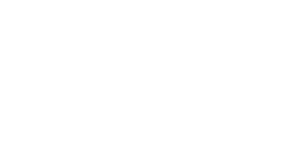

<IPython.core.display.Javascript object>


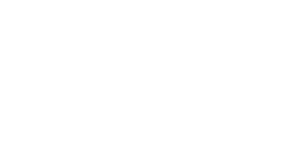

<IPython.core.display.Javascript object>


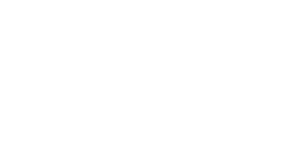

<IPython.core.display.Javascript object>


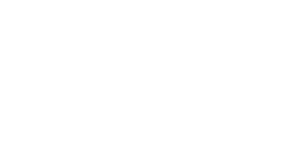

<IPython.core.display.Javascript object>


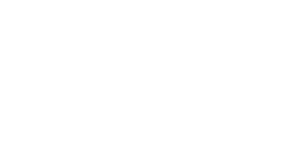

<IPython.core.display.Javascript object>


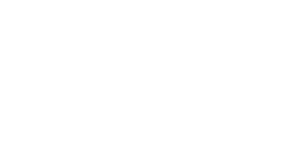

<IPython.core.display.Javascript object>


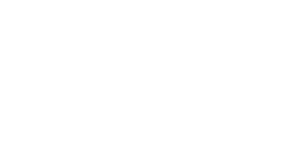

<IPython.core.display.Javascript object>


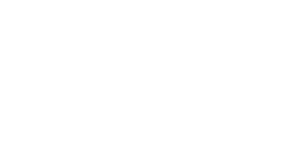

<IPython.core.display.Javascript object>


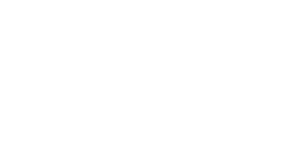

<IPython.core.display.Javascript object>


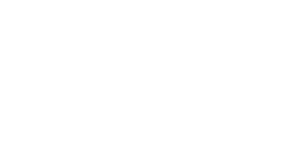

<IPython.core.display.Javascript object>


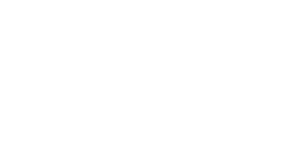

<IPython.core.display.Javascript object>


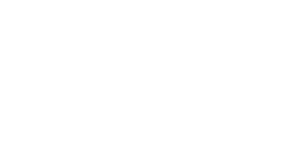

<IPython.core.display.Javascript object>


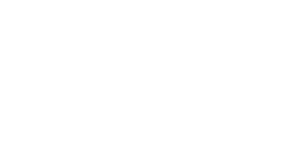

<IPython.core.display.Javascript object>


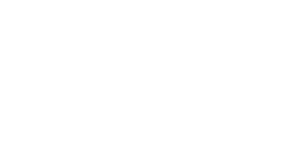

<IPython.core.display.Javascript object>


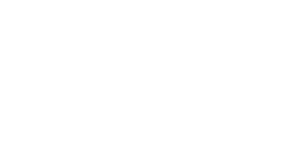

<IPython.core.display.Javascript object>


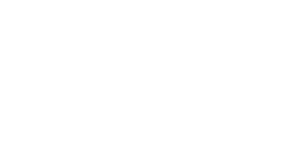

<IPython.core.display.Javascript object>


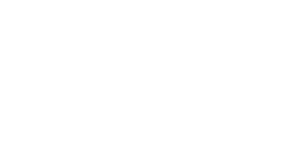

<IPython.core.display.Javascript object>


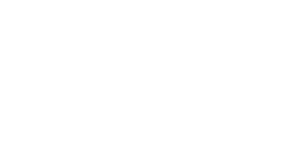

<IPython.core.display.Javascript object>


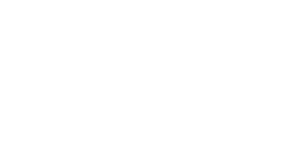

<IPython.core.display.Javascript object>


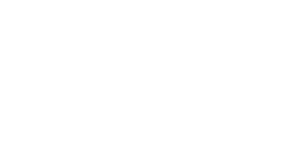

<IPython.core.display.Javascript object>


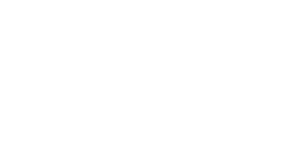

<IPython.core.display.Javascript object>


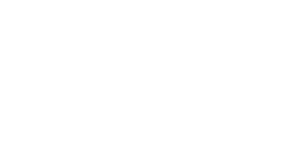

<IPython.core.display.Javascript object>


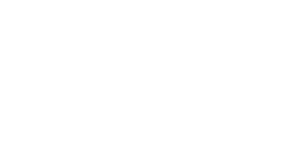

<IPython.core.display.Javascript object>


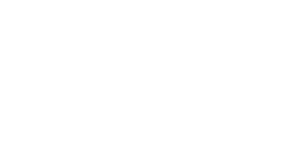

<IPython.core.display.Javascript object>


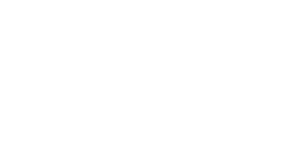

<IPython.core.display.Javascript object>


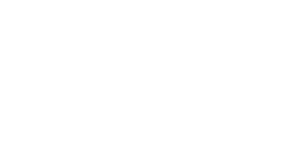

<IPython.core.display.Javascript object>


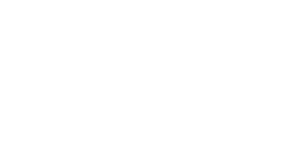

<IPython.core.display.Javascript object>


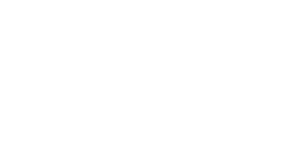

<IPython.core.display.Javascript object>


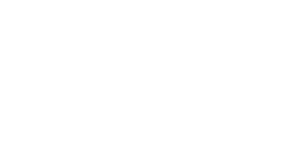

<IPython.core.display.Javascript object>


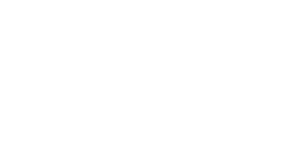

<IPython.core.display.Javascript object>


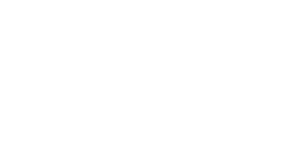

<IPython.core.display.Javascript object>


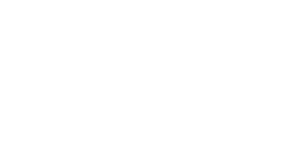

<IPython.core.display.Javascript object>


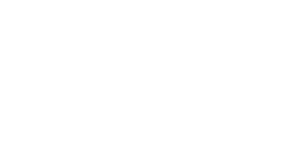

<IPython.core.display.Javascript object>


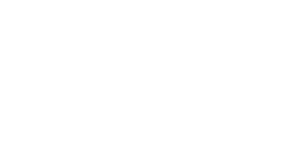

<IPython.core.display.Javascript object>


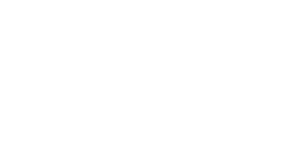

<IPython.core.display.Javascript object>


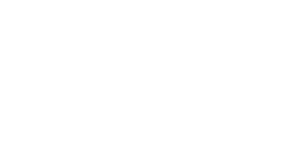

<IPython.core.display.Javascript object>


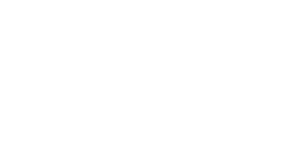

<IPython.core.display.Javascript object>


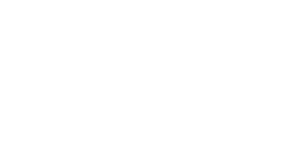

<IPython.core.display.Javascript object>


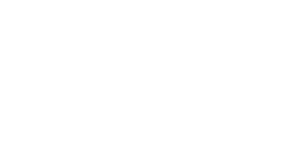

<IPython.core.display.Javascript object>


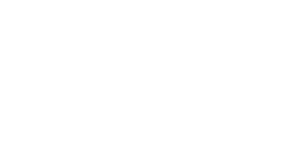

<IPython.core.display.Javascript object>


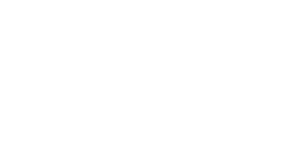

<IPython.core.display.Javascript object>


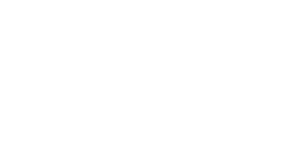

<IPython.core.display.Javascript object>


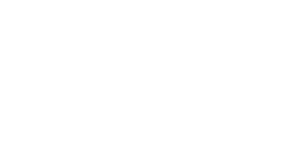

<IPython.core.display.Javascript object>


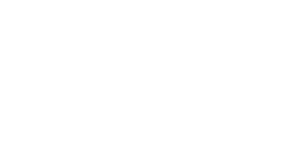

<IPython.core.display.Javascript object>


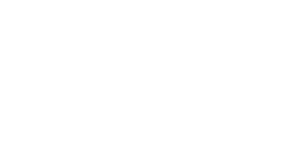

<IPython.core.display.Javascript object>


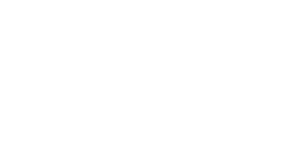

<IPython.core.display.Javascript object>


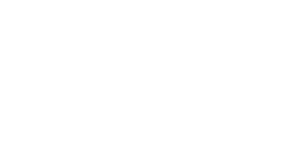

<IPython.core.display.Javascript object>


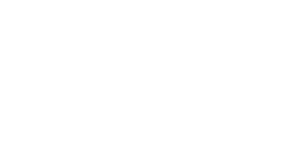

<IPython.core.display.Javascript object>


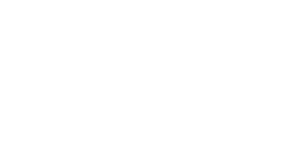

<IPython.core.display.Javascript object>


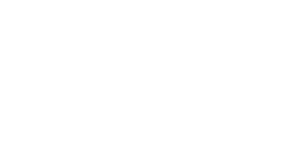

<IPython.core.display.Javascript object>


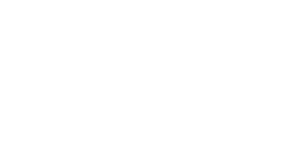

<IPython.core.display.Javascript object>


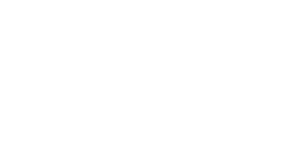

<IPython.core.display.Javascript object>


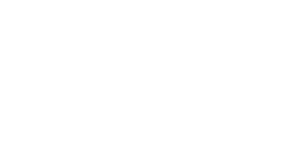

<IPython.core.display.Javascript object>


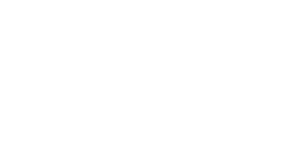

<IPython.core.display.Javascript object>


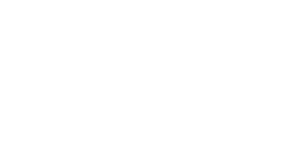

<IPython.core.display.Javascript object>


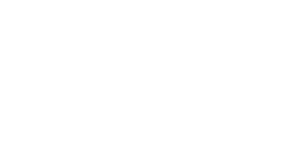

<IPython.core.display.Javascript object>


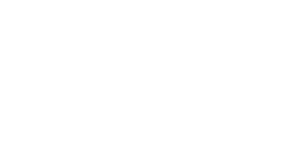

<IPython.core.display.Javascript object>


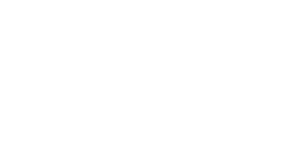

<IPython.core.display.Javascript object>


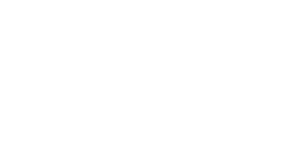

<IPython.core.display.Javascript object>


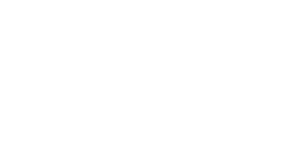

<IPython.core.display.Javascript object>


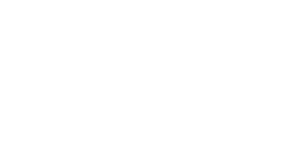

<IPython.core.display.Javascript object>


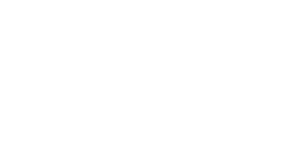

<IPython.core.display.Javascript object>


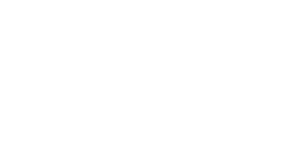

<IPython.core.display.Javascript object>


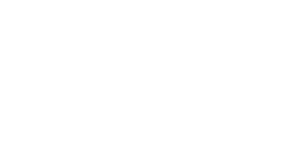

<IPython.core.display.Javascript object>


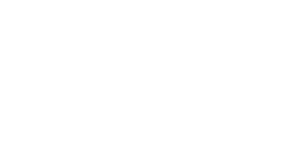

<IPython.core.display.Javascript object>


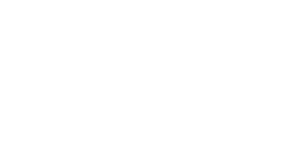

<IPython.core.display.Javascript object>


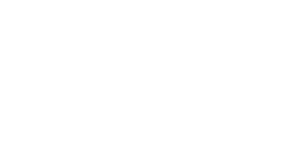

<IPython.core.display.Javascript object>


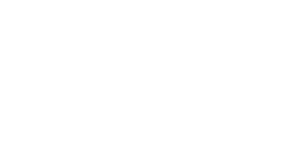

<IPython.core.display.Javascript object>


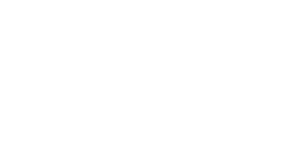

<IPython.core.display.Javascript object>


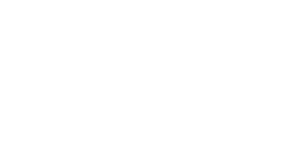

<IPython.core.display.Javascript object>


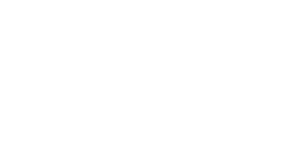

<IPython.core.display.Javascript object>


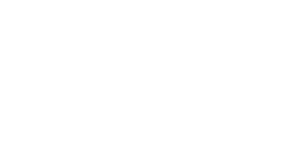

<IPython.core.display.Javascript object>


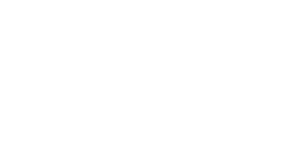

<IPython.core.display.Javascript object>


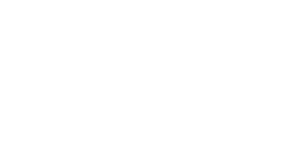

<IPython.core.display.Javascript object>


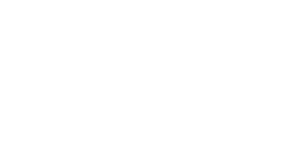

<IPython.core.display.Javascript object>


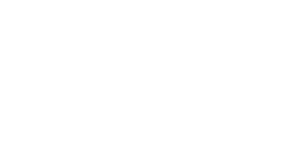

<IPython.core.display.Javascript object>


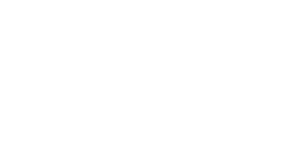

<IPython.core.display.Javascript object>


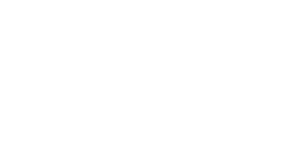

<IPython.core.display.Javascript object>


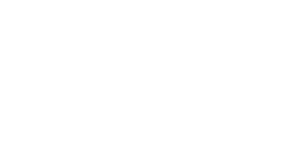

<IPython.core.display.Javascript object>


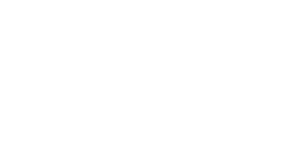

<IPython.core.display.Javascript object>


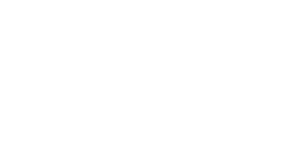

<IPython.core.display.Javascript object>


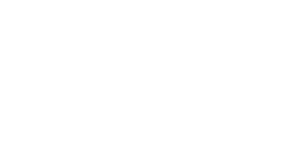

<IPython.core.display.Javascript object>


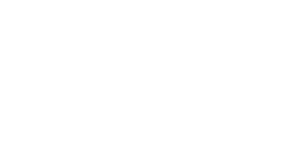

<IPython.core.display.Javascript object>


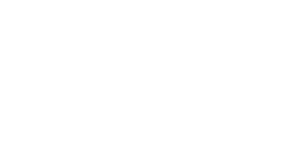

<IPython.core.display.Javascript object>


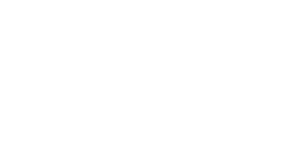

<IPython.core.display.Javascript object>


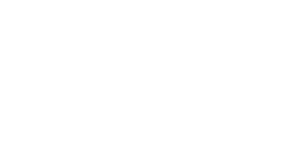

<IPython.core.display.Javascript object>


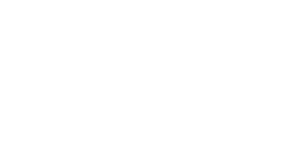

<IPython.core.display.Javascript object>


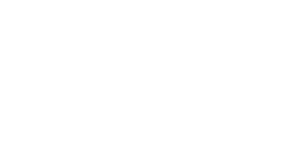

<IPython.core.display.Javascript object>


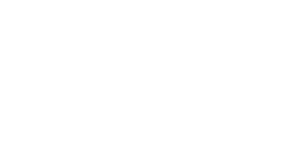

<IPython.core.display.Javascript object>


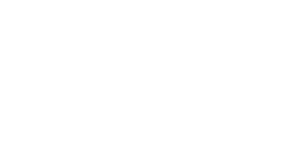

<IPython.core.display.Javascript object>


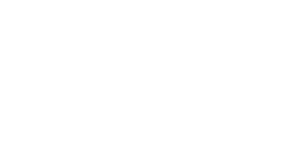

<IPython.core.display.Javascript object>


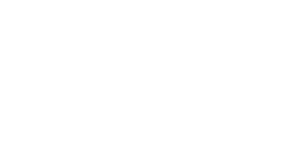

<IPython.core.display.Javascript object>


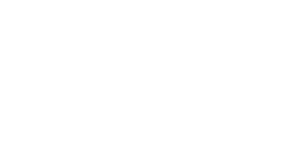

<IPython.core.display.Javascript object>


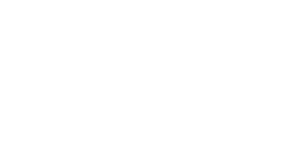

<IPython.core.display.Javascript object>


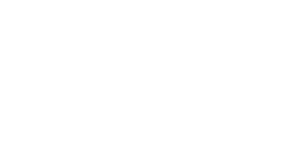

<IPython.core.display.Javascript object>


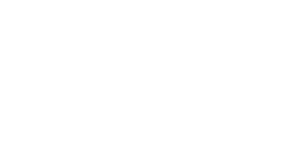

<IPython.core.display.Javascript object>


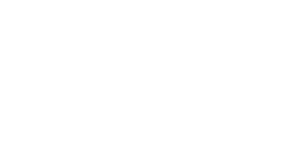

<IPython.core.display.Javascript object>


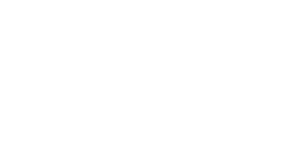

<IPython.core.display.Javascript object>


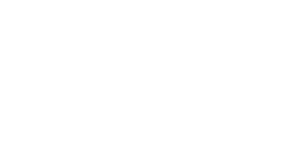

<IPython.core.display.Javascript object>


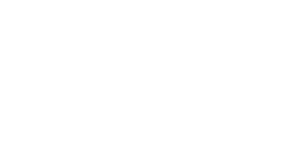

<IPython.core.display.Javascript object>


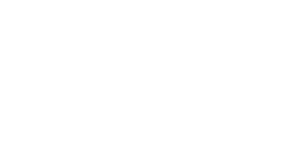

<IPython.core.display.Javascript object>


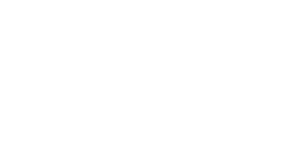

<IPython.core.display.Javascript object>


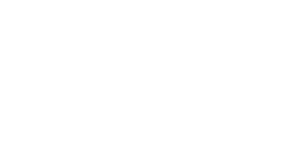

<IPython.core.display.Javascript object>


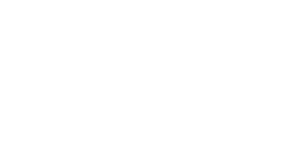

<IPython.core.display.Javascript object>


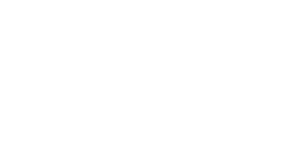

<IPython.core.display.Javascript object>


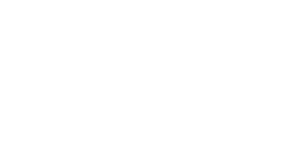

<IPython.core.display.Javascript object>


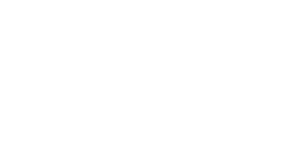

<IPython.core.display.Javascript object>


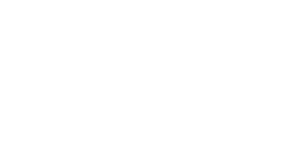

<IPython.core.display.Javascript object>


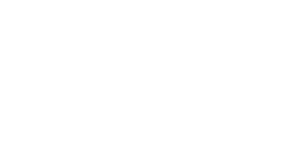

<IPython.core.display.Javascript object>


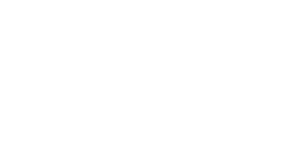

<IPython.core.display.Javascript object>


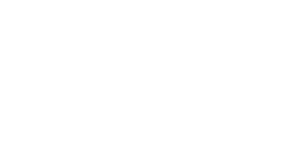

<IPython.core.display.Javascript object>


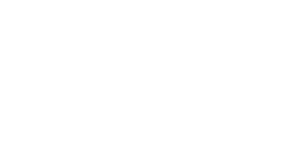

<IPython.core.display.Javascript object>


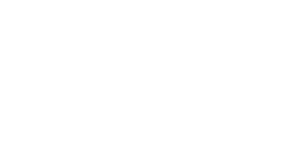

<IPython.core.display.Javascript object>


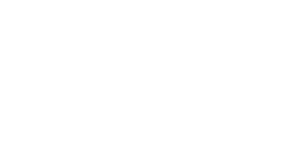

<IPython.core.display.Javascript object>


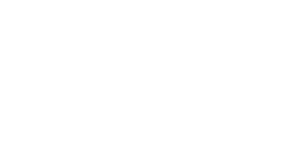

<IPython.core.display.Javascript object>


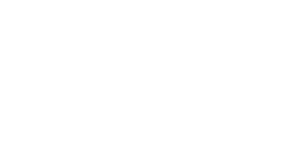

<IPython.core.display.Javascript object>


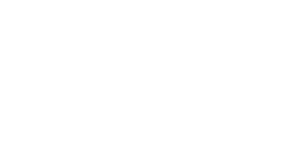

<IPython.core.display.Javascript object>


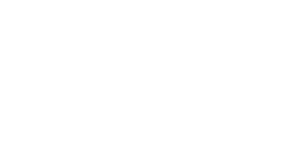

<IPython.core.display.Javascript object>


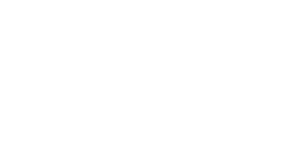

<IPython.core.display.Javascript object>


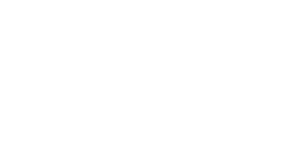

<IPython.core.display.Javascript object>


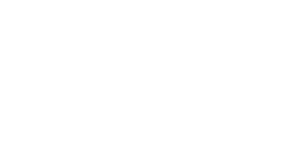

<IPython.core.display.Javascript object>


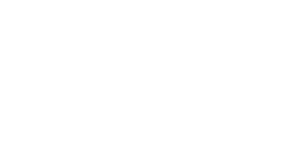

<IPython.core.display.Javascript object>


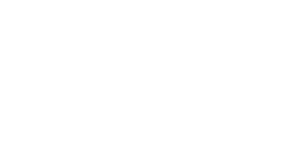

<IPython.core.display.Javascript object>


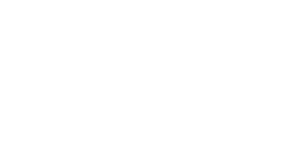

<IPython.core.display.Javascript object>


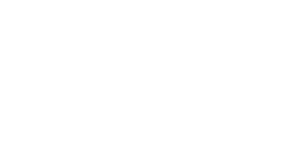

<IPython.core.display.Javascript object>


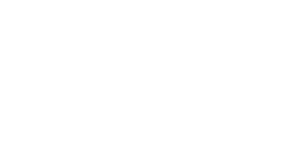

<IPython.core.display.Javascript object>


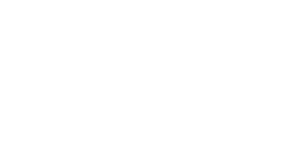

<IPython.core.display.Javascript object>


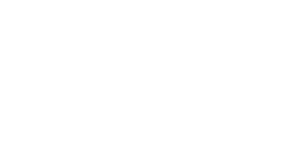

<IPython.core.display.Javascript object>


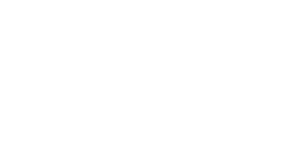

<IPython.core.display.Javascript object>


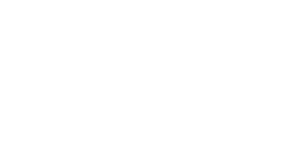

<IPython.core.display.Javascript object>


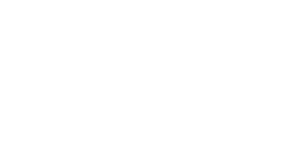

<IPython.core.display.Javascript object>


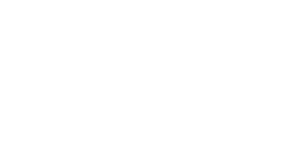

<IPython.core.display.Javascript object>


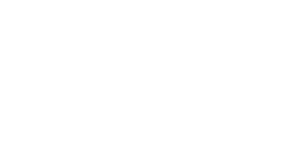

<IPython.core.display.Javascript object>


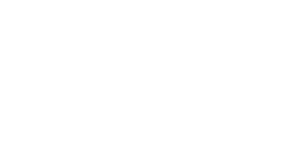

<IPython.core.display.Javascript object>


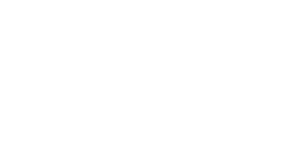

<IPython.core.display.Javascript object>


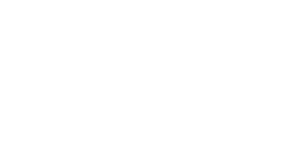

<IPython.core.display.Javascript object>


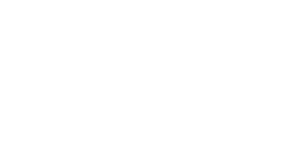

<IPython.core.display.Javascript object>


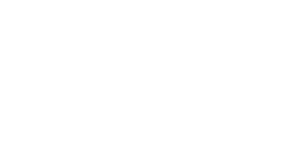

<IPython.core.display.Javascript object>


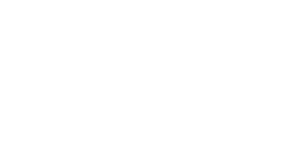

<IPython.core.display.Javascript object>


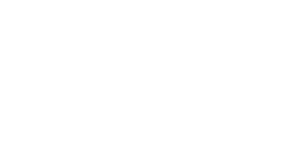

<IPython.core.display.Javascript object>


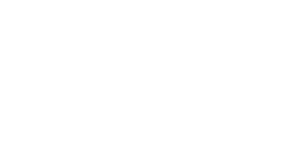

<IPython.core.display.Javascript object>


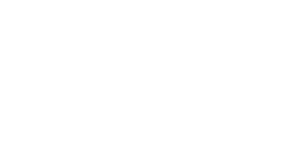

<IPython.core.display.Javascript object>


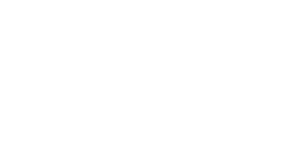

<IPython.core.display.Javascript object>


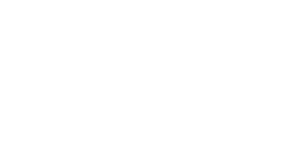

<IPython.core.display.Javascript object>


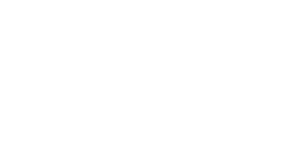

<IPython.core.display.Javascript object>


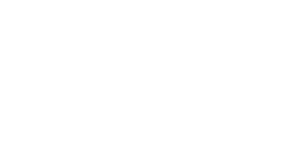

<IPython.core.display.Javascript object>


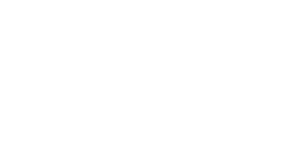

<IPython.core.display.Javascript object>


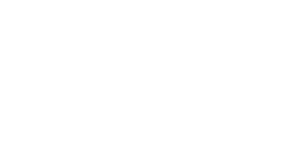

<IPython.core.display.Javascript object>


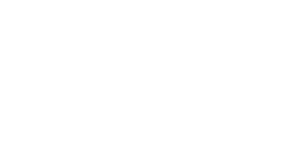

<IPython.core.display.Javascript object>


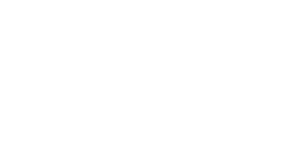

<IPython.core.display.Javascript object>


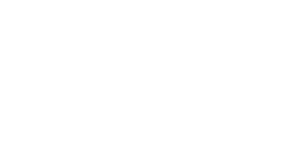

<IPython.core.display.Javascript object>


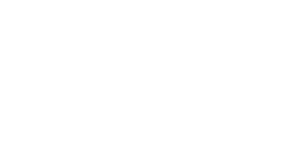

<IPython.core.display.Javascript object>


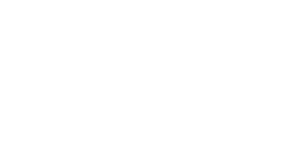

<IPython.core.display.Javascript object>


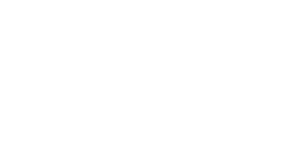

<IPython.core.display.Javascript object>


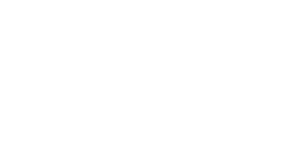

<IPython.core.display.Javascript object>


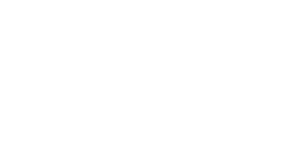

<IPython.core.display.Javascript object>


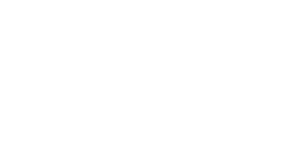

<IPython.core.display.Javascript object>


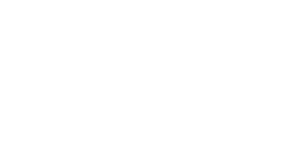

<IPython.core.display.Javascript object>


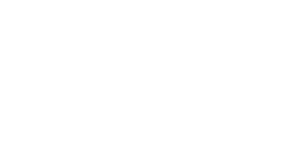

<IPython.core.display.Javascript object>


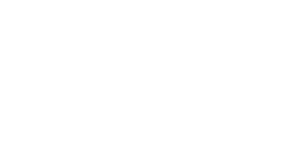

<IPython.core.display.Javascript object>


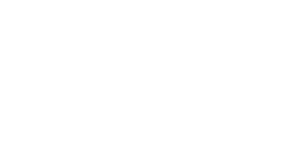

<IPython.core.display.Javascript object>


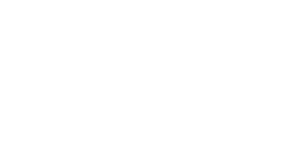

<IPython.core.display.Javascript object>


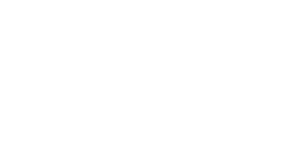

<IPython.core.display.Javascript object>


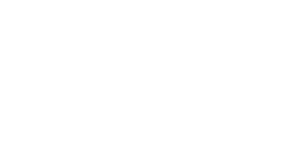

<IPython.core.display.Javascript object>


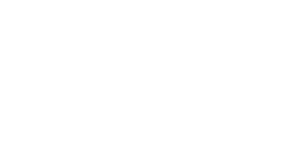

<IPython.core.display.Javascript object>


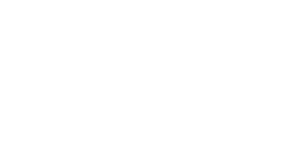

<IPython.core.display.Javascript object>


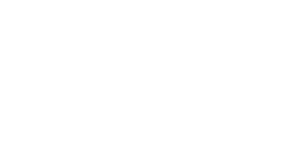

<IPython.core.display.Javascript object>


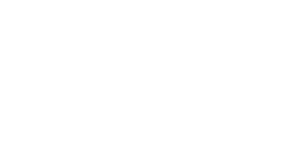

<IPython.core.display.Javascript object>


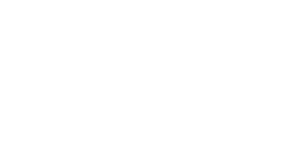

<IPython.core.display.Javascript object>


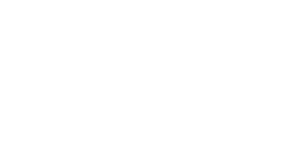

<IPython.core.display.Javascript object>


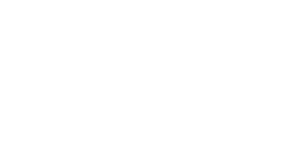

<IPython.core.display.Javascript object>


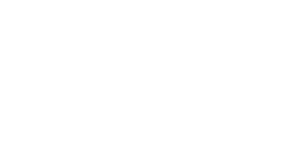

<IPython.core.display.Javascript object>


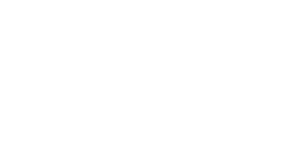

<IPython.core.display.Javascript object>


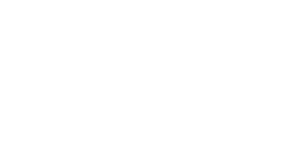

<IPython.core.display.Javascript object>


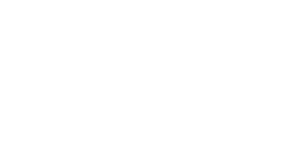

<IPython.core.display.Javascript object>


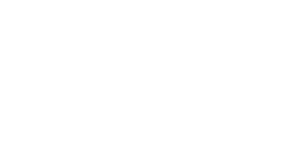

<IPython.core.display.Javascript object>


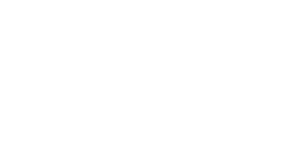

<IPython.core.display.Javascript object>


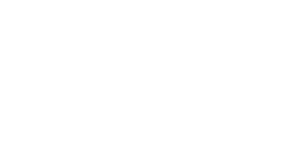

<IPython.core.display.Javascript object>


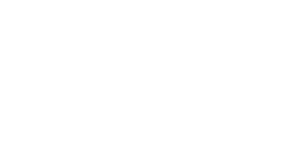

<IPython.core.display.Javascript object>


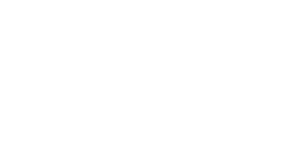

<IPython.core.display.Javascript object>


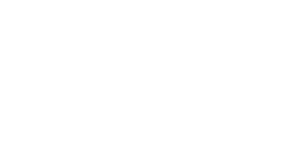

<IPython.core.display.Javascript object>


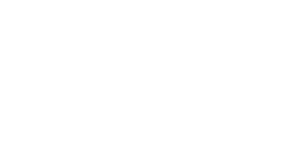

<IPython.core.display.Javascript object>


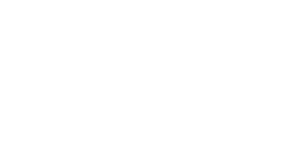

<IPython.core.display.Javascript object>


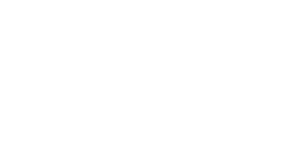

<IPython.core.display.Javascript object>


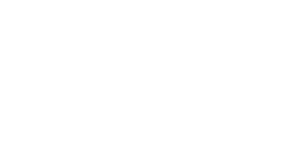

<IPython.core.display.Javascript object>


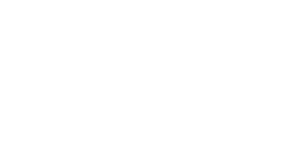

<IPython.core.display.Javascript object>


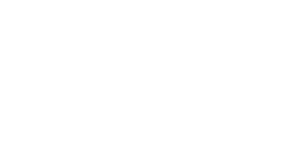

<IPython.core.display.Javascript object>


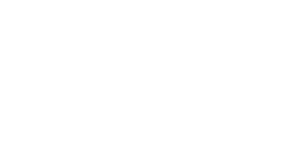

<IPython.core.display.Javascript object>


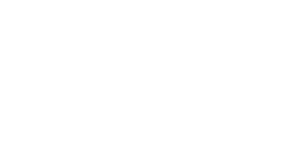

<IPython.core.display.Javascript object>


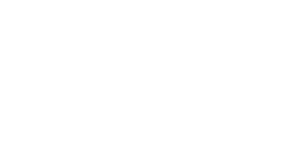

<IPython.core.display.Javascript object>


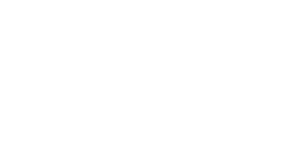

<IPython.core.display.Javascript object>


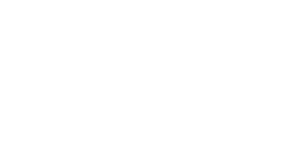

<IPython.core.display.Javascript object>


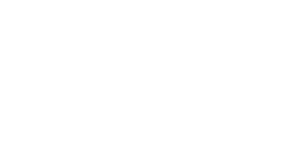

<IPython.core.display.Javascript object>


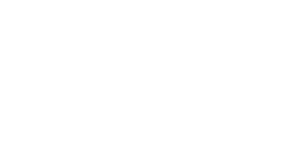

<IPython.core.display.Javascript object>


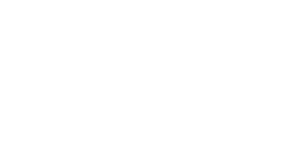

<IPython.core.display.Javascript object>


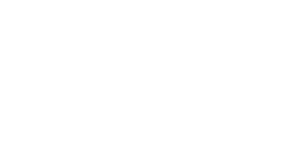

<IPython.core.display.Javascript object>


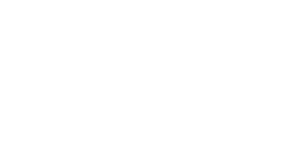

<IPython.core.display.Javascript object>


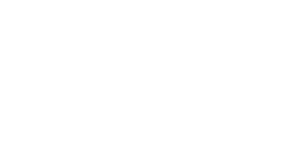

<IPython.core.display.Javascript object>


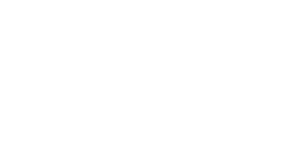

<IPython.core.display.Javascript object>


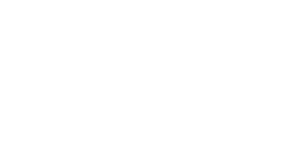

<IPython.core.display.Javascript object>


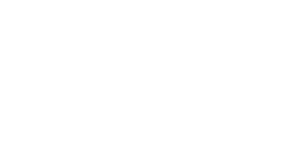

<IPython.core.display.Javascript object>


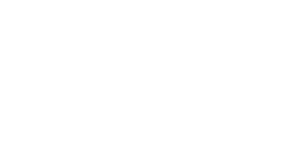

<IPython.core.display.Javascript object>


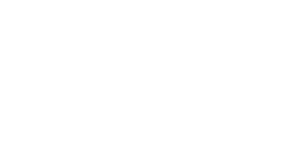

<IPython.core.display.Javascript object>


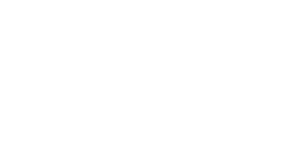

<IPython.core.display.Javascript object>


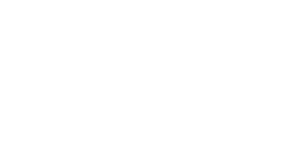

<IPython.core.display.Javascript object>


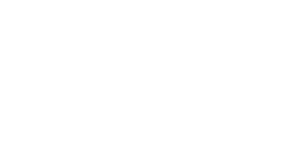

<IPython.core.display.Javascript object>


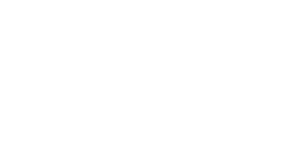

<IPython.core.display.Javascript object>


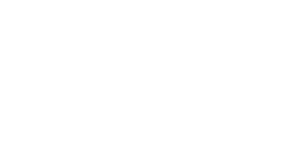

<IPython.core.display.Javascript object>


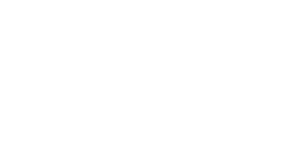

<IPython.core.display.Javascript object>


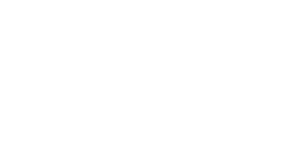

<IPython.core.display.Javascript object>


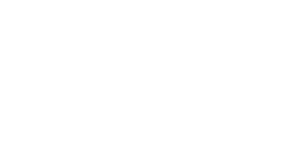

<IPython.core.display.Javascript object>


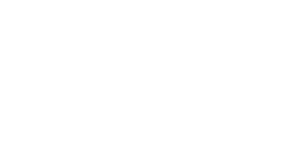

<IPython.core.display.Javascript object>


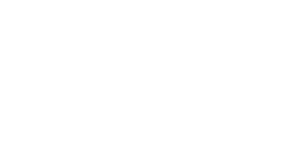

<IPython.core.display.Javascript object>


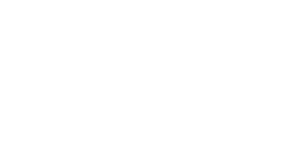

<IPython.core.display.Javascript object>


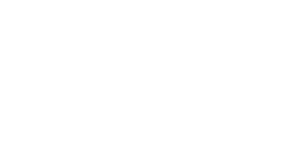

<IPython.core.display.Javascript object>


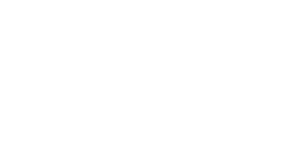

<IPython.core.display.Javascript object>


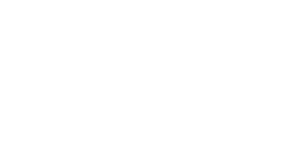

<IPython.core.display.Javascript object>


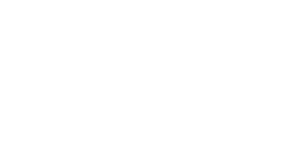

<IPython.core.display.Javascript object>


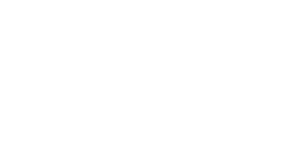

<IPython.core.display.Javascript object>


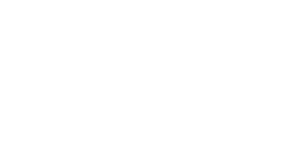

<IPython.core.display.Javascript object>


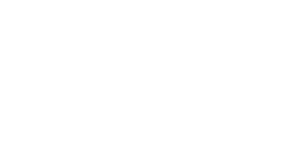

<IPython.core.display.Javascript object>


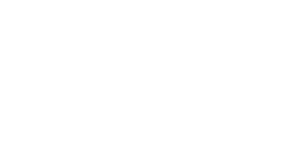

<IPython.core.display.Javascript object>


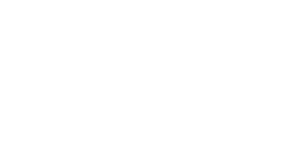

<IPython.core.display.Javascript object>


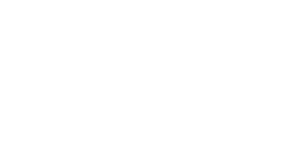

<IPython.core.display.Javascript object>


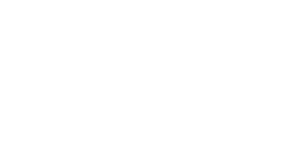

<IPython.core.display.Javascript object>


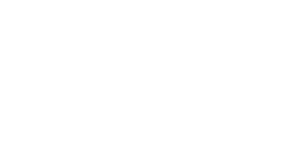

<IPython.core.display.Javascript object>


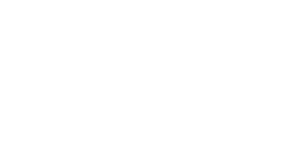

<IPython.core.display.Javascript object>


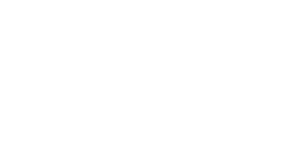

<IPython.core.display.Javascript object>


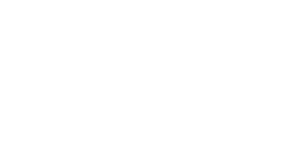

<IPython.core.display.Javascript object>


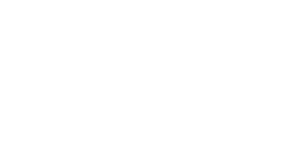

<IPython.core.display.Javascript object>


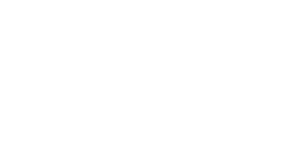

<IPython.core.display.Javascript object>


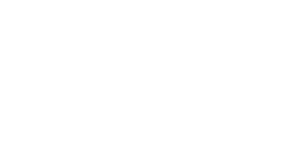

<IPython.core.display.Javascript object>


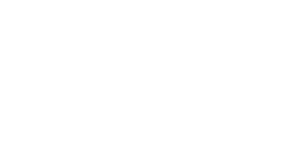

<IPython.core.display.Javascript object>


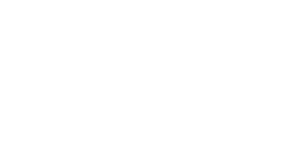

<IPython.core.display.Javascript object>


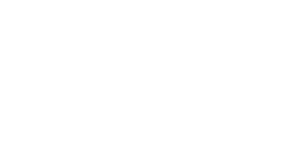

<IPython.core.display.Javascript object>


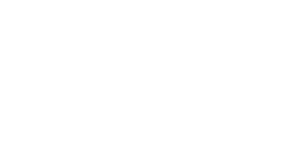

<IPython.core.display.Javascript object>


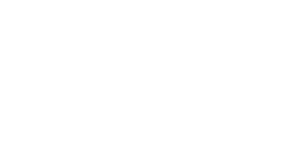

<IPython.core.display.Javascript object>


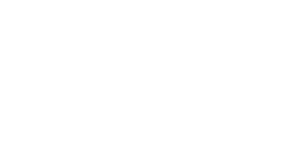

<IPython.core.display.Javascript object>


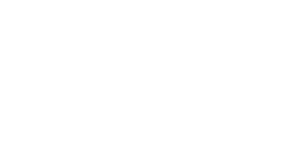

<IPython.core.display.Javascript object>


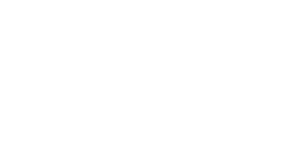

<IPython.core.display.Javascript object>


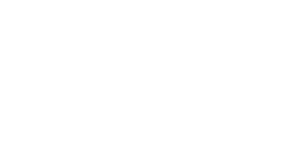

<IPython.core.display.Javascript object>


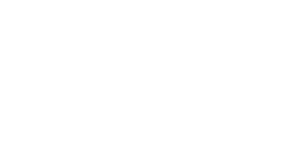

<IPython.core.display.Javascript object>


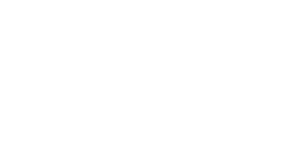

<IPython.core.display.Javascript object>


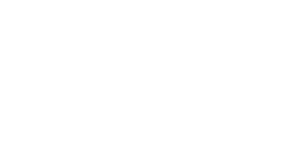

<IPython.core.display.Javascript object>


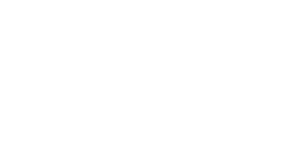

<IPython.core.display.Javascript object>


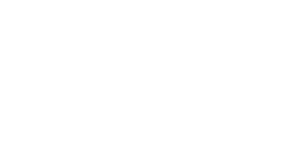

<IPython.core.display.Javascript object>


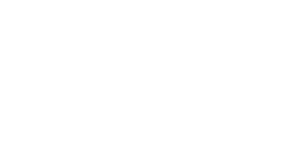

<IPython.core.display.Javascript object>


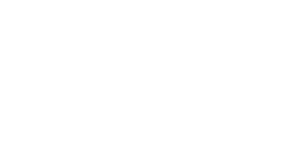

<IPython.core.display.Javascript object>


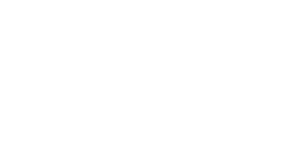

<IPython.core.display.Javascript object>


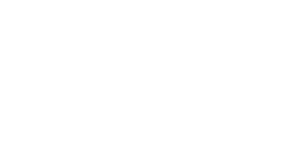

<IPython.core.display.Javascript object>


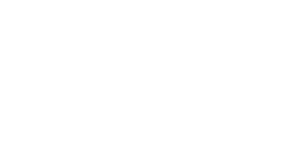

<IPython.core.display.Javascript object>


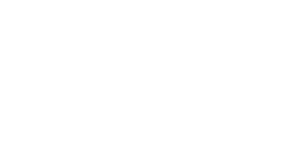

<IPython.core.display.Javascript object>


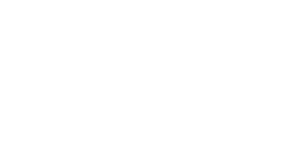

<IPython.core.display.Javascript object>


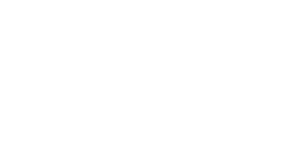

<IPython.core.display.Javascript object>


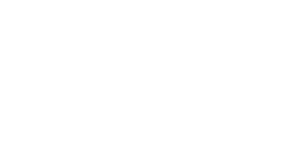

<IPython.core.display.Javascript object>


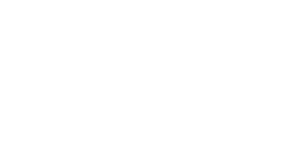

<IPython.core.display.Javascript object>


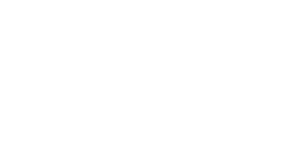

<IPython.core.display.Javascript object>


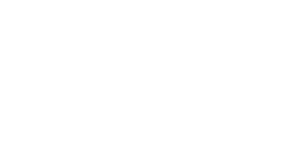

<IPython.core.display.Javascript object>


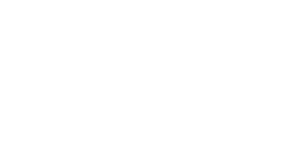

<IPython.core.display.Javascript object>


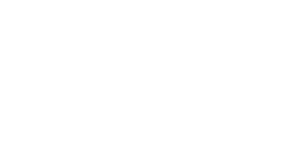

<IPython.core.display.Javascript object>


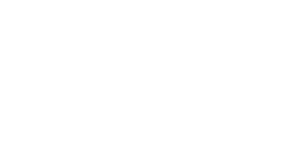

<IPython.core.display.Javascript object>


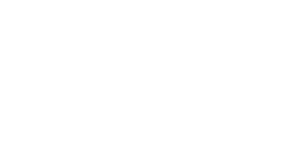

<IPython.core.display.Javascript object>


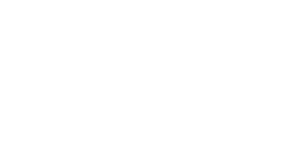

<IPython.core.display.Javascript object>


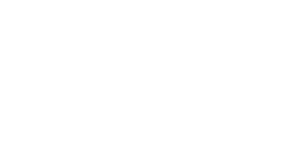

<IPython.core.display.Javascript object>


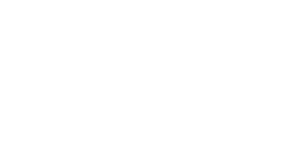

<IPython.core.display.Javascript object>


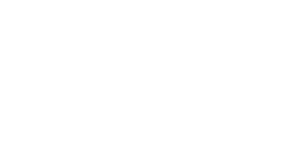

<IPython.core.display.Javascript object>


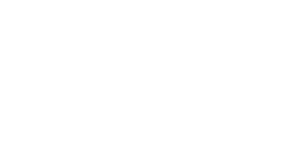

<IPython.core.display.Javascript object>


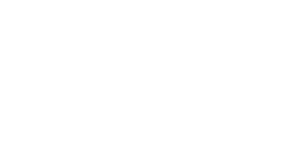

<IPython.core.display.Javascript object>


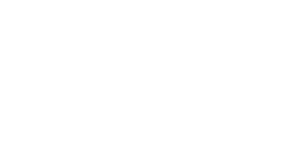

<IPython.core.display.Javascript object>


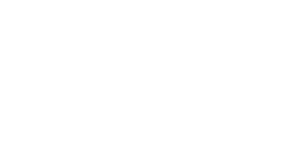

<IPython.core.display.Javascript object>


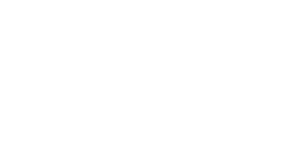

<IPython.core.display.Javascript object>


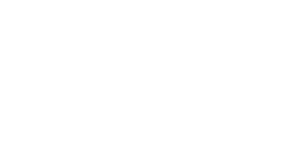

<IPython.core.display.Javascript object>


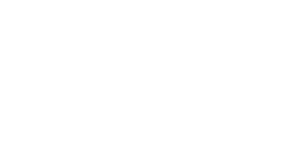

<IPython.core.display.Javascript object>


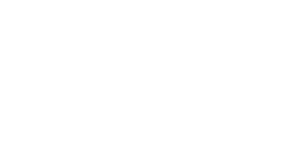

<IPython.core.display.Javascript object>


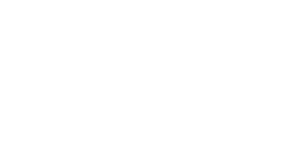

<IPython.core.display.Javascript object>


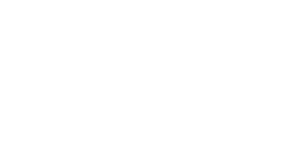

<IPython.core.display.Javascript object>


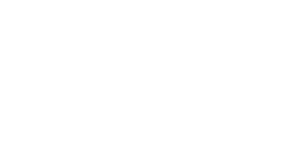

<IPython.core.display.Javascript object>


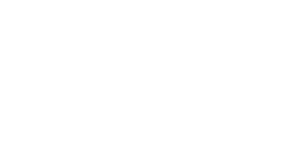

<IPython.core.display.Javascript object>


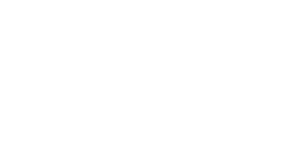

<IPython.core.display.Javascript object>


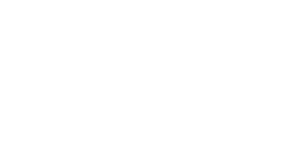

<IPython.core.display.Javascript object>


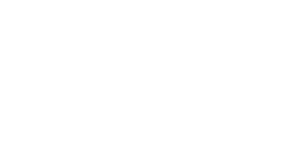

<IPython.core.display.Javascript object>


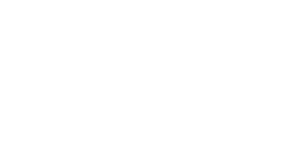

<IPython.core.display.Javascript object>


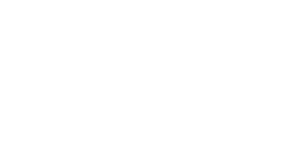

<IPython.core.display.Javascript object>


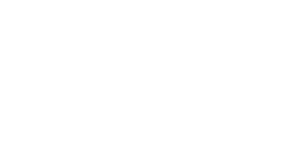

<IPython.core.display.Javascript object>


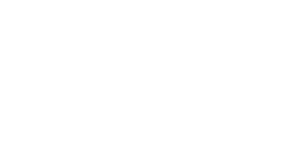

<IPython.core.display.Javascript object>


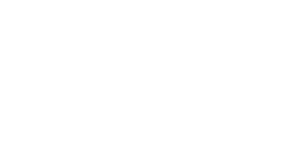

<IPython.core.display.Javascript object>


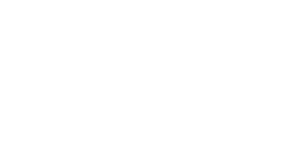

<IPython.core.display.Javascript object>


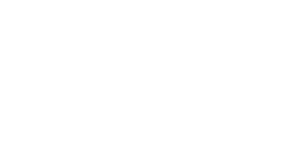

<IPython.core.display.Javascript object>


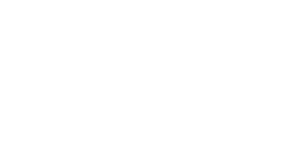

<IPython.core.display.Javascript object>


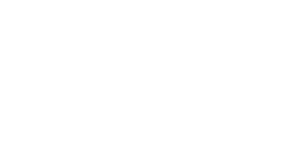

<IPython.core.display.Javascript object>


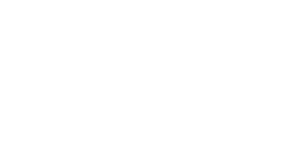

<IPython.core.display.Javascript object>


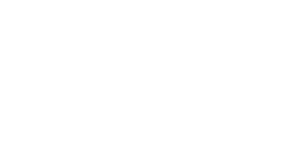

<IPython.core.display.Javascript object>


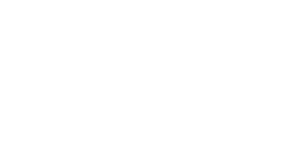

<IPython.core.display.Javascript object>


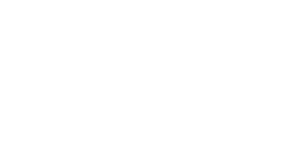

<IPython.core.display.Javascript object>


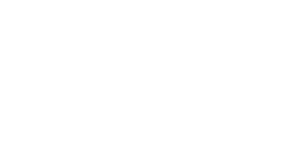

<IPython.core.display.Javascript object>


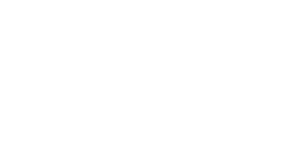

<IPython.core.display.Javascript object>


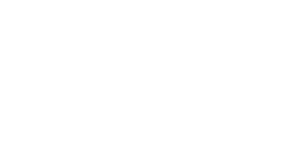

<IPython.core.display.Javascript object>


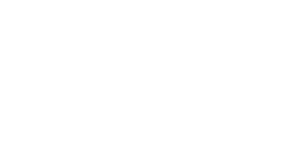

<IPython.core.display.Javascript object>


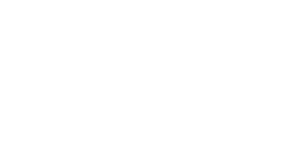

<IPython.core.display.Javascript object>


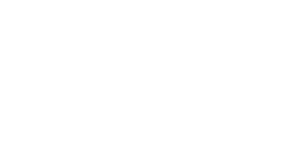

<IPython.core.display.Javascript object>


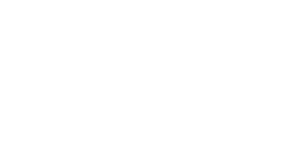

<IPython.core.display.Javascript object>


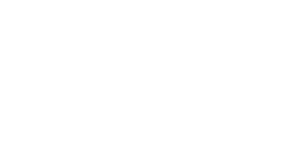

<IPython.core.display.Javascript object>


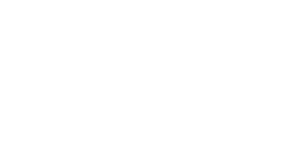

<IPython.core.display.Javascript object>


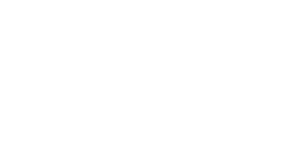

<IPython.core.display.Javascript object>


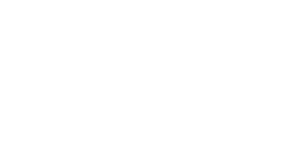

<IPython.core.display.Javascript object>


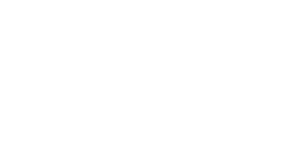

<IPython.core.display.Javascript object>


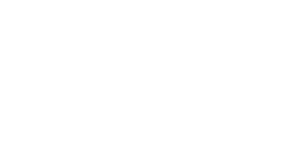

<IPython.core.display.Javascript object>


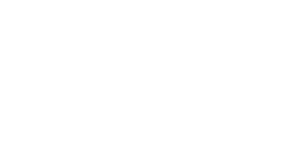

<IPython.core.display.Javascript object>


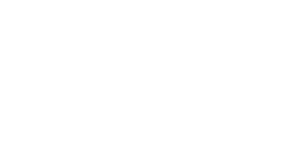

<IPython.core.display.Javascript object>


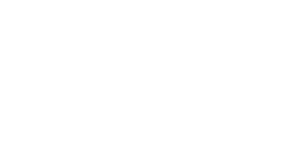

<IPython.core.display.Javascript object>


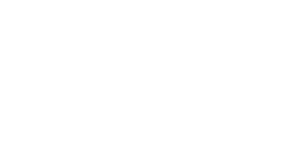

<IPython.core.display.Javascript object>


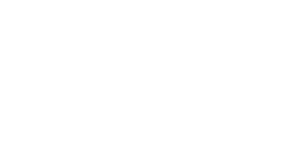

<IPython.core.display.Javascript object>


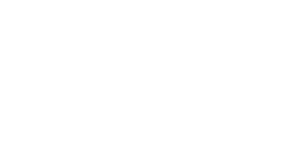

<IPython.core.display.Javascript object>


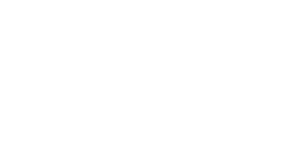

<IPython.core.display.Javascript object>


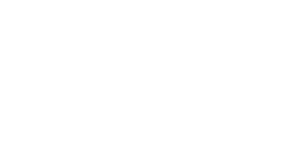

<IPython.core.display.Javascript object>


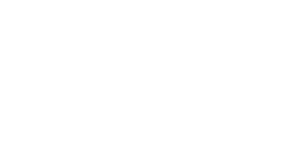

<IPython.core.display.Javascript object>


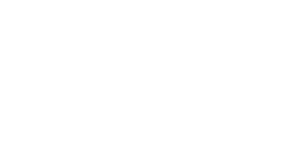

<IPython.core.display.Javascript object>


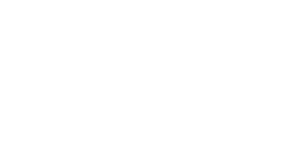

<IPython.core.display.Javascript object>


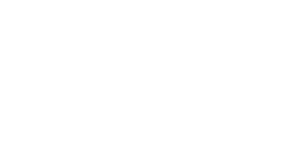

<IPython.core.display.Javascript object>


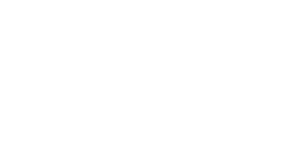

<IPython.core.display.Javascript object>


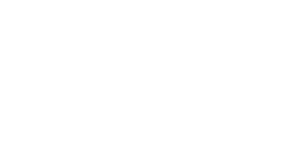

<IPython.core.display.Javascript object>


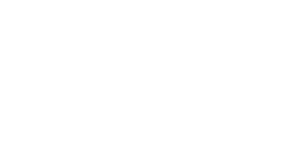

<IPython.core.display.Javascript object>


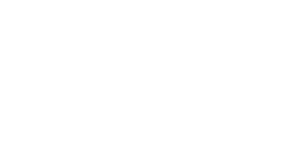

<IPython.core.display.Javascript object>


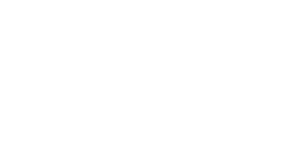

<IPython.core.display.Javascript object>


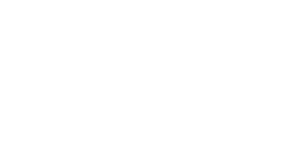

<IPython.core.display.Javascript object>


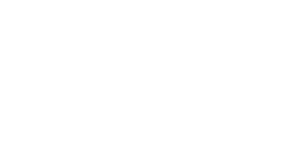

<IPython.core.display.Javascript object>


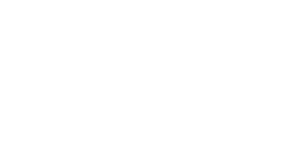

<IPython.core.display.Javascript object>


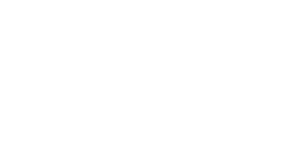

In [121]:
# Guardamos los histogramas como imagenes
# Al nombre se agrega primero el numero de cluster al que pertenece
# y despues el numero de corrida
for i in range(nclusters + 1):
    for j in corrxclus[i]:
        if j < 10:
            nombre = str(i) + 'Corrida00' + str(j)
        elif j < 100:
            nombre = str(i) + 'Corrida0' + str(j)
        else:
            nombre = str(i) + 'Corrida' + str(j)
        plt.figure()
        plt.ylim(0, 100)
        plt.bar(range(-5,7), histos[j-1][1:13])
        plt.suptitle(nombre)
        plt.savefig(nombre + '.png', dpi=100)
        plt.close()

In [29]:
archivo = open("Ternas.dat", "w")
for i in range(nclusters + 1):
    archivo.write("Corridas en cluster " + str(i) + ",," + "\n")
    archivo.write("vis, test, exig\n")
    for j in corrxclus[i]:
        archivo.write(str(ternas[j-1,1]) + "," + str(ternas[j-1,2]) + "," + str(ternas[j-1,3]) +"\n")
archivo.close()

<IPython.core.display.Javascript object>


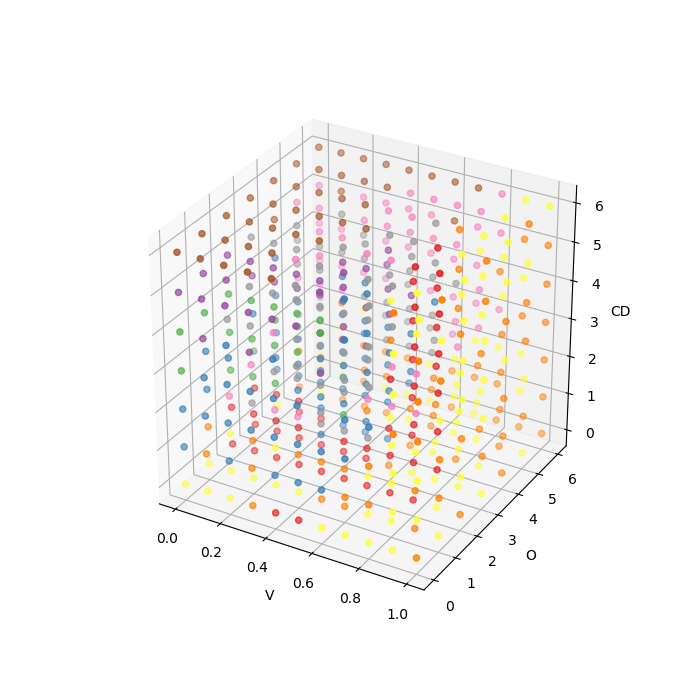

Text(0.5, 0, 'CD')

In [30]:
terxclus = np.zeros((539,5))
for i in range(nclusters + 1):
    for j in corrxclus[i]:
        terxclus[j-1] = [j, i, ternas[j-1,1], ternas[j-1,2], ternas[j-1,3]]
plt.figure('Ternas en cada cluster', figsize=(7,7))
ax = plt.axes(projection = '3d')
ax.scatter(terxclus[:,2], terxclus[:, 3], terxclus[:, 4], c=terxclus[:, 1], cmap='Set1')
ax.set_xlabel('V')
ax.set_ylabel('O')
ax.set_zlabel('CD')

<IPython.core.display.Javascript object>


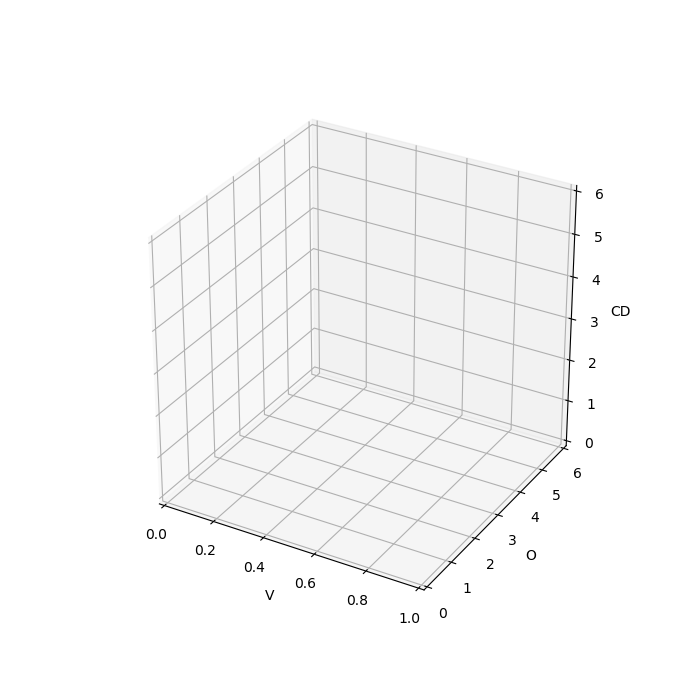

<IPython.core.display.Javascript object>


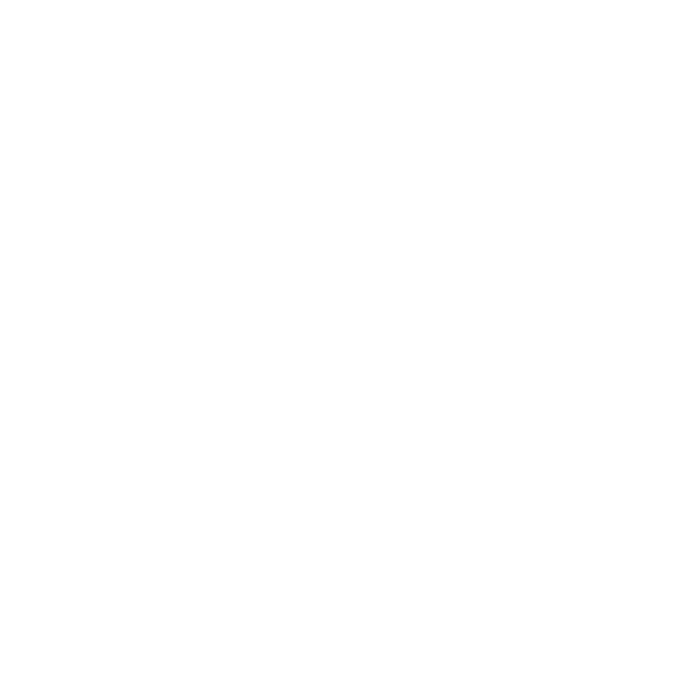

<IPython.core.display.Javascript object>


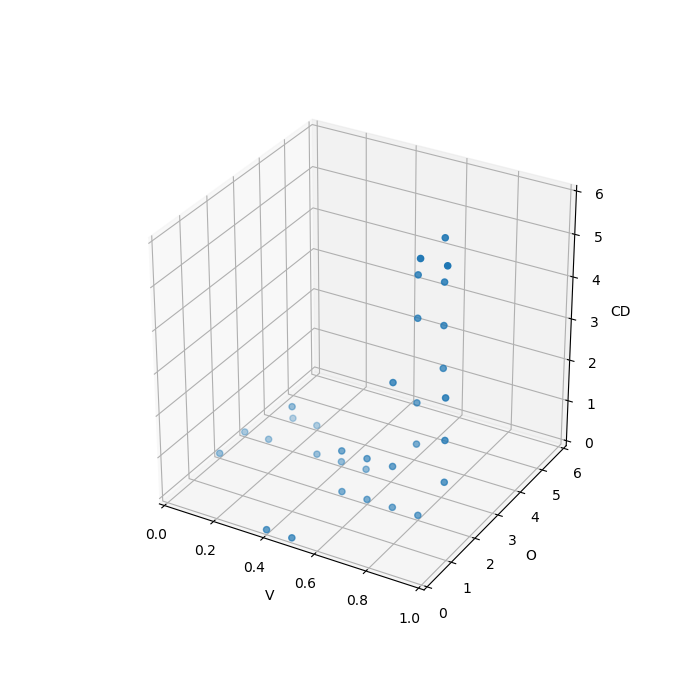

<IPython.core.display.Javascript object>


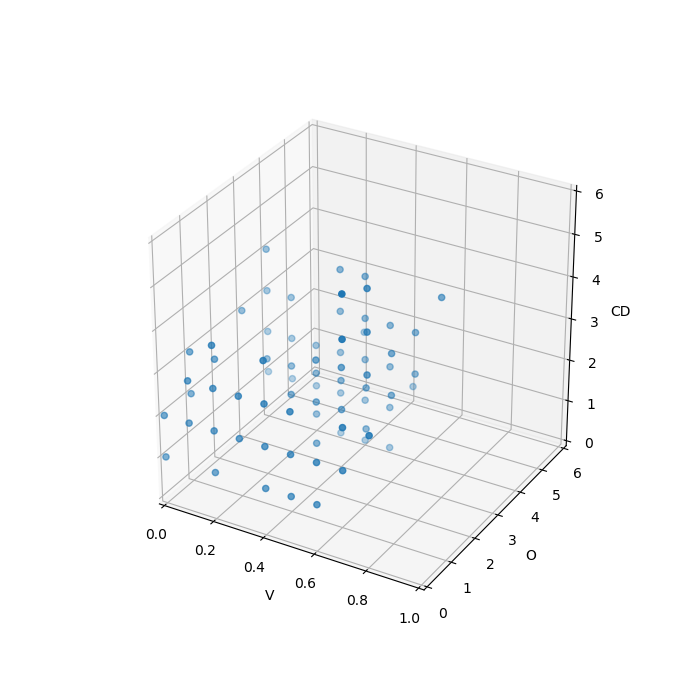

<IPython.core.display.Javascript object>


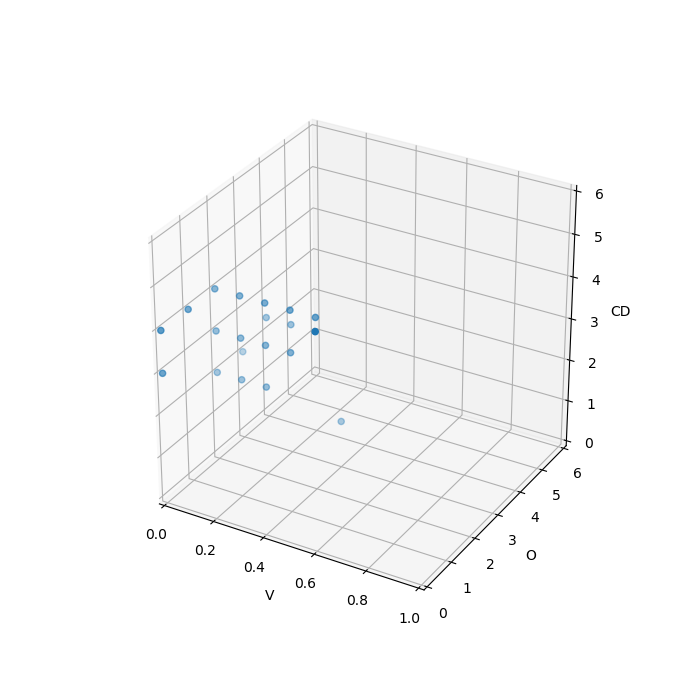

<IPython.core.display.Javascript object>


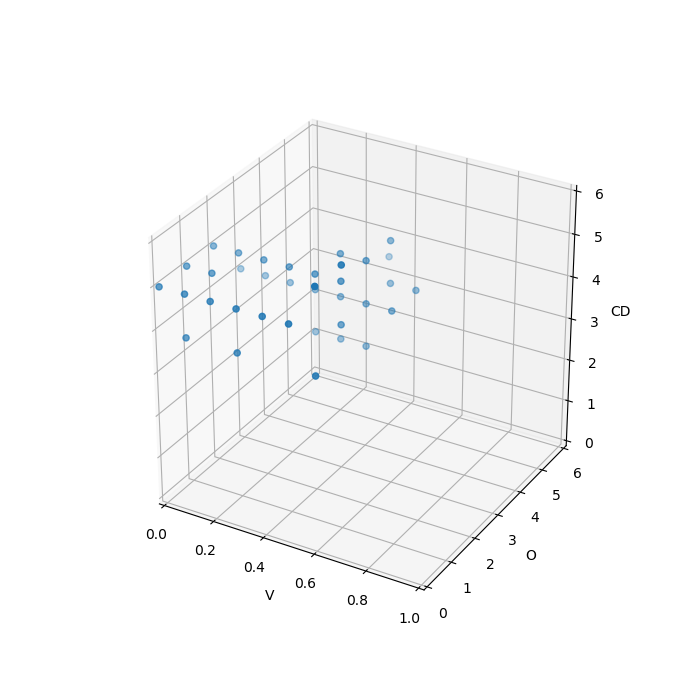

<IPython.core.display.Javascript object>


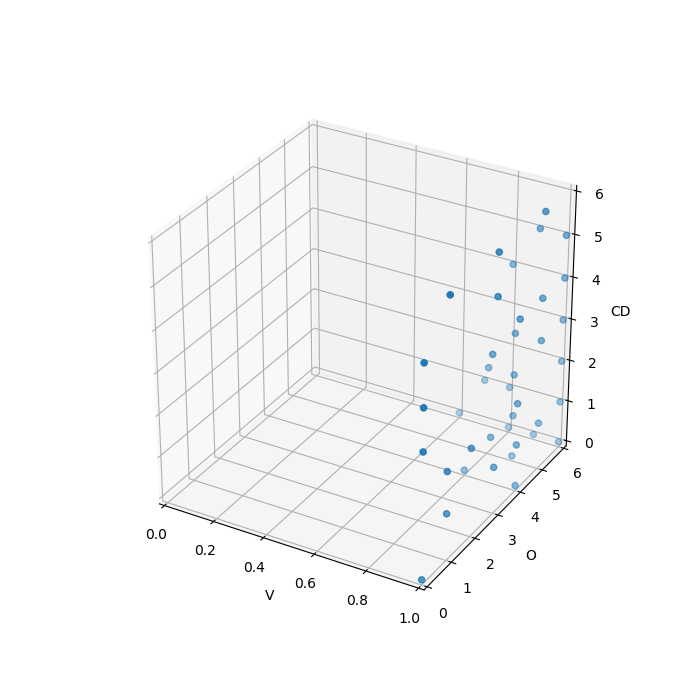

<IPython.core.display.Javascript object>


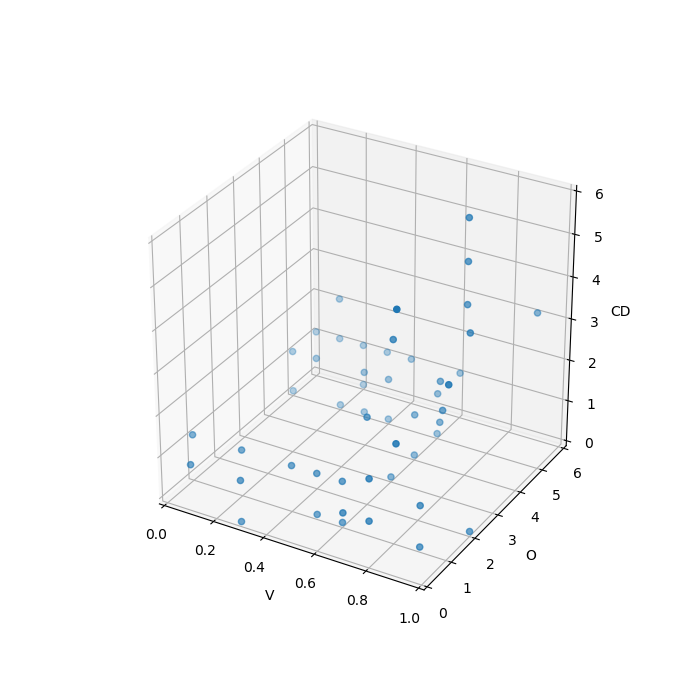

<IPython.core.display.Javascript object>


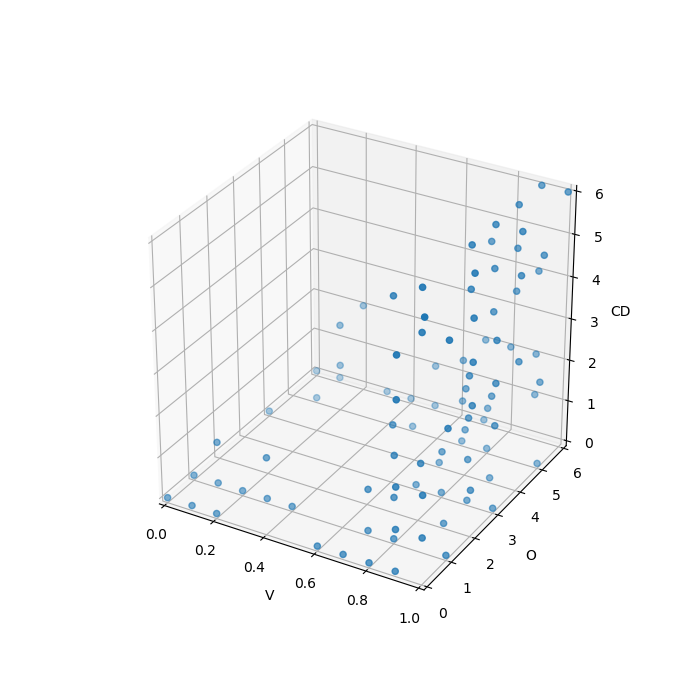

<IPython.core.display.Javascript object>


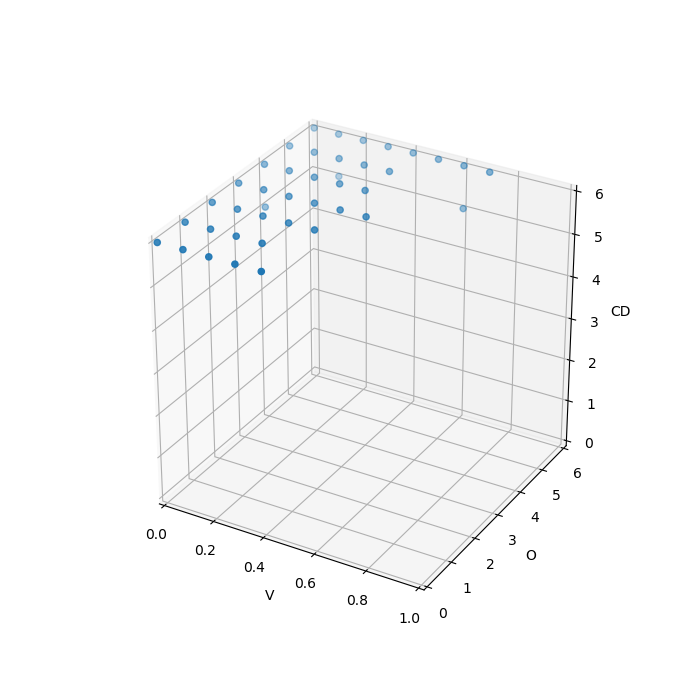

<IPython.core.display.Javascript object>


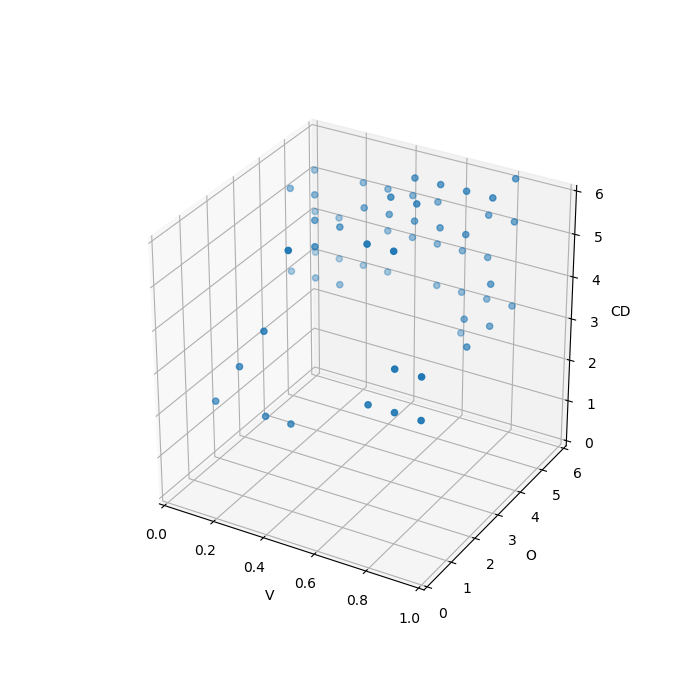

<IPython.core.display.Javascript object>


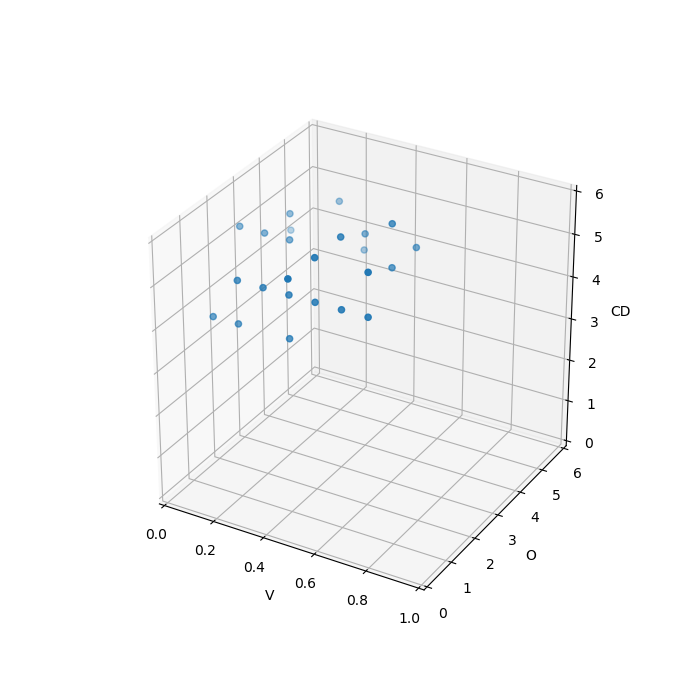

<IPython.core.display.Javascript object>


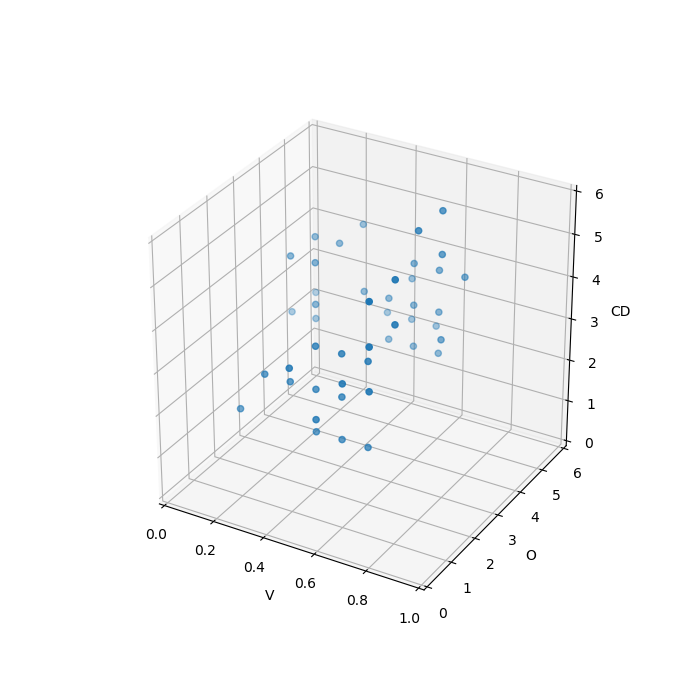

<IPython.core.display.Javascript object>


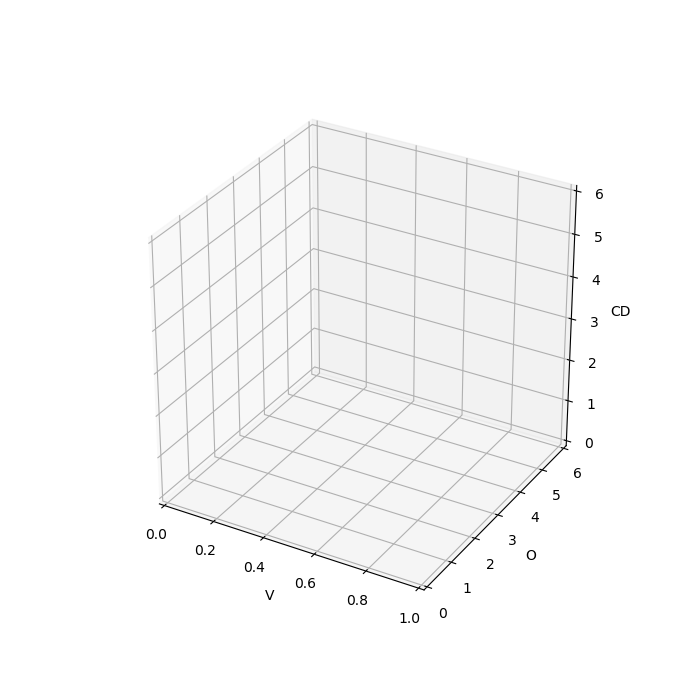

In [31]:
for i in range(nclusters + 1):
    puntos = np.zeros((len(corrxclus[i]), 3))
    aa = 0
    for j in corrxclus[i]:
        puntos[aa,0] = ternas[j-1,1]
        puntos[aa,1] = ternas[j-1,2]
        puntos[aa,2] = ternas[j-1,3]
        aa = aa + 1
    plt.figure('Ternas en cluster' + str(i), figsize=(7,7))
    ax = plt.axes(projection = '3d')
    ax.scatter(puntos[:,0], puntos[:,1], puntos[:,2])
    ax.set_xlabel('V')
    ax.set_ylabel('O')
    ax.set_zlabel('CD')
    ax.set_xlim(0,1)
    ax.set_ylim(0,6)
    ax.set_zlim(0,6)

<IPython.core.display.Javascript object>


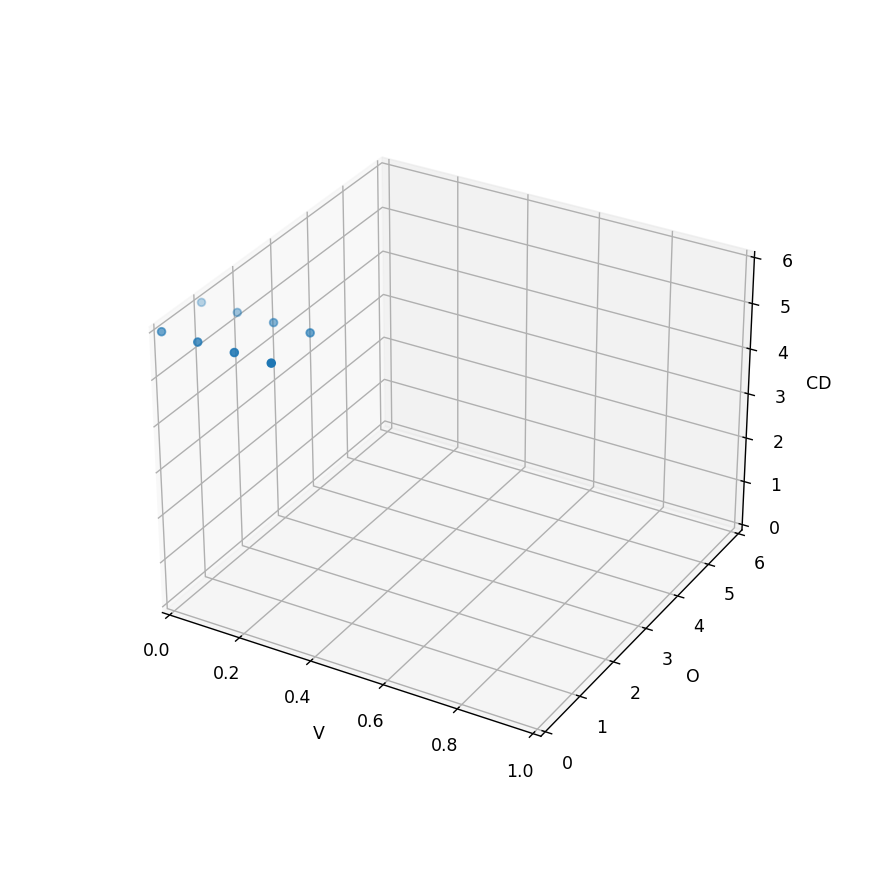

(0.0, 6.0)

In [131]:
%matplotlib notebook
i = 1
puntos = np.zeros((len(corrxclus[i]), 3))
aa = 0
for j in corrxclus[i]:
    puntos[aa,0] = ternas[j-1,1]
    puntos[aa,1] = ternas[j-1,2]
    puntos[aa,2] = ternas[j-1,3]
    aa = aa + 1
plt.figure('Ternas en cluster' + str(i), figsize=(7,7))
ax = plt.axes(projection = '3d')
ax.scatter(puntos[:,0], puntos[:,1], puntos[:,2])
ax.set_xlabel('V')
ax.set_ylabel('O')
ax.set_zlabel('CD')
ax.set_xlim(0,1)
ax.set_ylim(0,6)
ax.set_zlim(0,6)